In [137]:
import functools
import numpy as np
import matplotlib.pyplot as plt

from scipy import interpolate
from scipy.signal import find_peaks

In [3]:
X = np.load('X.npy', allow_pickle=True)

In [4]:
X

array([[1,
        array([[[ 9.52032107e+00,  1.81056380e-02, -2.50587912e+00,
                  3.29005250e-03, -1.01396062e-02,  9.99331377e-03],
                [ 9.61047401e+00,  1.28238513e-01, -2.14153011e+00,
                  2.02613126e-02,  2.21448667e-02, -8.38813869e-03],
                [ 9.45691465e+00, -4.61177302e-01, -2.15482869e+00,
                 -1.48330406e-02, -2.36393428e-03, -5.71936550e-03],
                [ 9.53007294e+00,  1.96690906e+00,  1.08336928e+00,
                 -1.17918250e-02, -1.35959435e-03, -1.12671694e-03],
                [ 9.73515181e+00, -1.62383530e+00, -1.19514839e+00,
                  2.10346219e-02, -3.04839160e-04,  4.77178494e-03]],

               [[ 9.50992919e+00,  1.69705177e-02, -2.49886690e+00,
                  3.43775977e-03, -1.54217645e-02,  8.43872223e-03],
                [ 9.59054753e+00,  1.06064347e-01, -2.14874623e+00,
                  9.55392403e-03,  2.23991815e-02, -6.68317182e-03],
                [ 9.48134732

In [5]:
X[0,1][:,3,0:3] # [whole trial,shankL,Acc_X-Acc_Z]

array([[  9.53007294,   1.96690906,   1.08336928],
       [  9.55325366,   1.94527756,   1.08443089],
       [  9.57394415,   1.92675104,   1.08601706],
       ...,
       [ 10.71956103,   4.11029536, -15.05946202],
       [  7.75006994,   3.06297389, -16.61193452],
       [  4.80616281,   1.88104548, -18.09768999]])

In [6]:
magn = lambda arr: np.sqrt(np.sum(np.square(arr)))

In [7]:
magn_trial = np.apply_along_axis(magn, 1,X[0,1][:,3,0:3])

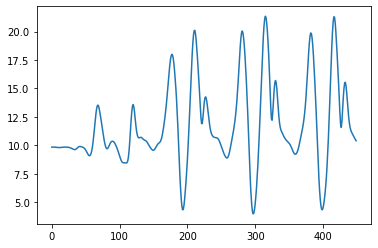

In [14]:
plt.plot(magn_trial[50:500])

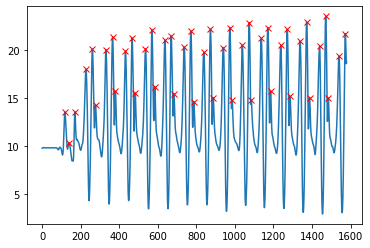

In [32]:
peaks, _ = find_peaks(magn_trial, prominence=0.4)
plt.plot(magn_trial);plt.plot(peaks, magn_trial[peaks], "xr")
plt.show()

In [56]:
max_peak = max(magn_trial[peaks])
threshold = 5
selected_peaks = []
for x in peaks:
    if magn_trial[x]>max_peak-threshold:
        selected_peaks.append(x)

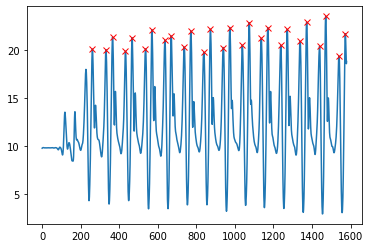

In [57]:
plt.plot(magn_trial);plt.plot(selected_peaks, magn_trial[selected_peaks], "xr")
plt.show()

In [251]:
# arr: trial of magn of shank ACC
# events: idx of peaks of arr (only looking for pairs of peaks)
def gen_gait_cycle_events(arr, events, viz=False):
    gait_cycles_ev=[] # arr of tuples(len:2) denoting beginning and end of gait cycles
    last_g_ev=(0,0)
    for i in range(0,len(events)):
#         if i+1 < len(events) and arr[events[i]] >= arr[events[i+1]]:
#             sub_slice = arr[events[i]:events[i+1]]
#             g_ev, _ = find_peaks(sub_slice, prominence=0.4)
            
#             if viz:
#                 print('Subslice '+str(i)+':'+str(events[i])+' with peaks')
#                 plt.plot(sub_slice);plt.plot(g_ev, sub_slice[g_ev], "xr")
#                 plt.show()
            
#             if len(g_ev)==1:
#                 g_ev=events[i]+g_ev[0]
                
#                 if last_g_ev!=0:
#                     gait_cycles_ev.append((last_g_ev,g_ev))
#                 last_g_ev = g_ev

        if (i-1>=0 and i+1 < len(events) and 
            (arr[events[i]] < arr[events[i+1]] and 
             arr[events[i]] < arr[events[i-1]] and
             arr[events[i-1]] >= arr[events[i+1]]
            )):
            g_ev = events[i]
            if last_g_ev!=(0,0) and i-last_g_ev[0]==3:
                gait_cycles_ev.append((last_g_ev[1],g_ev))
            last_g_ev = (i,g_ev)
                                        
    return gait_cycles_ev

In [252]:
g_events = gen_gait_cycle_events(magn_trial, peaks)

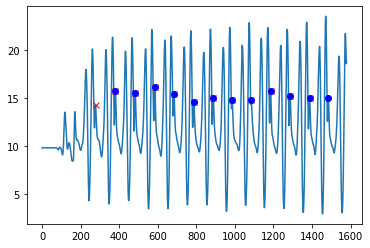

In [253]:
plt.plot(magn_trial)
plt.plot([x[0] for x in g_events], magn_trial[[x[0] for x in g_events]], "xr")
plt.plot([x[1] for x in g_events], magn_trial[[x[1] for x in g_events]], "ob")
plt.show()

In [254]:
def gen_gait_cycles(trial, viz=False):
    magn_trial = np.apply_along_axis(magn, 1,trial[:,3,0:3]) # get [full length of trial,shankL,Acc_X:Acc_Z]
    peaks, _ = find_peaks(magn_trial, prominence=0.4)
    
    if viz:
        print('ACC Magn Trial with peaks')
        plt.plot(magn_trial);plt.plot(peaks, magn_trial[peaks], "xr")
        plt.show()
    
#     max_peak = max(magn_trial[peaks])
#     threshold = 5
#     selected_peaks = []
#     for x in peaks:
#         if magn_trial[x]>max_peak-threshold:
#             selected_peaks.append(x)
            
#     if viz:
#         print('ACC Magn Trial with threshold selected peaks')
#         plt.plot(magn_trial);plt.plot(selected_peaks, magn_trial[selected_peaks], "xr")
#         plt.show()
            
#     g_events = gen_gait_cycle_events(magn_trial, selected_peaks)
    g_events = gen_gait_cycle_events(magn_trial, peaks)
    
    if viz:
        print('ACC Magn Trial with gait cycle')
        plt.plot(magn_trial)
        plt.plot([x[0] for x in g_events], magn_trial[[x[0] for x in g_events]], "xr")
        plt.plot([x[1] for x in g_events], magn_trial[[x[1] for x in g_events]], "ob")
        plt.show()
    
    return g_events #array of tuple of gait cycle event idx (begin,end)

In [255]:
def normalized_gait(A):
    x=np.arange(A.shape[-1])
    A=np.where(np.isnan(A)==1,0,A)
    Y= interpolate.interp1d(x,A, kind='cubic')(np.linspace(x.min(), x.max(), 101))
    return Y

In [263]:
# entry: entry from retrieved dataset; shape: (patientNum, feature_trial, label)
# out: array of entry with gait cycles for trials
#    ; shape: [(patientNum, feature_gait_cycle_1, label), ... , (patientNum, feature_gait_cycle_N, label)]
def trial2gcycles(entry,viz=False,i=None):
    if i is not None:
        print('tria2gcycles for i:'+str(i))
    gc_entries = []
    
    g_events = gen_gait_cycles(entry[1],viz)
    
    for b_i, e_i in g_events:
        new_entry = np.copy(entry)
        un_norm_gc = entry[1][b_i:e_i,:,:] # replace trial with normalized gait cycle
        
        norm_gc = np.apply_along_axis(normalized_gait, 0,un_norm_gc) # (101,5,6)
        
        new_entry[1] = norm_gc
        gc_entries.append(new_entry)
    
    return gc_entries

In [134]:
trial2gcycles(X[0])

[array([1, array([[[13.07590072,  0.13848483, -2.59982706,  0.30202857,
                    -0.49434425, -0.22787985],
                   [11.60732373,  0.62952383,  0.0710532 , -0.61818432,
                     0.02236853, -0.51675312],
                   [15.35539899, -1.43079434,  2.52858909, -0.1128092 ,
                     1.80718344, -0.60422999],
                   [13.9708676 ,  2.75272607, -0.74890631, -0.37115025,
                    -3.0392016 , -1.14365847],
                   [19.61296962, -4.20504531,  0.92071824, -2.41629238,
                    -2.77494427, -2.28930696]],
 
                  [[12.98217873,  0.30268443, -2.12634067,  0.31370671,
                    -0.41774686, -0.24342407],
                   [11.01146937,  1.46182644, -1.05263283, -0.72783642,
                    -0.15139044, -0.54174184],
                   [15.41971323, -1.0387894 ,  2.1772558 ,  0.10974787,
                     2.32756117, -0.59902767],
                   [13.70687789,  3.03488216,

In [135]:
[t[1].shape for t in trial2gcycles(X[0])]

[(101, 5, 6),
 (101, 5, 6),
 (101, 5, 6),
 (101, 5, 6),
 (101, 5, 6),
 (101, 5, 6),
 (101, 5, 6),
 (101, 5, 6),
 (101, 5, 6),
 (101, 5, 6),
 (101, 5, 6),
 (101, 5, 6)]

In [160]:
len(X)

1620

ACC Magn Trial with peaks


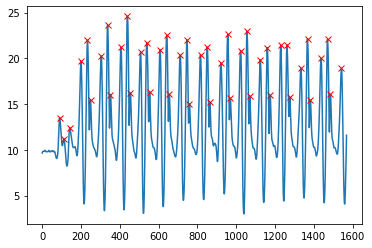

ACC Magn Trial with gait cycle


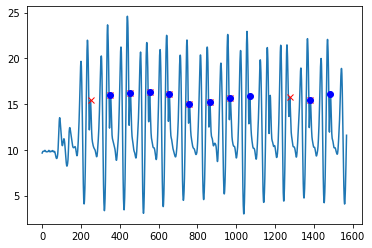

10

In [259]:
len(trial2gcycles(X[4],viz=True))

tria2gcycles for i:0
ACC Magn Trial with peaks


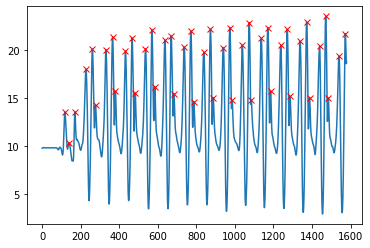

ACC Magn Trial with gait cycle


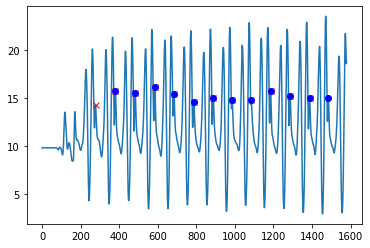

tria2gcycles for i:1
ACC Magn Trial with peaks


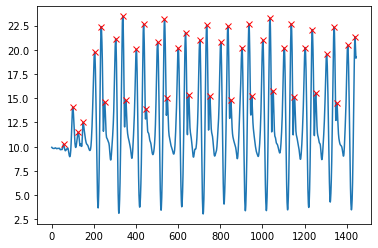

ACC Magn Trial with gait cycle


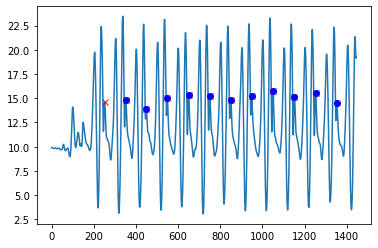

tria2gcycles for i:2
ACC Magn Trial with peaks


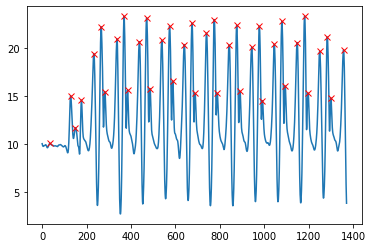

ACC Magn Trial with gait cycle


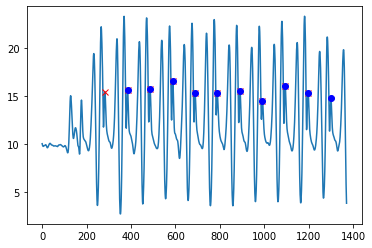

tria2gcycles for i:3
ACC Magn Trial with peaks


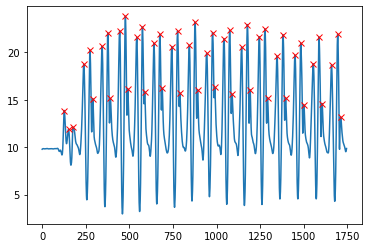

ACC Magn Trial with gait cycle


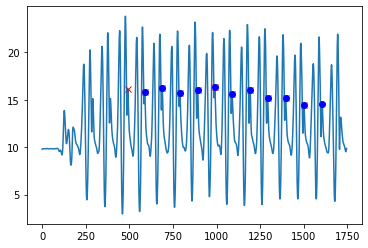

tria2gcycles for i:4
ACC Magn Trial with peaks


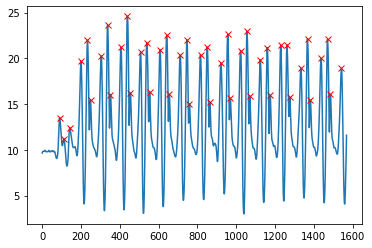

ACC Magn Trial with gait cycle


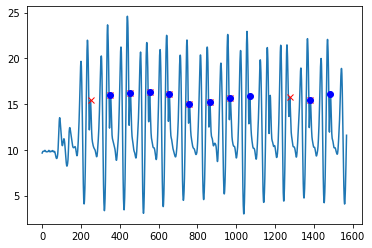

tria2gcycles for i:5
ACC Magn Trial with peaks


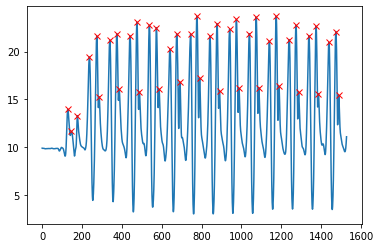

ACC Magn Trial with gait cycle


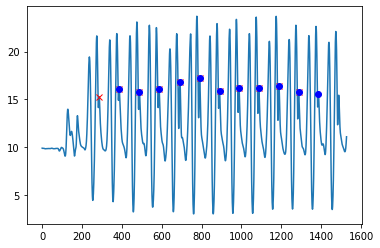

tria2gcycles for i:6
ACC Magn Trial with peaks


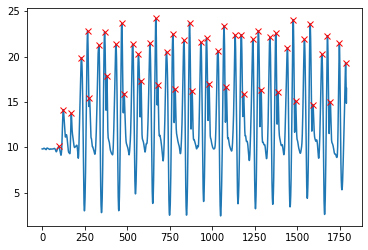

ACC Magn Trial with gait cycle


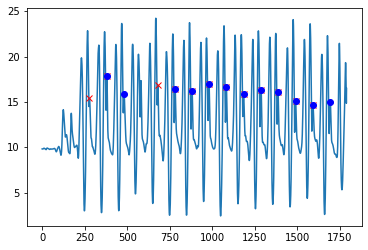

tria2gcycles for i:7
ACC Magn Trial with peaks


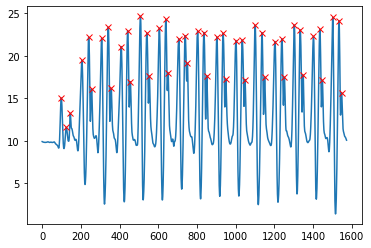

ACC Magn Trial with gait cycle


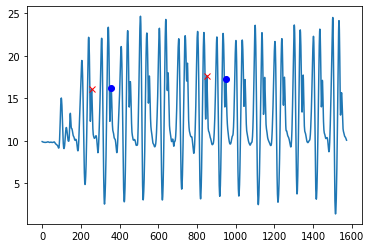

tria2gcycles for i:8
ACC Magn Trial with peaks


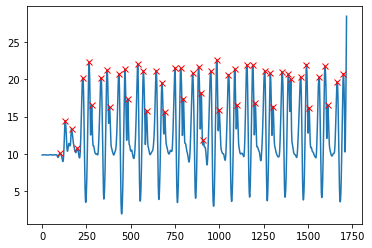

ACC Magn Trial with gait cycle


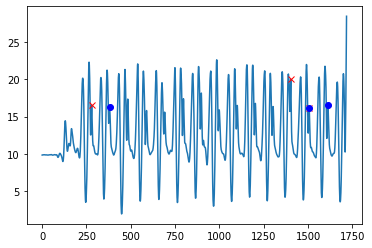

tria2gcycles for i:9
ACC Magn Trial with peaks


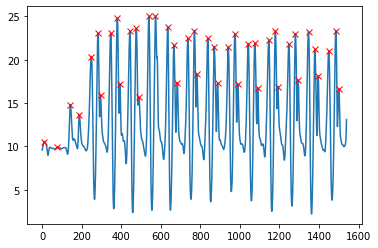

ACC Magn Trial with gait cycle


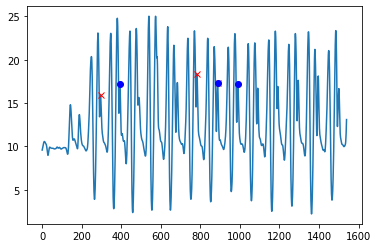

tria2gcycles for i:10
ACC Magn Trial with peaks


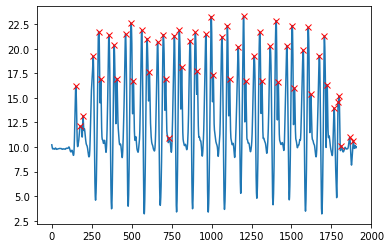

ACC Magn Trial with gait cycle


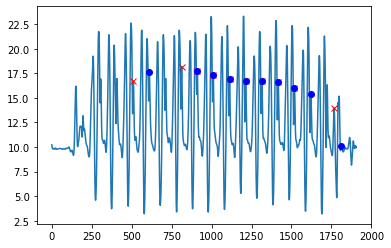

tria2gcycles for i:11
ACC Magn Trial with peaks


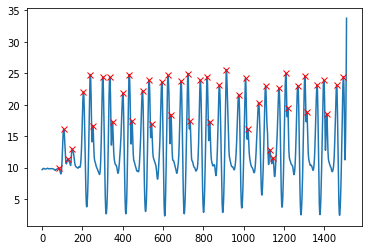

ACC Magn Trial with gait cycle


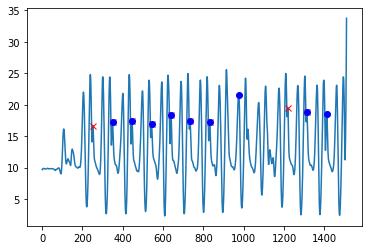

tria2gcycles for i:12
ACC Magn Trial with peaks


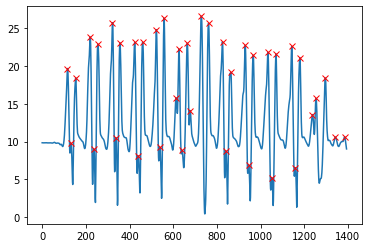

ACC Magn Trial with gait cycle


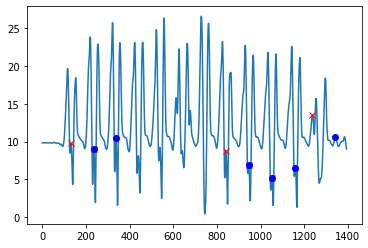

tria2gcycles for i:13
ACC Magn Trial with peaks


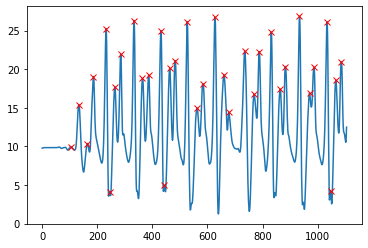

ACC Magn Trial with gait cycle


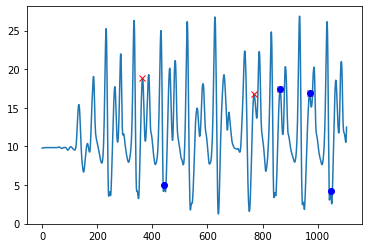

tria2gcycles for i:14
ACC Magn Trial with peaks


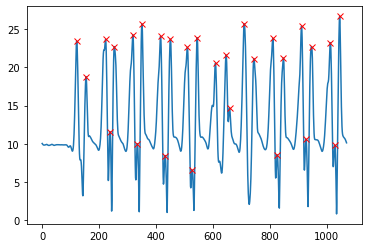

ACC Magn Trial with gait cycle


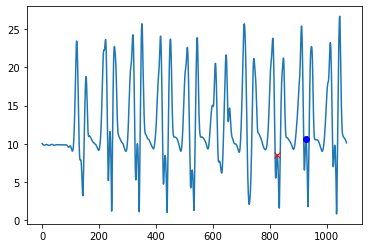

tria2gcycles for i:15
ACC Magn Trial with peaks


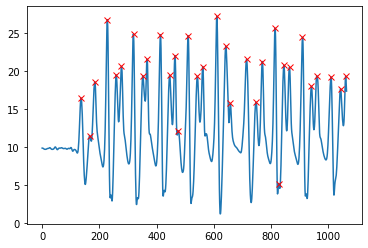

ACC Magn Trial with gait cycle


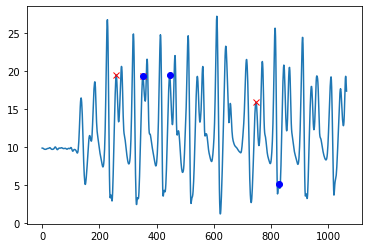

tria2gcycles for i:16
ACC Magn Trial with peaks


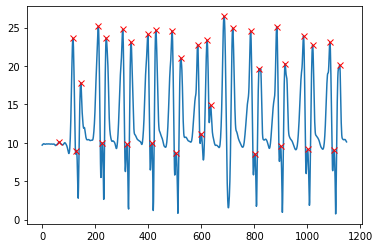

ACC Magn Trial with gait cycle


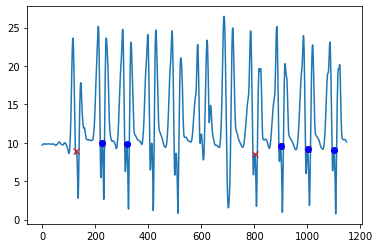

tria2gcycles for i:17
ACC Magn Trial with peaks


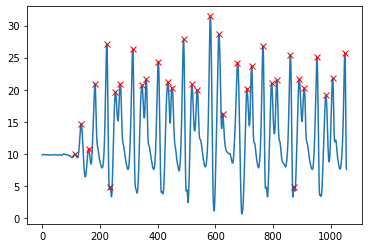

ACC Magn Trial with gait cycle


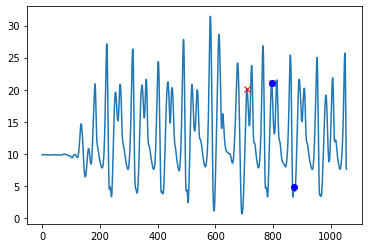

tria2gcycles for i:18
ACC Magn Trial with peaks


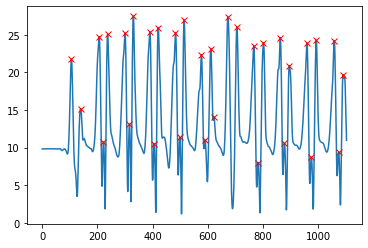

ACC Magn Trial with gait cycle


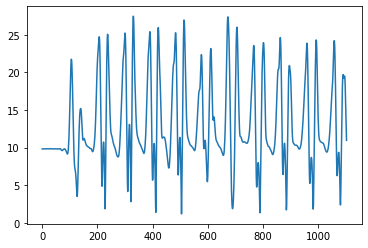

tria2gcycles for i:19
ACC Magn Trial with peaks


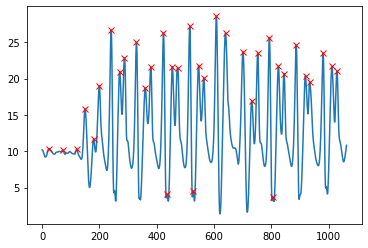

ACC Magn Trial with gait cycle


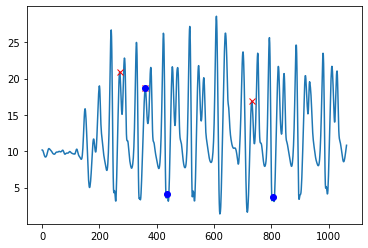

tria2gcycles for i:20
ACC Magn Trial with peaks


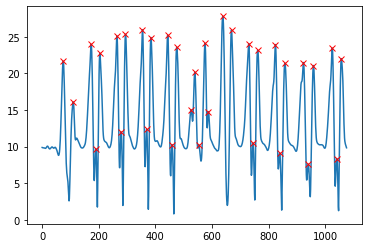

ACC Magn Trial with gait cycle


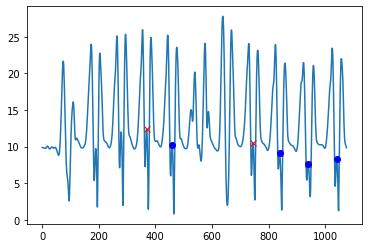

tria2gcycles for i:21
ACC Magn Trial with peaks


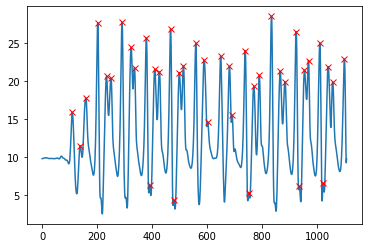

ACC Magn Trial with gait cycle


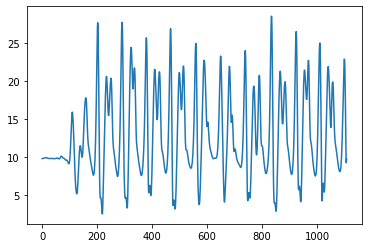

tria2gcycles for i:22
ACC Magn Trial with peaks


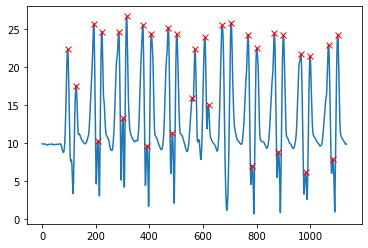

ACC Magn Trial with gait cycle


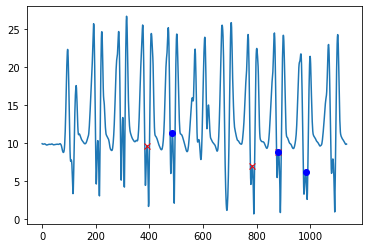

tria2gcycles for i:23
ACC Magn Trial with peaks


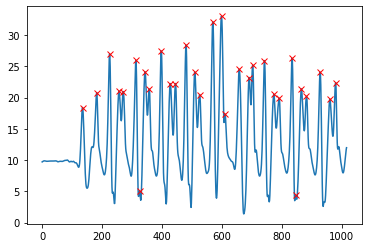

ACC Magn Trial with gait cycle


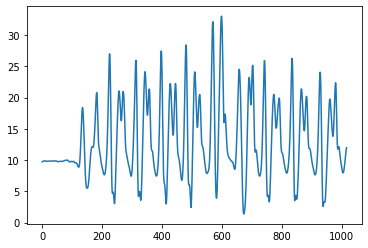

tria2gcycles for i:24
ACC Magn Trial with peaks


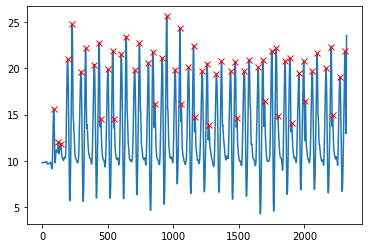

ACC Magn Trial with gait cycle


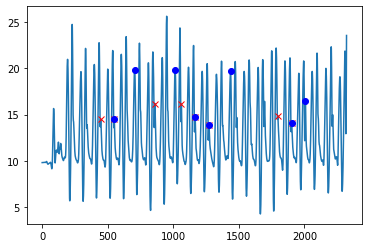

tria2gcycles for i:25
ACC Magn Trial with peaks


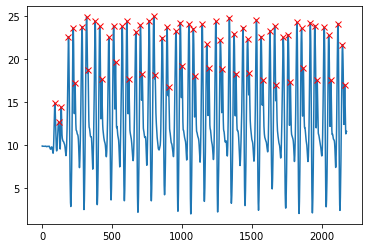

ACC Magn Trial with gait cycle


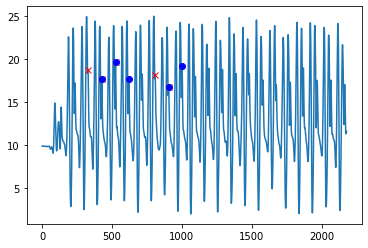

tria2gcycles for i:26
ACC Magn Trial with peaks


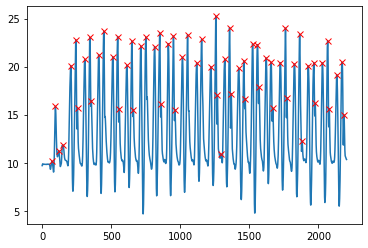

ACC Magn Trial with gait cycle


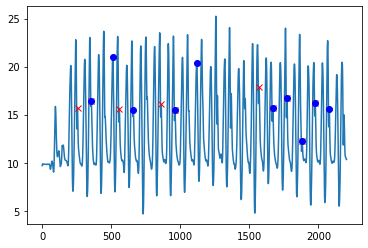

tria2gcycles for i:27
ACC Magn Trial with peaks


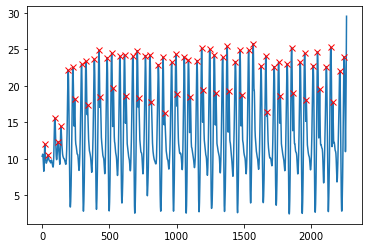

ACC Magn Trial with gait cycle


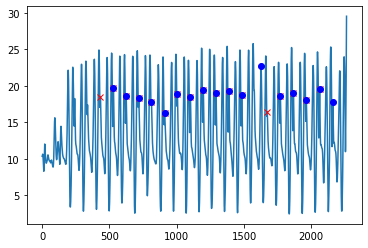

tria2gcycles for i:28
ACC Magn Trial with peaks


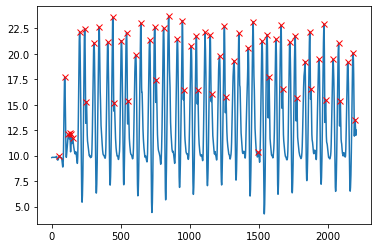

ACC Magn Trial with gait cycle


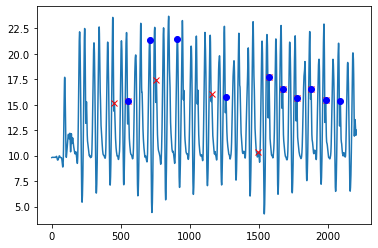

tria2gcycles for i:29
ACC Magn Trial with peaks


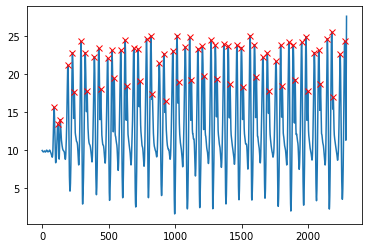

ACC Magn Trial with gait cycle


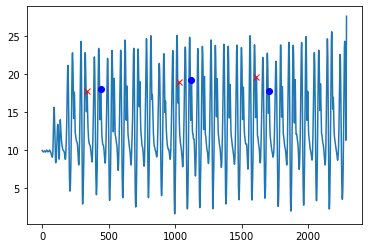

tria2gcycles for i:30
ACC Magn Trial with peaks


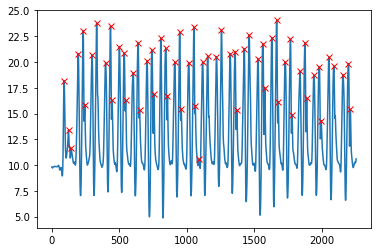

ACC Magn Trial with gait cycle


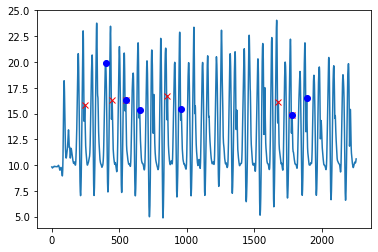

tria2gcycles for i:31
ACC Magn Trial with peaks


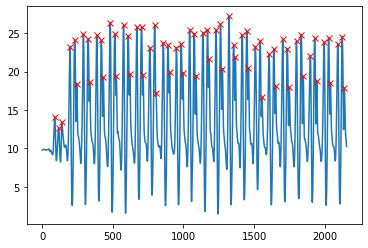

ACC Magn Trial with gait cycle


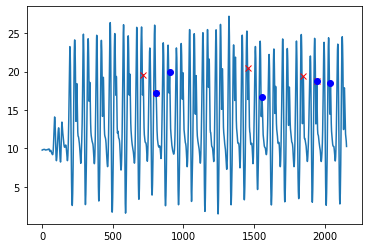

tria2gcycles for i:32
ACC Magn Trial with peaks


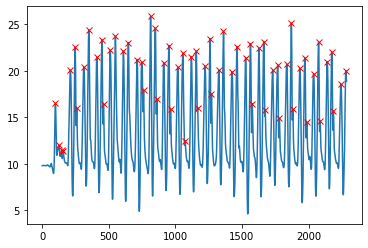

ACC Magn Trial with gait cycle


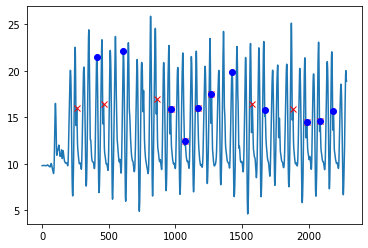

tria2gcycles for i:33
ACC Magn Trial with peaks


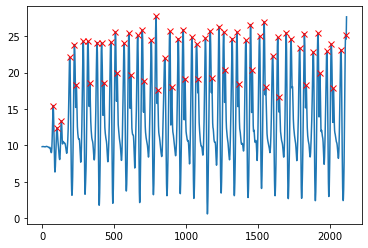

ACC Magn Trial with gait cycle


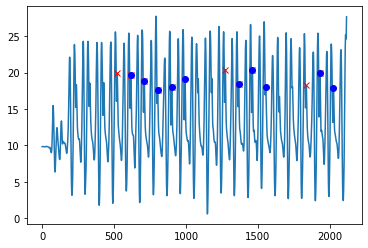

tria2gcycles for i:34
ACC Magn Trial with peaks


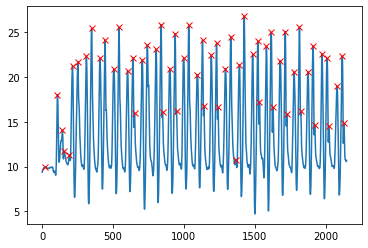

ACC Magn Trial with gait cycle


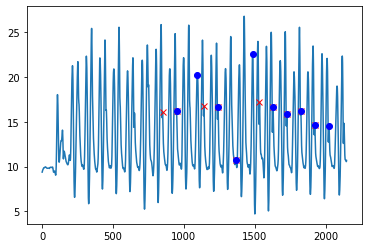

tria2gcycles for i:35
ACC Magn Trial with peaks


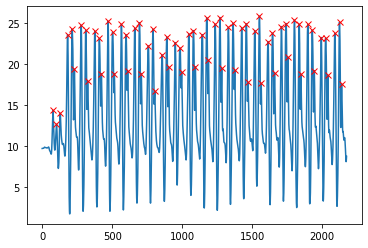

ACC Magn Trial with gait cycle


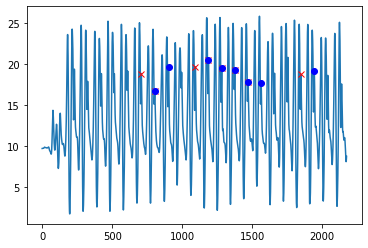

tria2gcycles for i:36
ACC Magn Trial with peaks


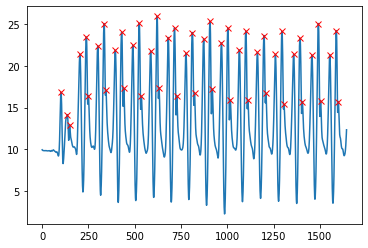

ACC Magn Trial with gait cycle


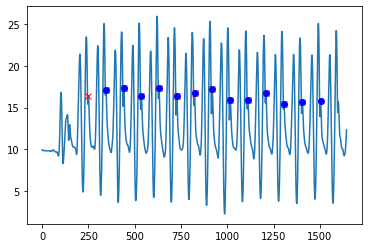

tria2gcycles for i:37
ACC Magn Trial with peaks


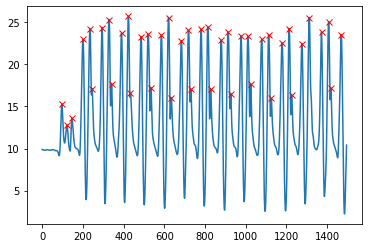

ACC Magn Trial with gait cycle


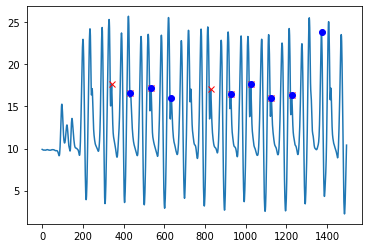

tria2gcycles for i:38
ACC Magn Trial with peaks


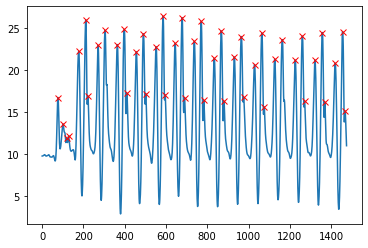

ACC Magn Trial with gait cycle


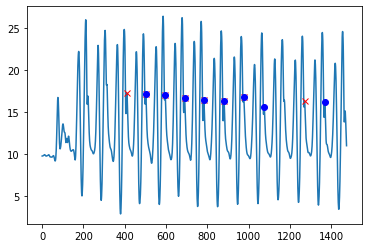

tria2gcycles for i:39
ACC Magn Trial with peaks


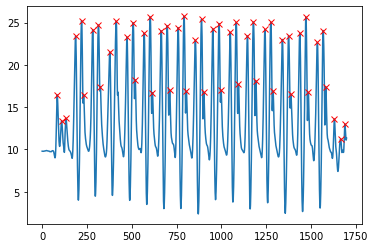

ACC Magn Trial with gait cycle


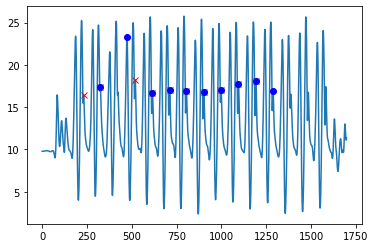

tria2gcycles for i:40
ACC Magn Trial with peaks


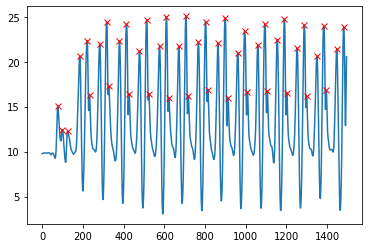

ACC Magn Trial with gait cycle


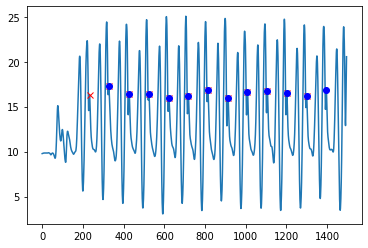

tria2gcycles for i:41
ACC Magn Trial with peaks


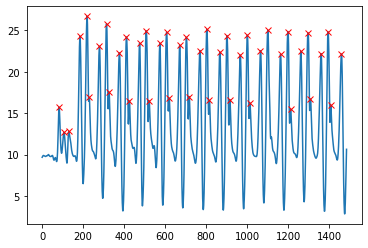

ACC Magn Trial with gait cycle


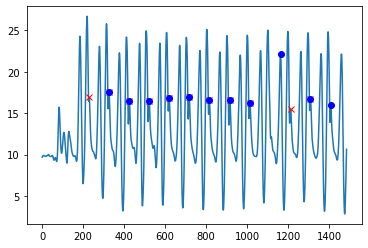

tria2gcycles for i:42
ACC Magn Trial with peaks


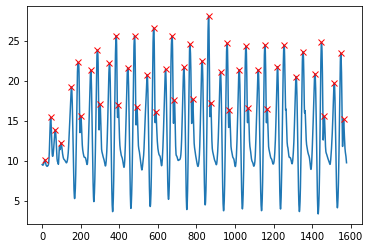

ACC Magn Trial with gait cycle


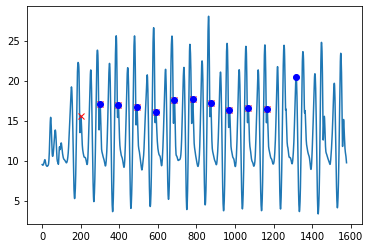

tria2gcycles for i:43
ACC Magn Trial with peaks


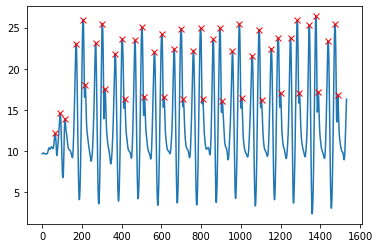

ACC Magn Trial with gait cycle


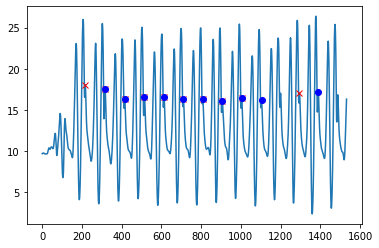

tria2gcycles for i:44
ACC Magn Trial with peaks


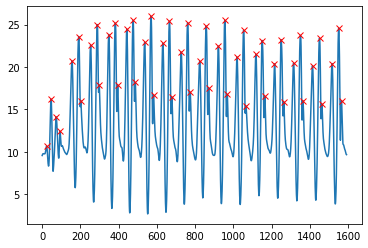

ACC Magn Trial with gait cycle


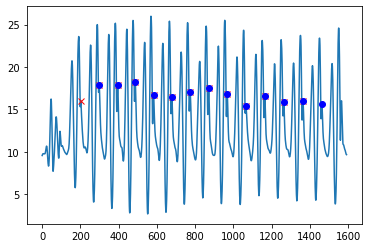

tria2gcycles for i:45
ACC Magn Trial with peaks


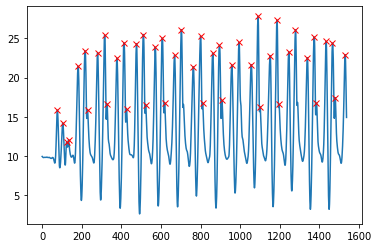

ACC Magn Trial with gait cycle


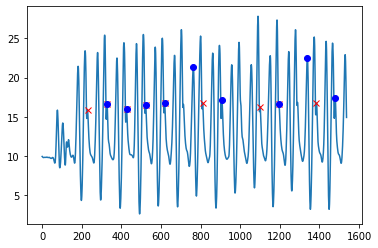

tria2gcycles for i:46
ACC Magn Trial with peaks


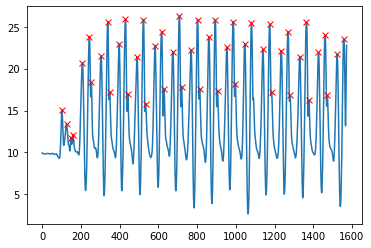

ACC Magn Trial with gait cycle


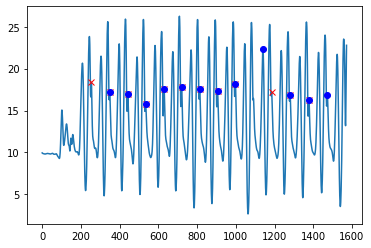

tria2gcycles for i:47
ACC Magn Trial with peaks


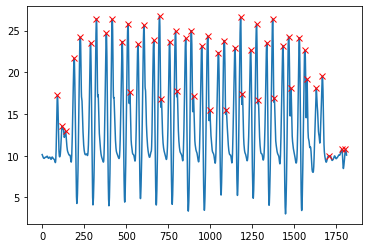

ACC Magn Trial with gait cycle


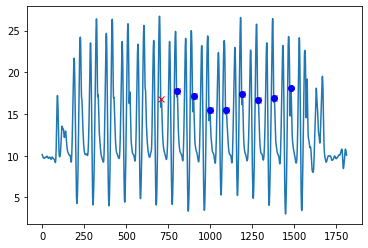

tria2gcycles for i:48
ACC Magn Trial with peaks


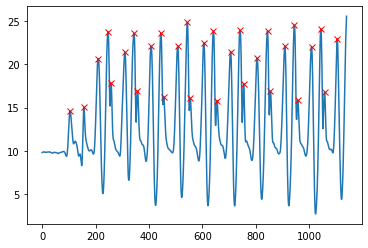

ACC Magn Trial with gait cycle


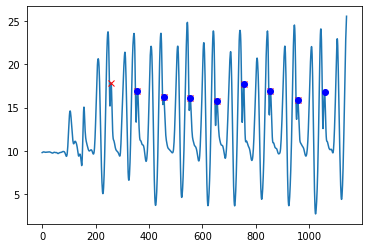

tria2gcycles for i:49
ACC Magn Trial with peaks


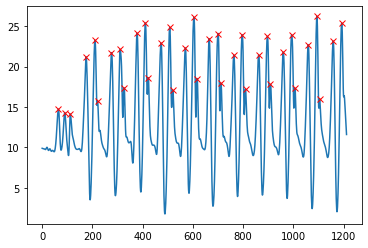

ACC Magn Trial with gait cycle


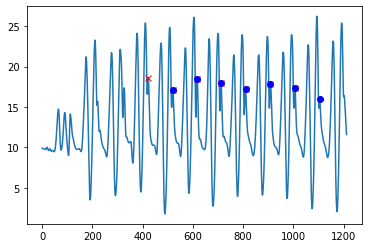

tria2gcycles for i:50
ACC Magn Trial with peaks


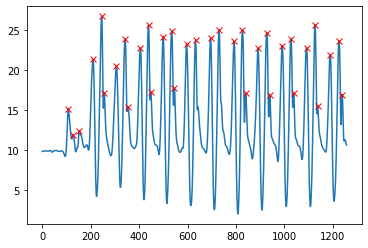

ACC Magn Trial with gait cycle


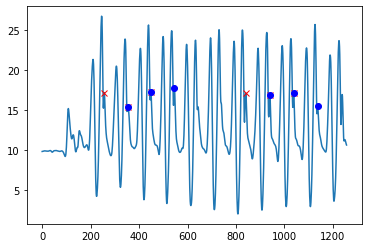

tria2gcycles for i:51
ACC Magn Trial with peaks


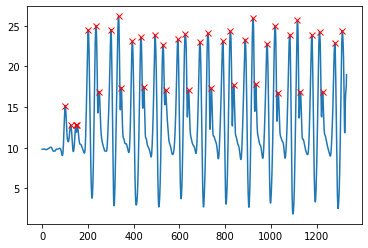

ACC Magn Trial with gait cycle


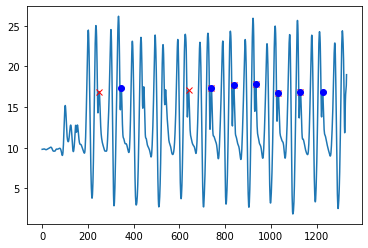

tria2gcycles for i:52
ACC Magn Trial with peaks


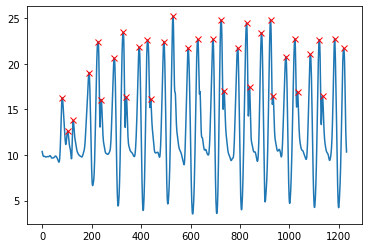

ACC Magn Trial with gait cycle


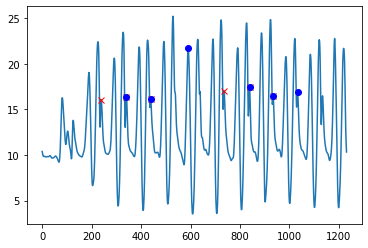

tria2gcycles for i:53
ACC Magn Trial with peaks


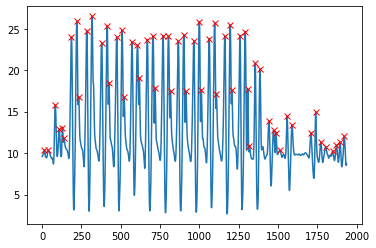

ACC Magn Trial with gait cycle


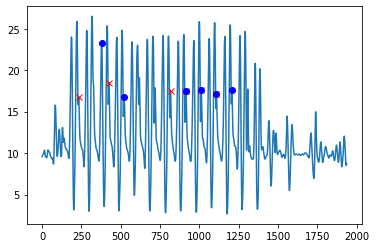

tria2gcycles for i:54
ACC Magn Trial with peaks


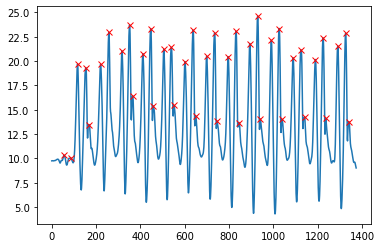

ACC Magn Trial with gait cycle


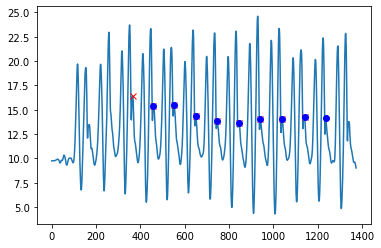

tria2gcycles for i:55
ACC Magn Trial with peaks


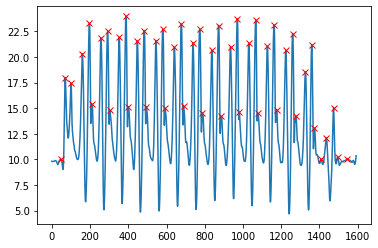

ACC Magn Trial with gait cycle


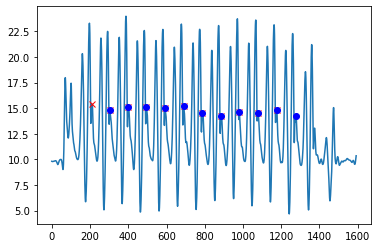

tria2gcycles for i:56
ACC Magn Trial with peaks


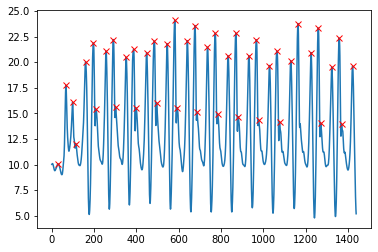

ACC Magn Trial with gait cycle


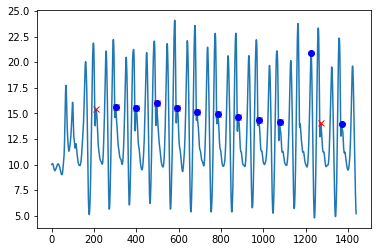

tria2gcycles for i:57
ACC Magn Trial with peaks


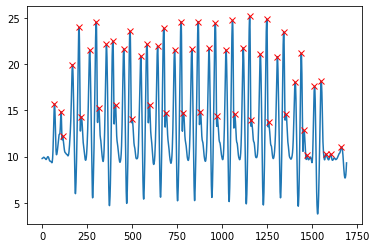

ACC Magn Trial with gait cycle


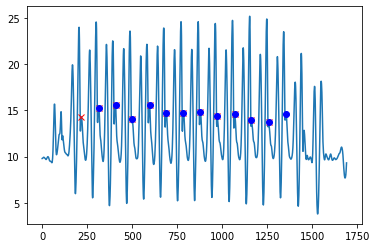

tria2gcycles for i:58
ACC Magn Trial with peaks


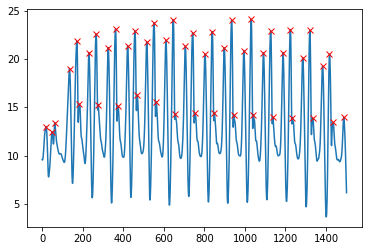

ACC Magn Trial with gait cycle


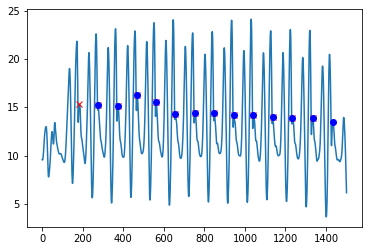

tria2gcycles for i:59
ACC Magn Trial with peaks


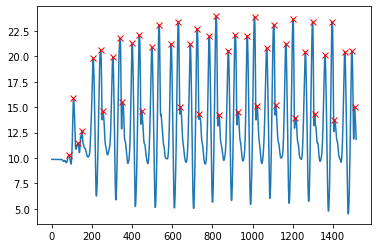

ACC Magn Trial with gait cycle


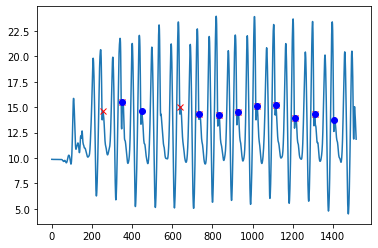

tria2gcycles for i:60
ACC Magn Trial with peaks


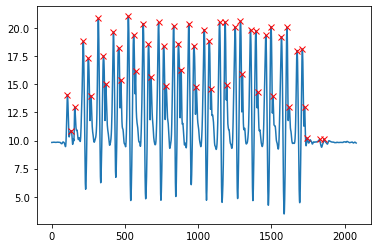

ACC Magn Trial with gait cycle


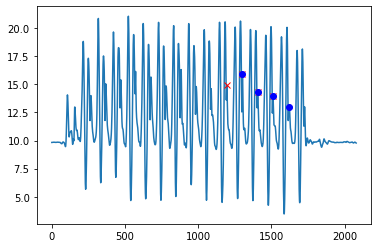

tria2gcycles for i:61
ACC Magn Trial with peaks


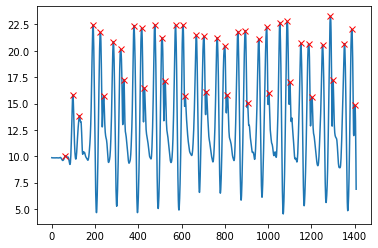

ACC Magn Trial with gait cycle


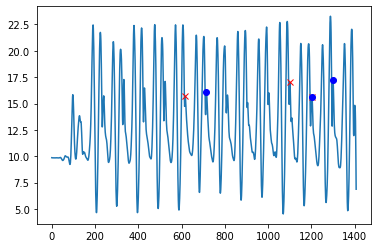

tria2gcycles for i:62
ACC Magn Trial with peaks


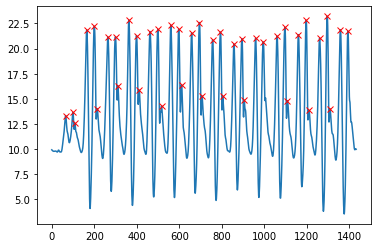

ACC Magn Trial with gait cycle


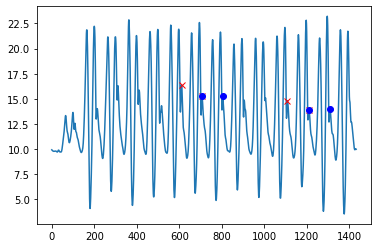

tria2gcycles for i:63
ACC Magn Trial with peaks


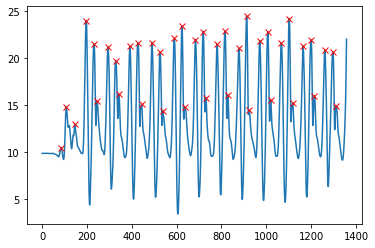

ACC Magn Trial with gait cycle


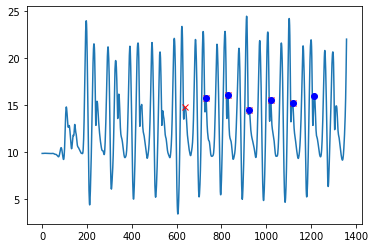

tria2gcycles for i:64
ACC Magn Trial with peaks


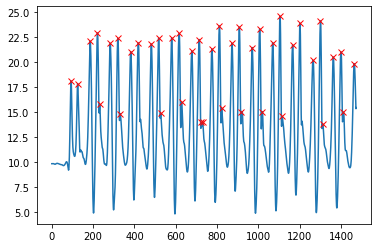

ACC Magn Trial with gait cycle


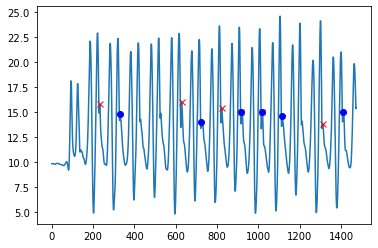

tria2gcycles for i:65
ACC Magn Trial with peaks


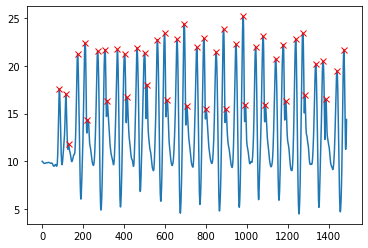

ACC Magn Trial with gait cycle


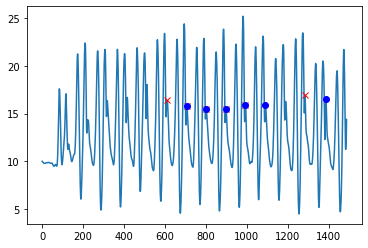

tria2gcycles for i:66
ACC Magn Trial with peaks


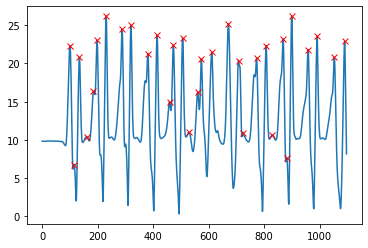

ACC Magn Trial with gait cycle


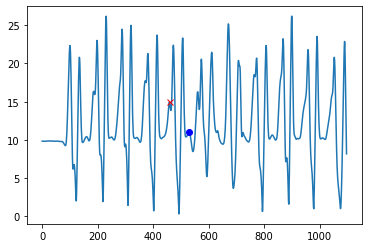

tria2gcycles for i:67
ACC Magn Trial with peaks


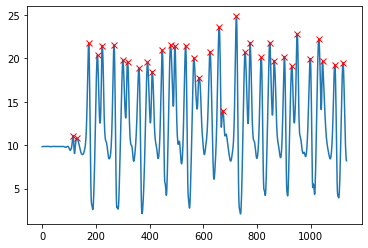

ACC Magn Trial with gait cycle


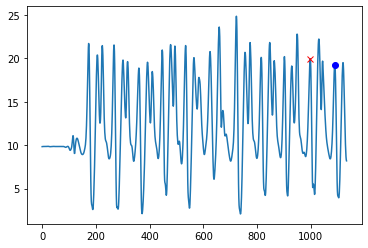

tria2gcycles for i:68
ACC Magn Trial with peaks


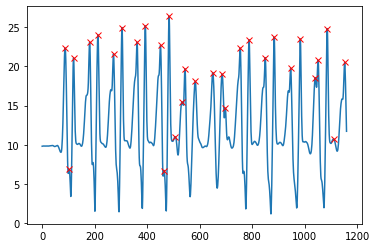

ACC Magn Trial with gait cycle


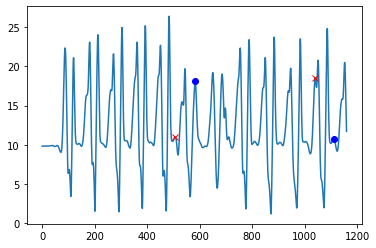

tria2gcycles for i:69
ACC Magn Trial with peaks


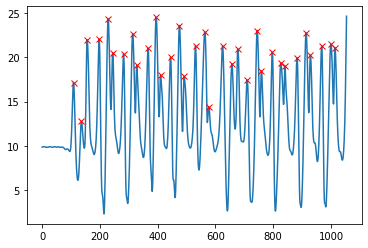

ACC Magn Trial with gait cycle


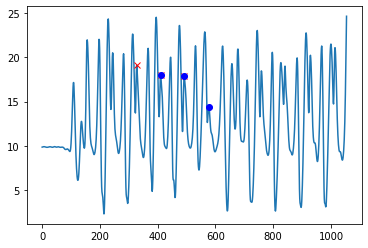

tria2gcycles for i:70
ACC Magn Trial with peaks


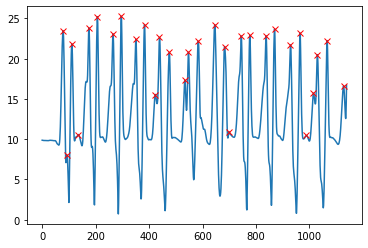

ACC Magn Trial with gait cycle


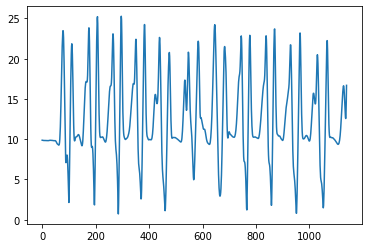

tria2gcycles for i:71
ACC Magn Trial with peaks


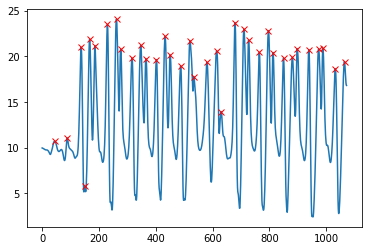

ACC Magn Trial with gait cycle


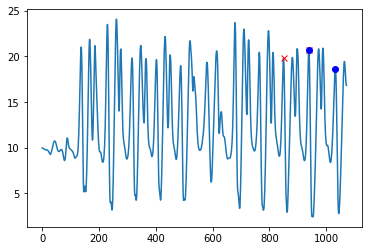

tria2gcycles for i:72
ACC Magn Trial with peaks


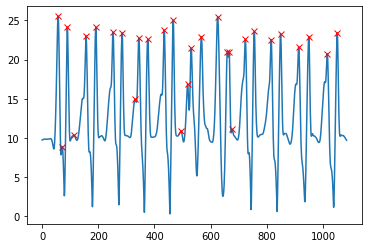

ACC Magn Trial with gait cycle


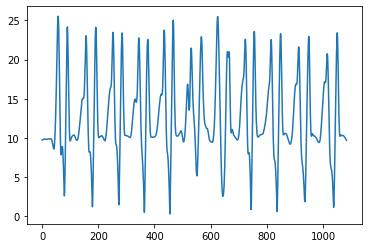

tria2gcycles for i:73
ACC Magn Trial with peaks


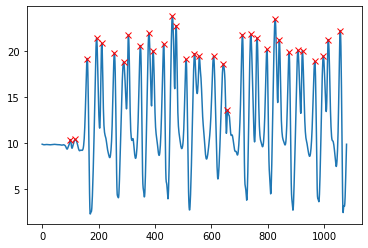

ACC Magn Trial with gait cycle


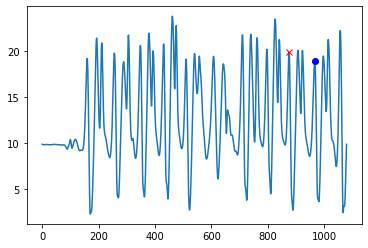

tria2gcycles for i:74
ACC Magn Trial with peaks


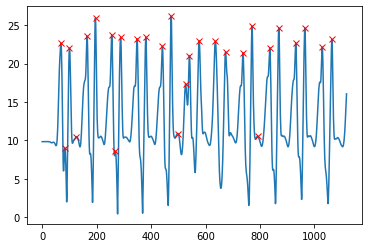

ACC Magn Trial with gait cycle


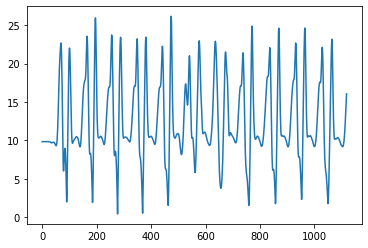

tria2gcycles for i:75
ACC Magn Trial with peaks


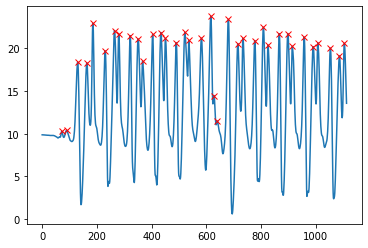

ACC Magn Trial with gait cycle


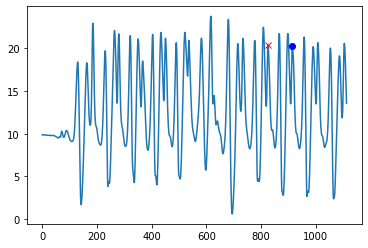

tria2gcycles for i:76
ACC Magn Trial with peaks


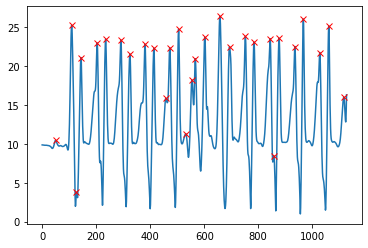

ACC Magn Trial with gait cycle


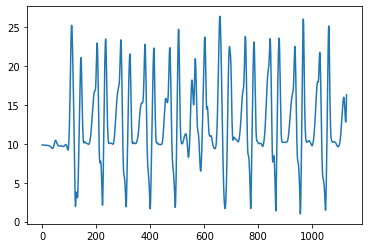

tria2gcycles for i:77
ACC Magn Trial with peaks


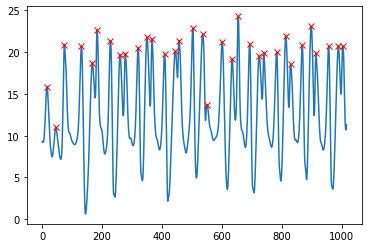

ACC Magn Trial with gait cycle


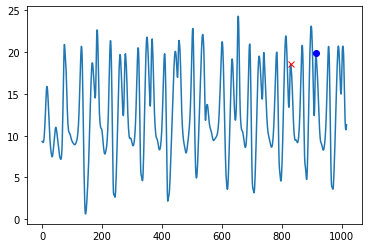

tria2gcycles for i:78
ACC Magn Trial with peaks


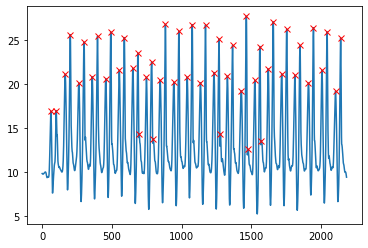

ACC Magn Trial with gait cycle


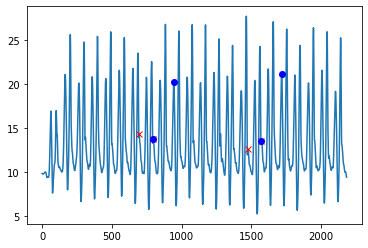

tria2gcycles for i:79
ACC Magn Trial with peaks


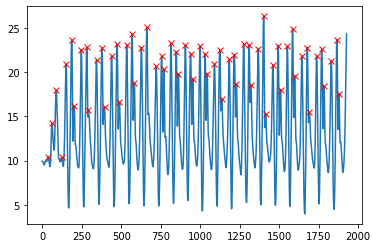

ACC Magn Trial with gait cycle


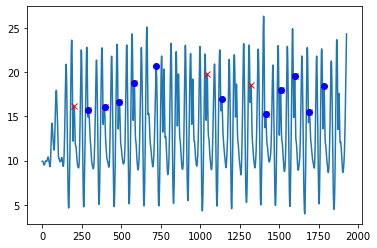

tria2gcycles for i:80
ACC Magn Trial with peaks


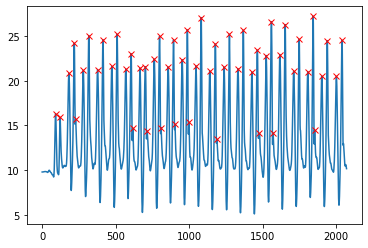

ACC Magn Trial with gait cycle


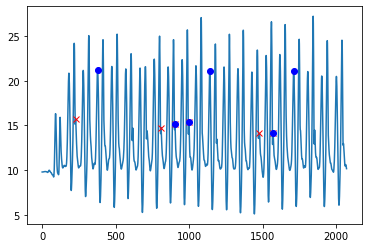

tria2gcycles for i:81
ACC Magn Trial with peaks


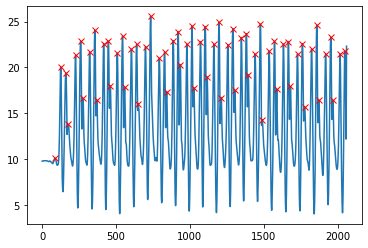

ACC Magn Trial with gait cycle


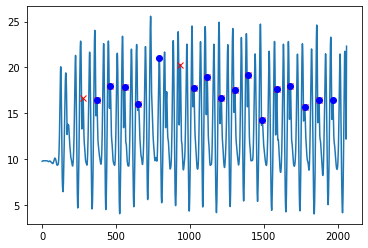

tria2gcycles for i:82
ACC Magn Trial with peaks


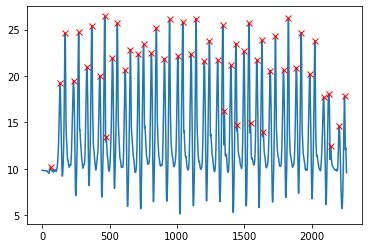

ACC Magn Trial with gait cycle


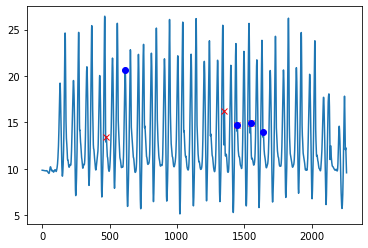

tria2gcycles for i:83
ACC Magn Trial with peaks


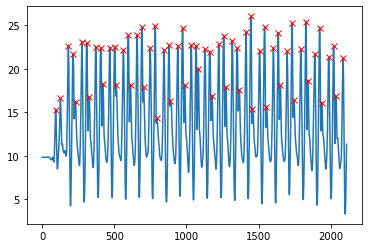

ACC Magn Trial with gait cycle


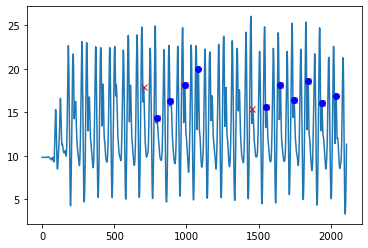

tria2gcycles for i:84
ACC Magn Trial with peaks


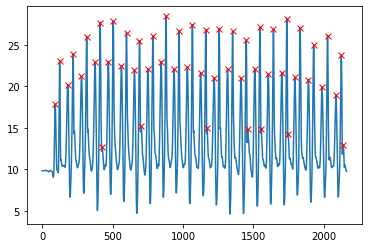

ACC Magn Trial with gait cycle


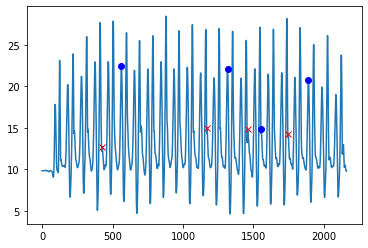

tria2gcycles for i:85
ACC Magn Trial with peaks


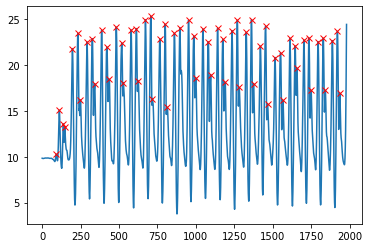

ACC Magn Trial with gait cycle


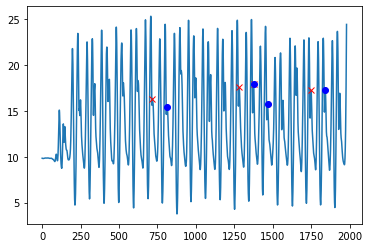

tria2gcycles for i:86
ACC Magn Trial with peaks


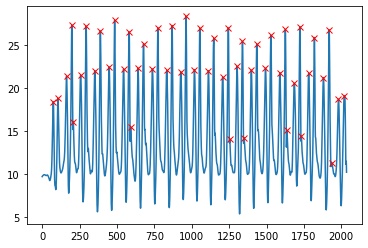

ACC Magn Trial with gait cycle


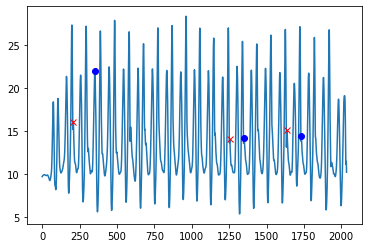

tria2gcycles for i:87
ACC Magn Trial with peaks


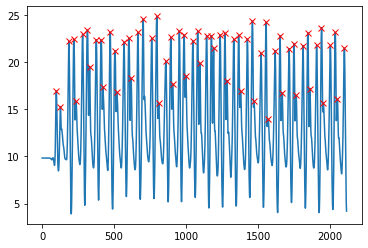

ACC Magn Trial with gait cycle


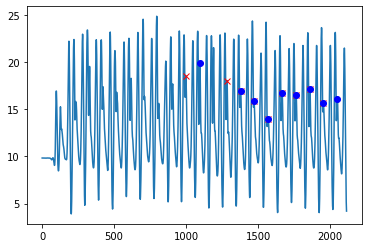

tria2gcycles for i:88
ACC Magn Trial with peaks


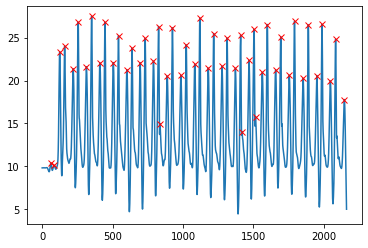

ACC Magn Trial with gait cycle


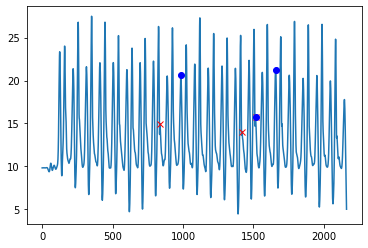

tria2gcycles for i:89
ACC Magn Trial with peaks


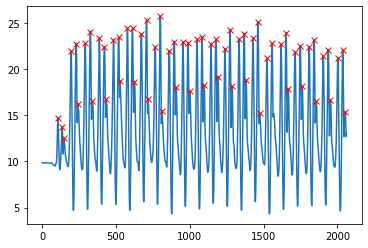

ACC Magn Trial with gait cycle


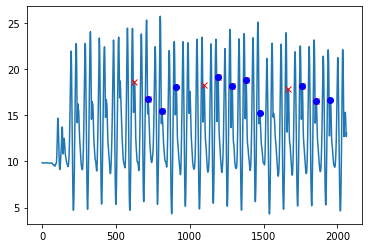

tria2gcycles for i:90
ACC Magn Trial with peaks


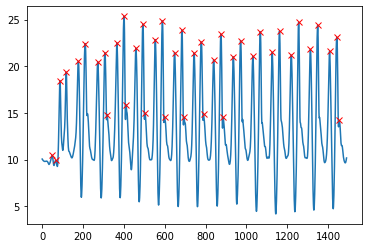

ACC Magn Trial with gait cycle


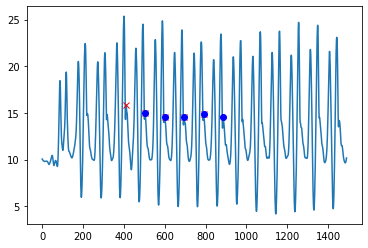

tria2gcycles for i:91
ACC Magn Trial with peaks


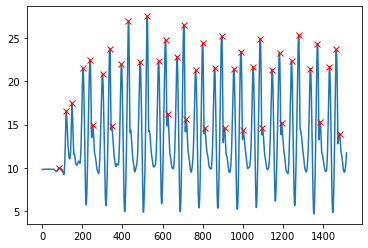

ACC Magn Trial with gait cycle


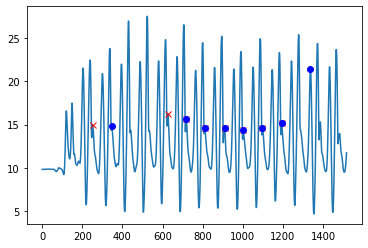

tria2gcycles for i:92
ACC Magn Trial with peaks


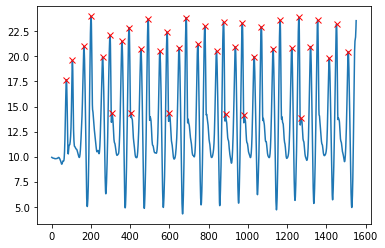

ACC Magn Trial with gait cycle


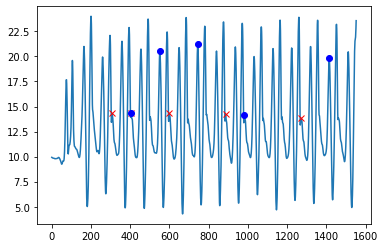

tria2gcycles for i:93
ACC Magn Trial with peaks


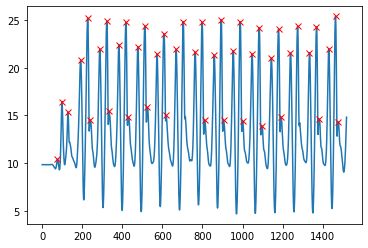

ACC Magn Trial with gait cycle


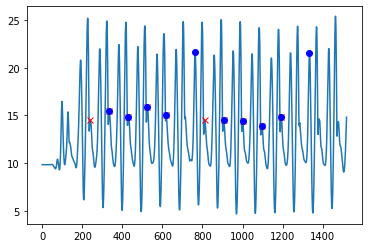

tria2gcycles for i:94
ACC Magn Trial with peaks


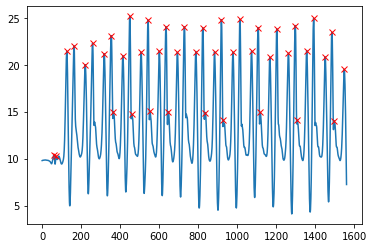

ACC Magn Trial with gait cycle


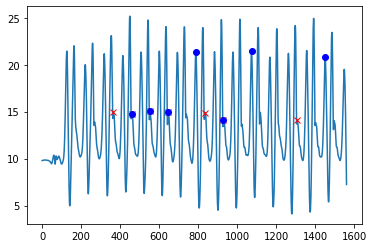

tria2gcycles for i:95
ACC Magn Trial with peaks


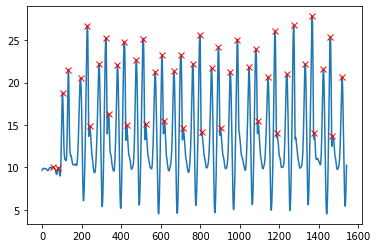

ACC Magn Trial with gait cycle


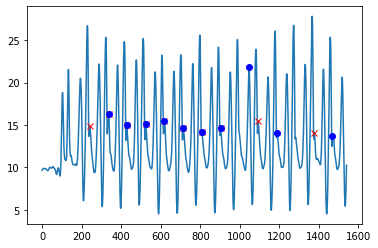

tria2gcycles for i:96
ACC Magn Trial with peaks


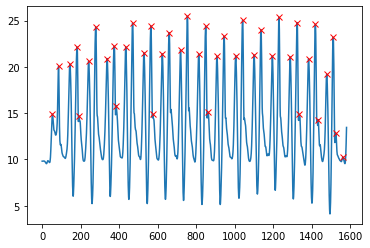

ACC Magn Trial with gait cycle


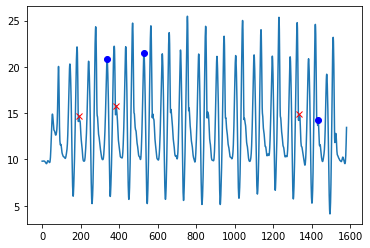

tria2gcycles for i:97
ACC Magn Trial with peaks


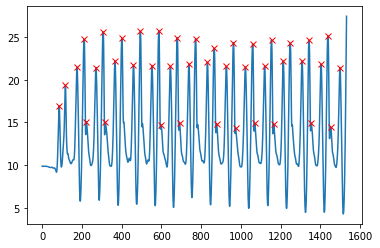

ACC Magn Trial with gait cycle


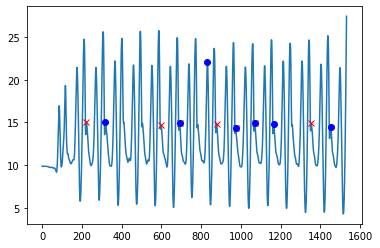

tria2gcycles for i:98
ACC Magn Trial with peaks


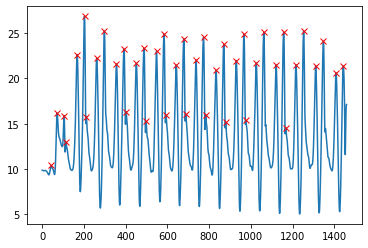

ACC Magn Trial with gait cycle


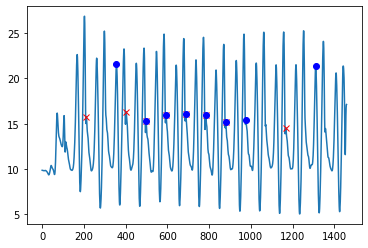

tria2gcycles for i:99
ACC Magn Trial with peaks


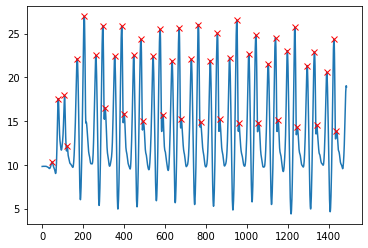

ACC Magn Trial with gait cycle


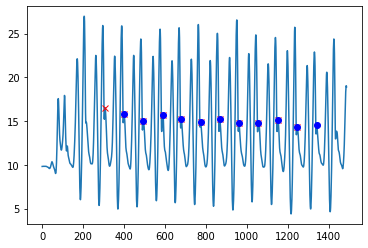

tria2gcycles for i:100
ACC Magn Trial with peaks


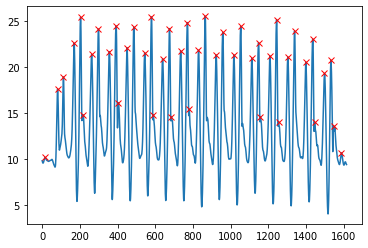

ACC Magn Trial with gait cycle


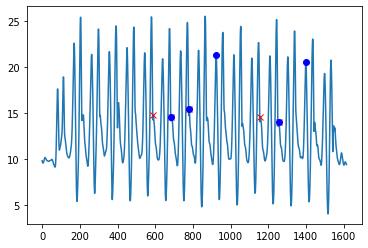

tria2gcycles for i:101
ACC Magn Trial with peaks


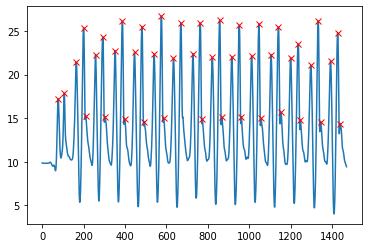

ACC Magn Trial with gait cycle


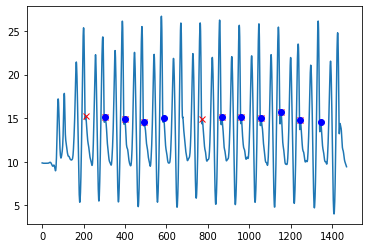

tria2gcycles for i:102
ACC Magn Trial with peaks


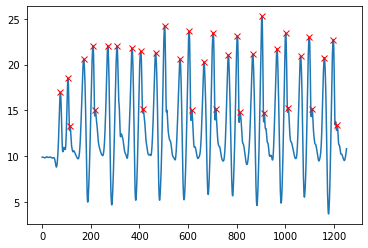

ACC Magn Trial with gait cycle


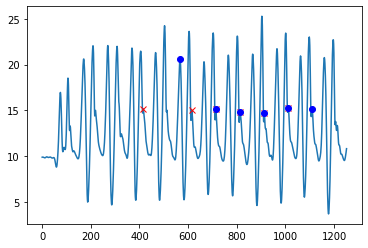

tria2gcycles for i:103
ACC Magn Trial with peaks


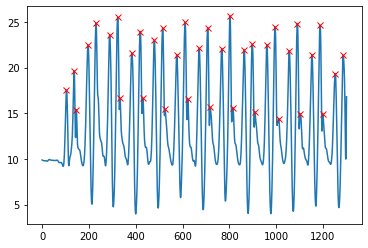

ACC Magn Trial with gait cycle


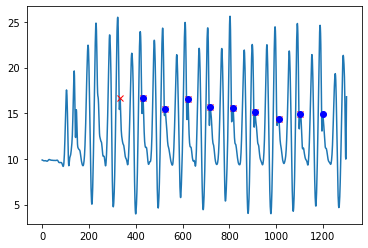

tria2gcycles for i:104
ACC Magn Trial with peaks


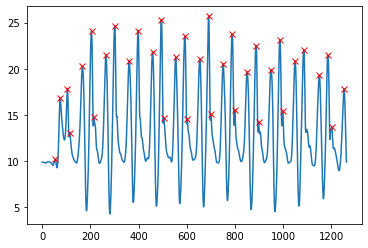

ACC Magn Trial with gait cycle


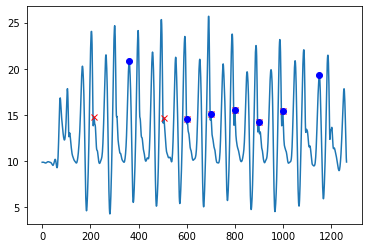

tria2gcycles for i:105
ACC Magn Trial with peaks


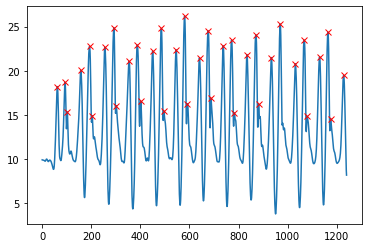

ACC Magn Trial with gait cycle


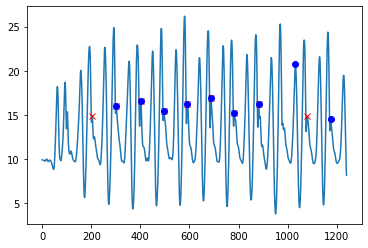

tria2gcycles for i:106
ACC Magn Trial with peaks


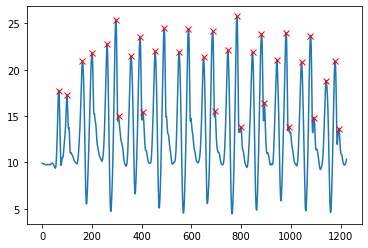

ACC Magn Trial with gait cycle


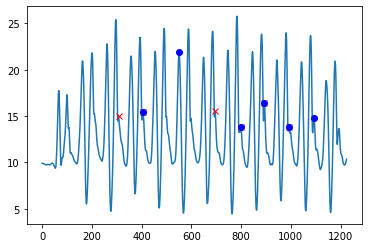

tria2gcycles for i:107
ACC Magn Trial with peaks


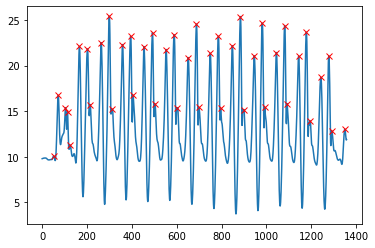

ACC Magn Trial with gait cycle


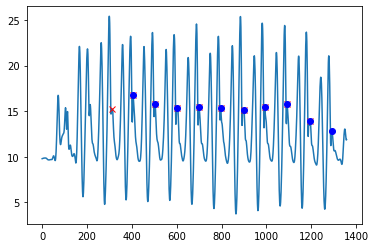

tria2gcycles for i:108
ACC Magn Trial with peaks


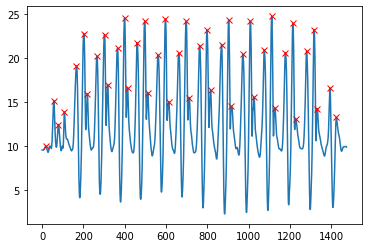

ACC Magn Trial with gait cycle


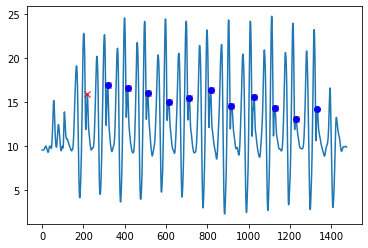

tria2gcycles for i:109
ACC Magn Trial with peaks


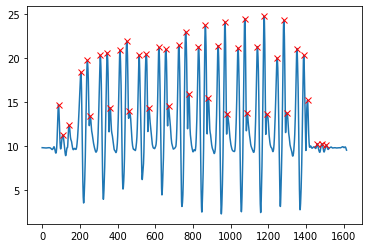

ACC Magn Trial with gait cycle


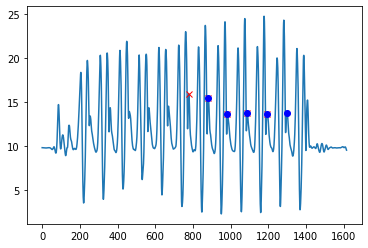

tria2gcycles for i:110
ACC Magn Trial with peaks


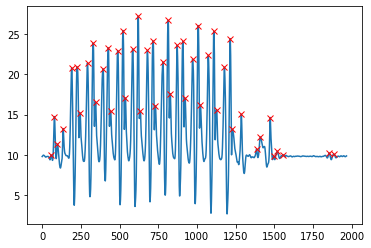

ACC Magn Trial with gait cycle


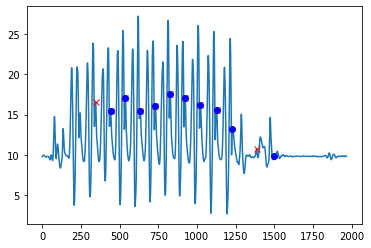

tria2gcycles for i:111
ACC Magn Trial with peaks


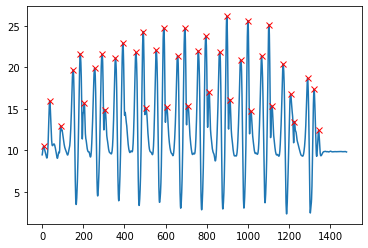

ACC Magn Trial with gait cycle


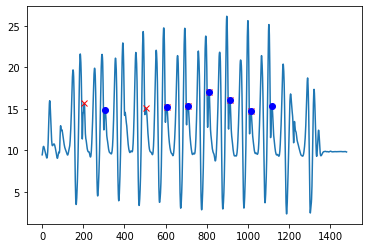

tria2gcycles for i:112
ACC Magn Trial with peaks


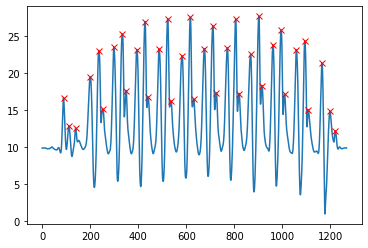

ACC Magn Trial with gait cycle


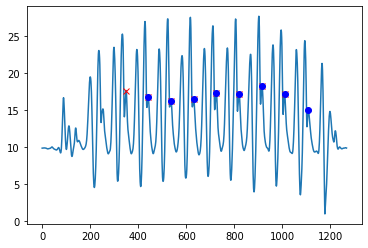

tria2gcycles for i:113
ACC Magn Trial with peaks


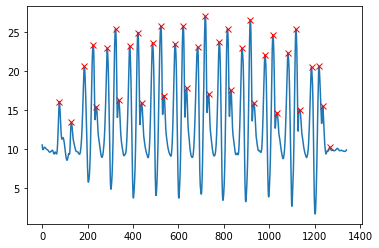

ACC Magn Trial with gait cycle


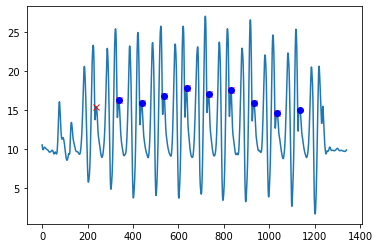

tria2gcycles for i:114
ACC Magn Trial with peaks


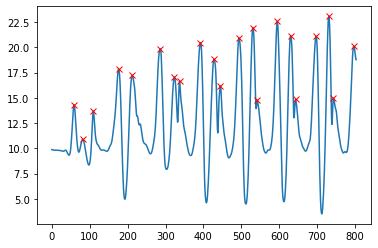

ACC Magn Trial with gait cycle


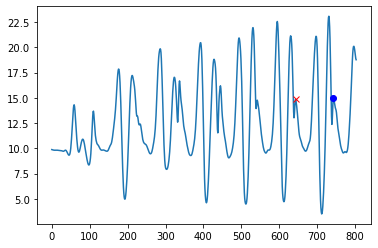

tria2gcycles for i:115
ACC Magn Trial with peaks


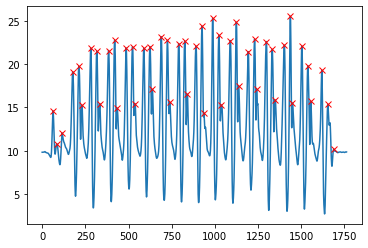

ACC Magn Trial with gait cycle


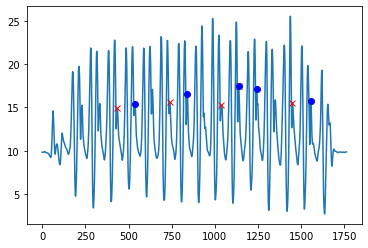

tria2gcycles for i:116
ACC Magn Trial with peaks


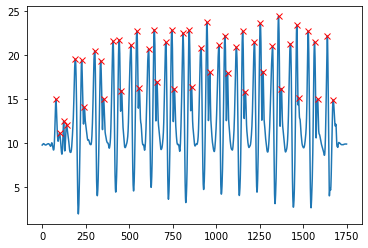

ACC Magn Trial with gait cycle


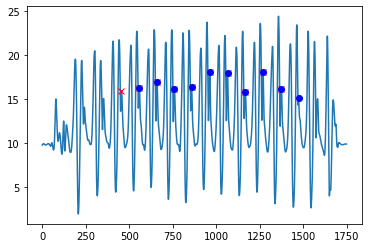

tria2gcycles for i:117
ACC Magn Trial with peaks


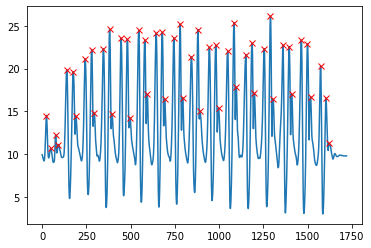

ACC Magn Trial with gait cycle


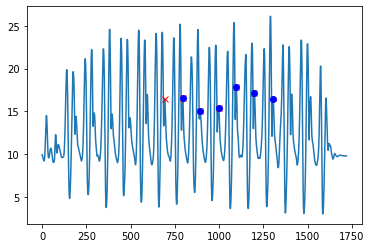

tria2gcycles for i:118
ACC Magn Trial with peaks


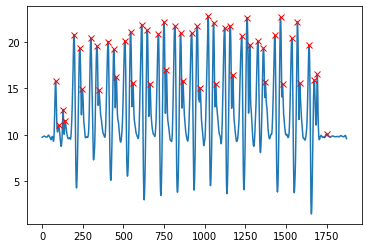

ACC Magn Trial with gait cycle


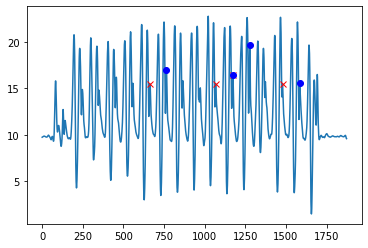

tria2gcycles for i:119
ACC Magn Trial with peaks


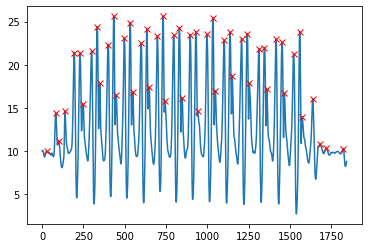

ACC Magn Trial with gait cycle


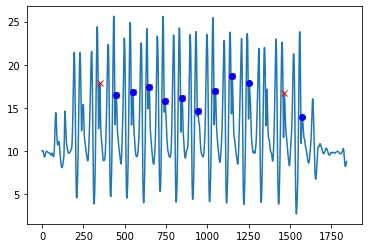

tria2gcycles for i:120
ACC Magn Trial with peaks


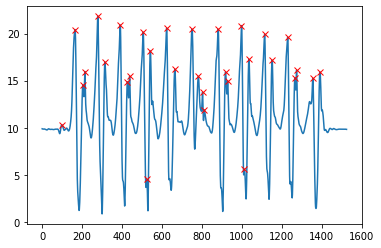

ACC Magn Trial with gait cycle


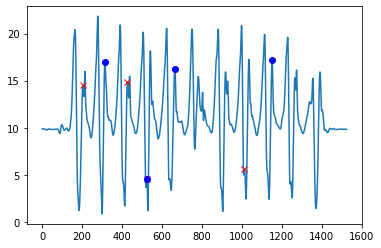

tria2gcycles for i:121
ACC Magn Trial with peaks


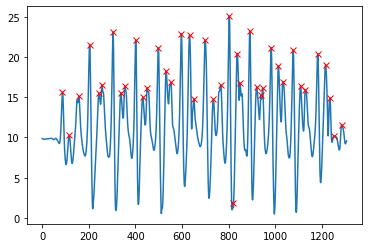

ACC Magn Trial with gait cycle


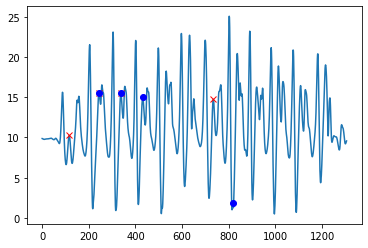

tria2gcycles for i:122
ACC Magn Trial with peaks


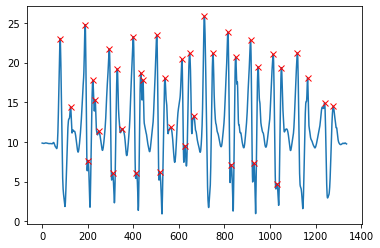

ACC Magn Trial with gait cycle


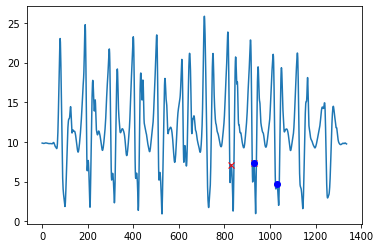

tria2gcycles for i:123
ACC Magn Trial with peaks


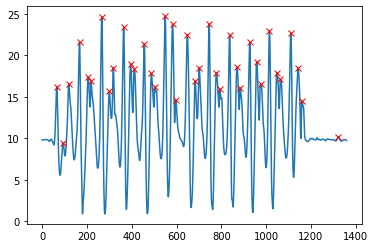

ACC Magn Trial with gait cycle


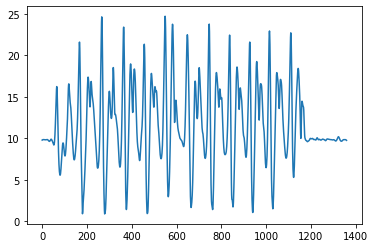

tria2gcycles for i:124
ACC Magn Trial with peaks


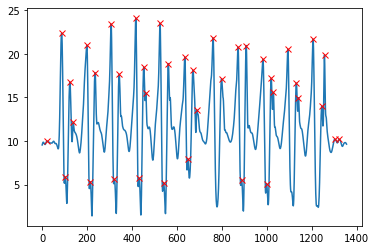

ACC Magn Trial with gait cycle


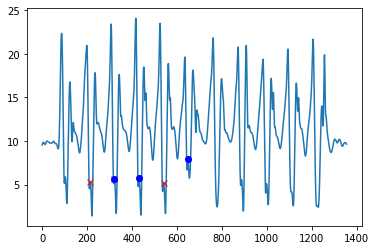

tria2gcycles for i:125
ACC Magn Trial with peaks


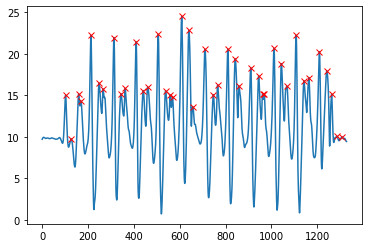

ACC Magn Trial with gait cycle


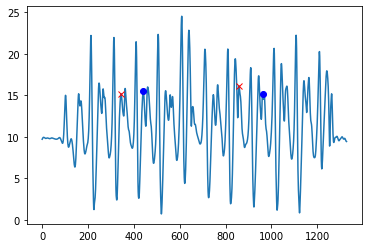

tria2gcycles for i:126
ACC Magn Trial with peaks


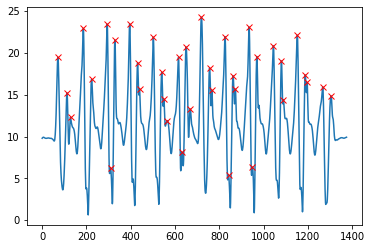

ACC Magn Trial with gait cycle


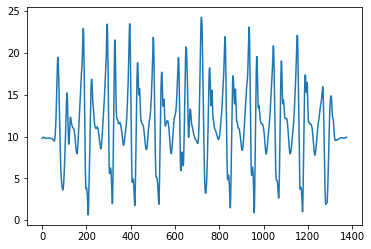

tria2gcycles for i:127
ACC Magn Trial with peaks


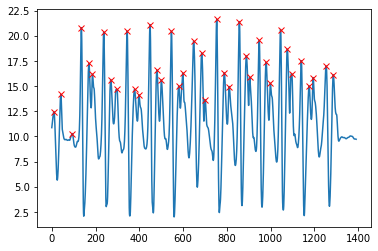

ACC Magn Trial with gait cycle


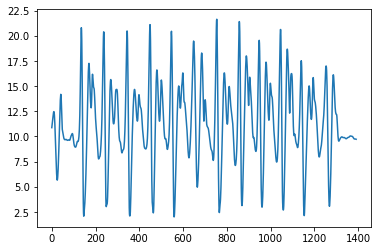

tria2gcycles for i:128
ACC Magn Trial with peaks


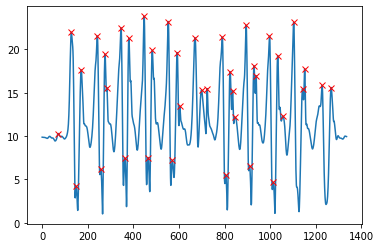

ACC Magn Trial with gait cycle


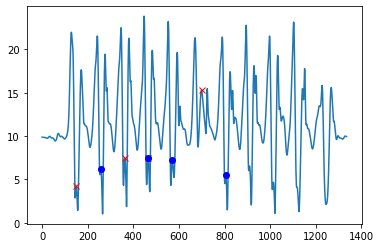

tria2gcycles for i:129
ACC Magn Trial with peaks


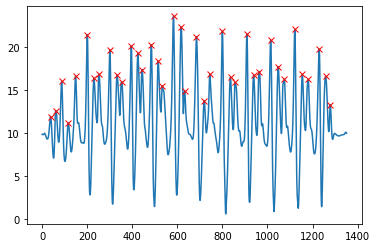

ACC Magn Trial with gait cycle


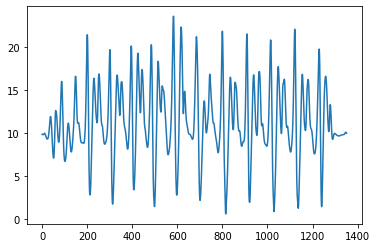

tria2gcycles for i:130
ACC Magn Trial with peaks


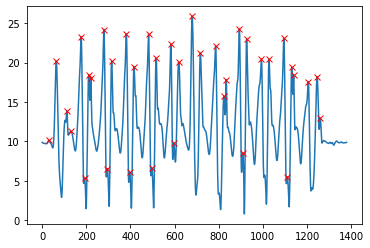

ACC Magn Trial with gait cycle


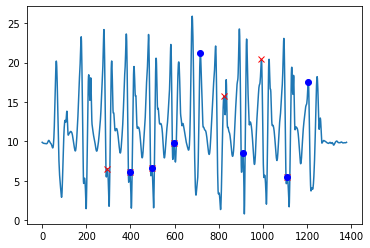

tria2gcycles for i:131
ACC Magn Trial with peaks


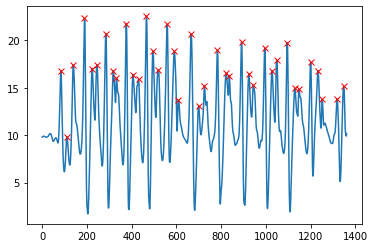

ACC Magn Trial with gait cycle


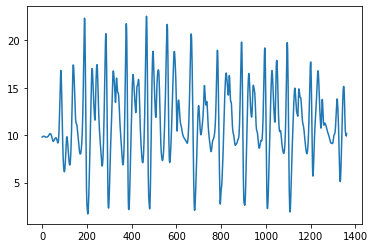

tria2gcycles for i:132
ACC Magn Trial with peaks


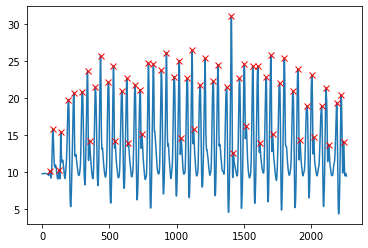

ACC Magn Trial with gait cycle


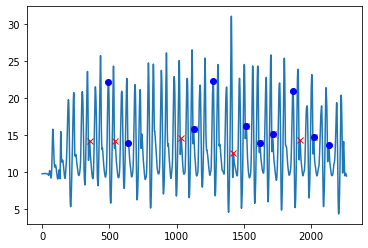

tria2gcycles for i:133
ACC Magn Trial with peaks


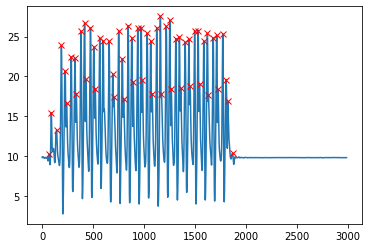

ACC Magn Trial with gait cycle


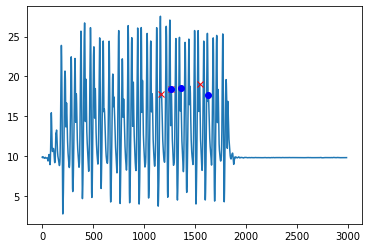

tria2gcycles for i:134
ACC Magn Trial with peaks


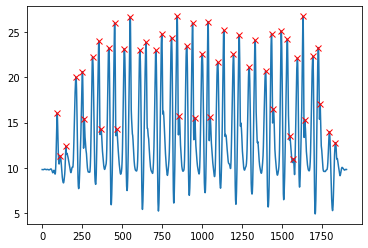

ACC Magn Trial with gait cycle


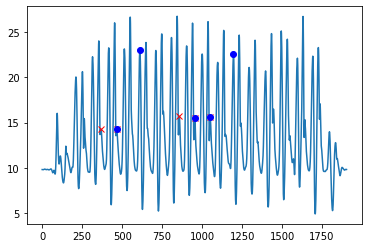

tria2gcycles for i:135
ACC Magn Trial with peaks


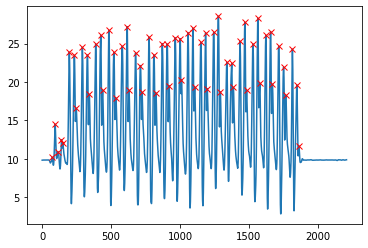

ACC Magn Trial with gait cycle


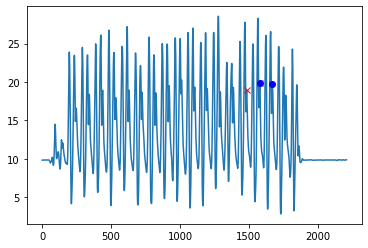

tria2gcycles for i:136
ACC Magn Trial with peaks


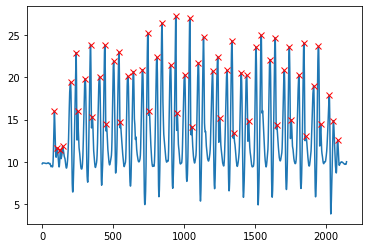

ACC Magn Trial with gait cycle


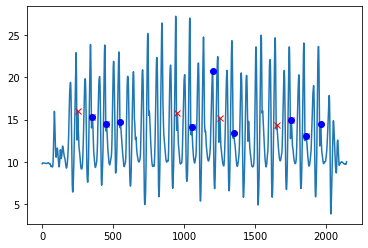

tria2gcycles for i:137
ACC Magn Trial with peaks


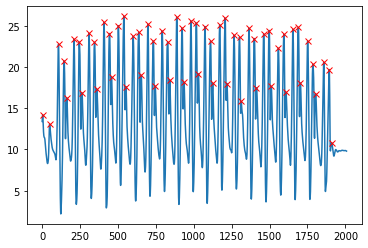

ACC Magn Trial with gait cycle


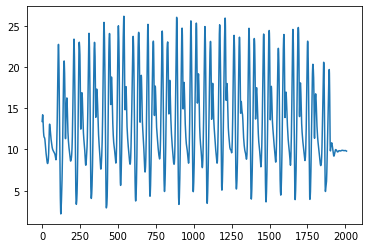

tria2gcycles for i:138
ACC Magn Trial with peaks


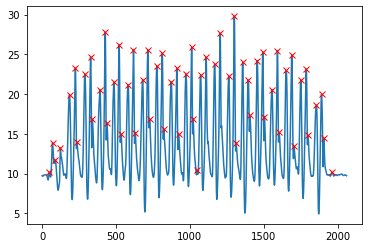

ACC Magn Trial with gait cycle


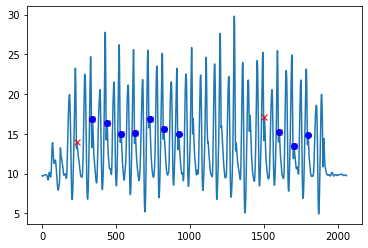

tria2gcycles for i:139
ACC Magn Trial with peaks


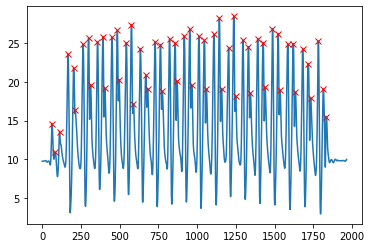

ACC Magn Trial with gait cycle


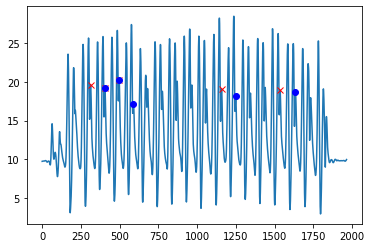

tria2gcycles for i:140
ACC Magn Trial with peaks


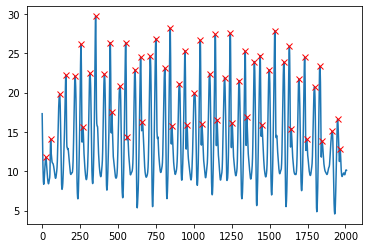

ACC Magn Trial with gait cycle


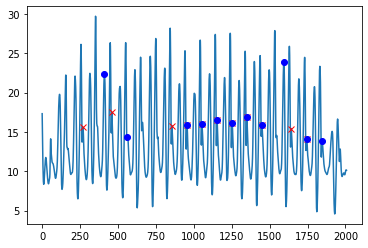

tria2gcycles for i:141
ACC Magn Trial with peaks


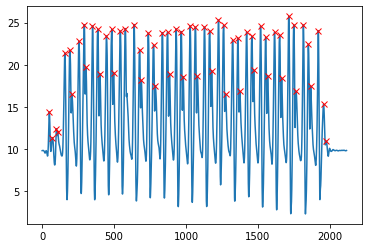

ACC Magn Trial with gait cycle


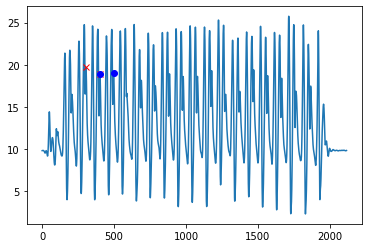

tria2gcycles for i:142
ACC Magn Trial with peaks


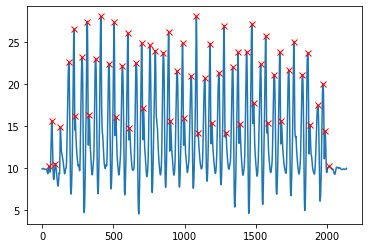

ACC Magn Trial with gait cycle


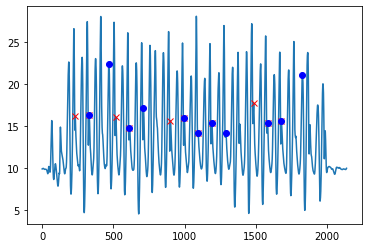

tria2gcycles for i:143
ACC Magn Trial with peaks


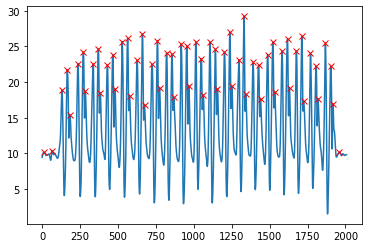

ACC Magn Trial with gait cycle


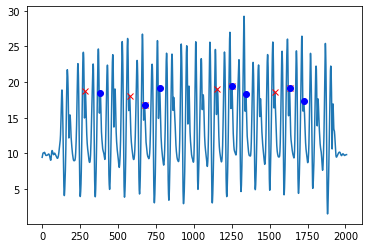

tria2gcycles for i:144
ACC Magn Trial with peaks


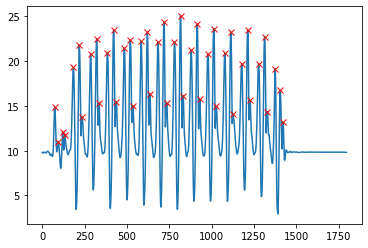

ACC Magn Trial with gait cycle


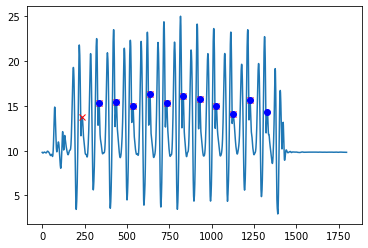

tria2gcycles for i:145
ACC Magn Trial with peaks


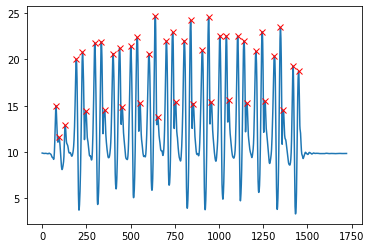

ACC Magn Trial with gait cycle


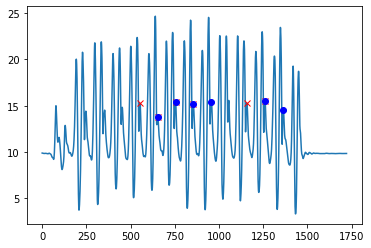

tria2gcycles for i:146
ACC Magn Trial with peaks


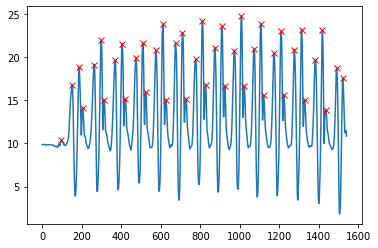

ACC Magn Trial with gait cycle


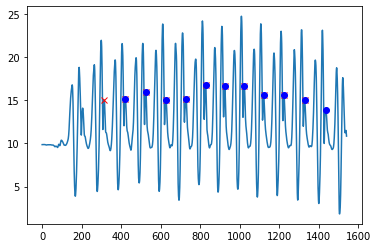

tria2gcycles for i:147
ACC Magn Trial with peaks


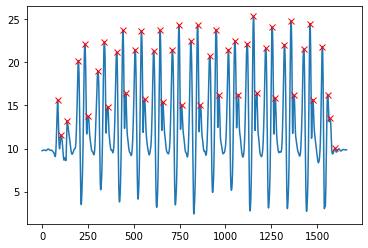

ACC Magn Trial with gait cycle


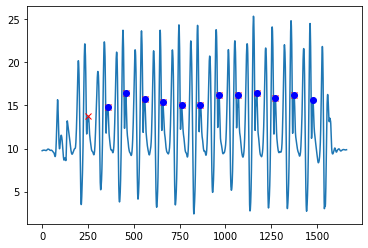

tria2gcycles for i:148
ACC Magn Trial with peaks


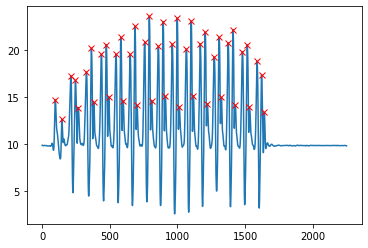

ACC Magn Trial with gait cycle


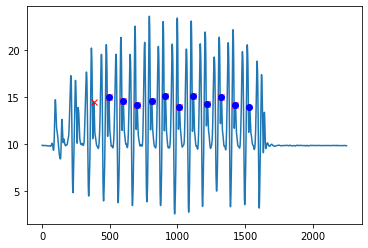

tria2gcycles for i:149
ACC Magn Trial with peaks


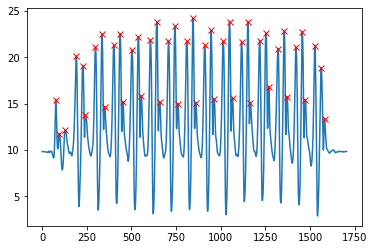

ACC Magn Trial with gait cycle


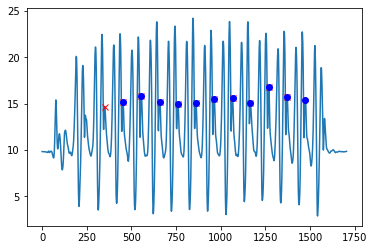

tria2gcycles for i:150
ACC Magn Trial with peaks


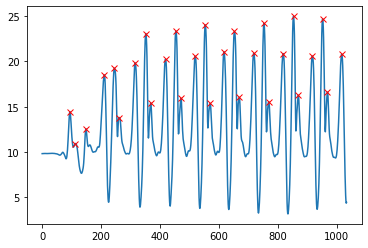

ACC Magn Trial with gait cycle


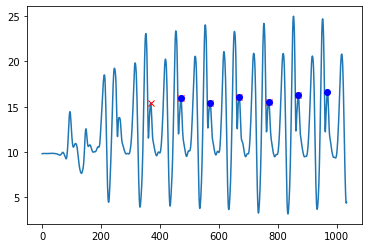

tria2gcycles for i:151
ACC Magn Trial with peaks


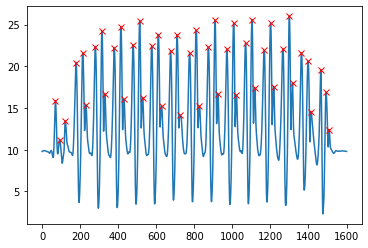

ACC Magn Trial with gait cycle


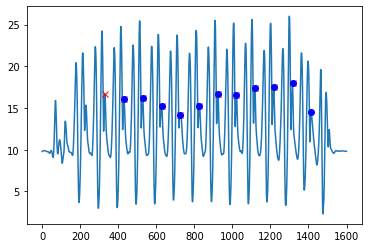

tria2gcycles for i:152
ACC Magn Trial with peaks


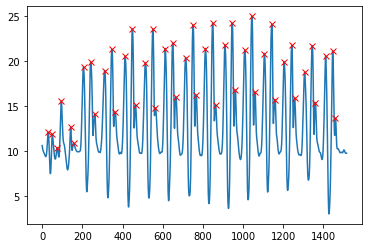

ACC Magn Trial with gait cycle


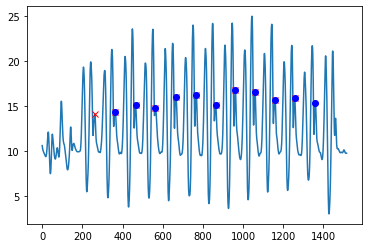

tria2gcycles for i:153
ACC Magn Trial with peaks


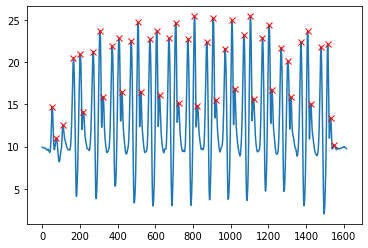

ACC Magn Trial with gait cycle


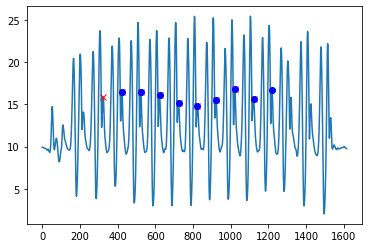

tria2gcycles for i:154
ACC Magn Trial with peaks


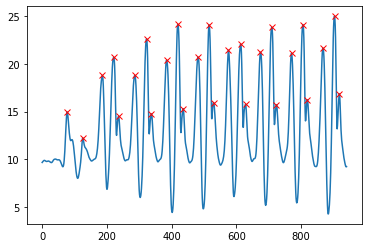

ACC Magn Trial with gait cycle


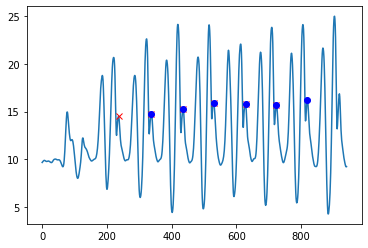

tria2gcycles for i:155
ACC Magn Trial with peaks


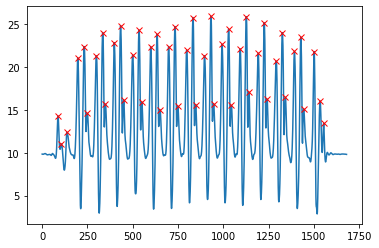

ACC Magn Trial with gait cycle


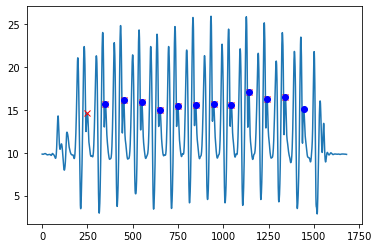

tria2gcycles for i:156
ACC Magn Trial with peaks


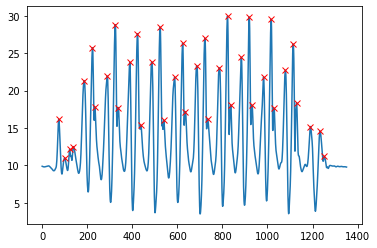

ACC Magn Trial with gait cycle


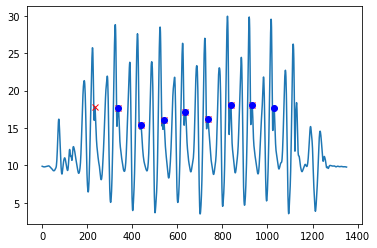

tria2gcycles for i:157
ACC Magn Trial with peaks


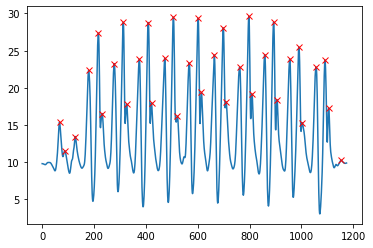

ACC Magn Trial with gait cycle


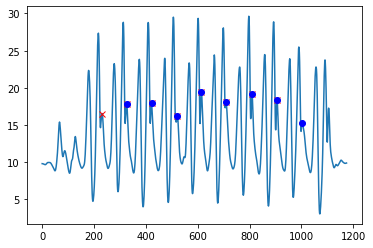

tria2gcycles for i:158
ACC Magn Trial with peaks


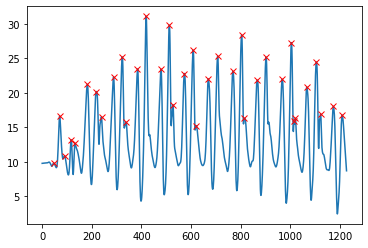

ACC Magn Trial with gait cycle


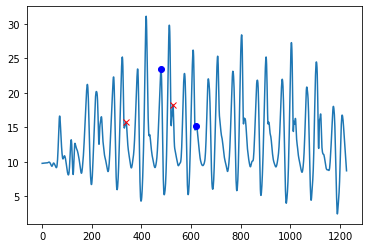

tria2gcycles for i:159
ACC Magn Trial with peaks


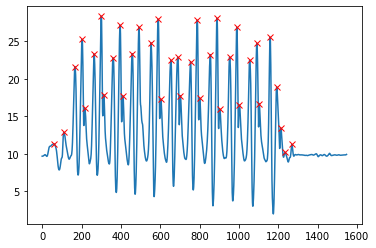

ACC Magn Trial with gait cycle


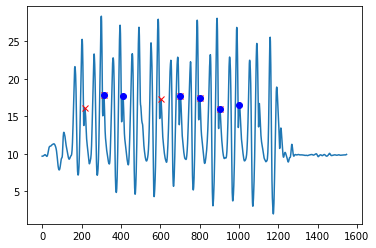

tria2gcycles for i:160
ACC Magn Trial with peaks


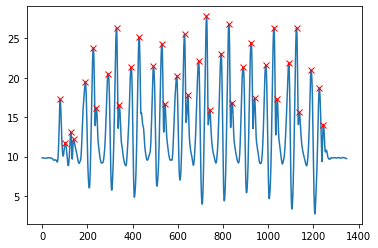

ACC Magn Trial with gait cycle


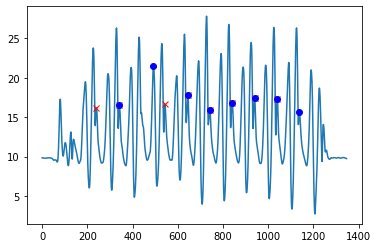

tria2gcycles for i:161
ACC Magn Trial with peaks


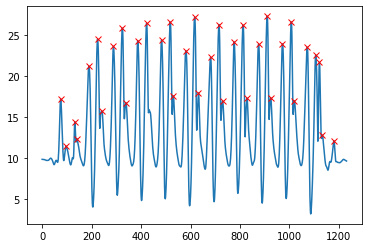

ACC Magn Trial with gait cycle


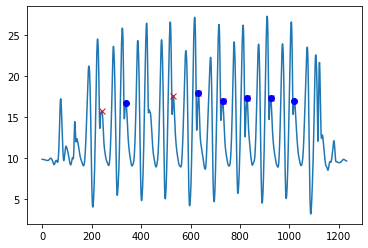

tria2gcycles for i:162
ACC Magn Trial with peaks


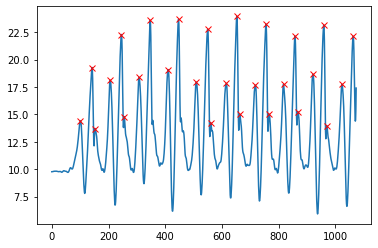

ACC Magn Trial with gait cycle


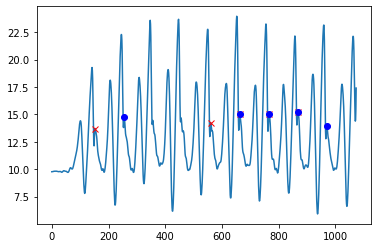

tria2gcycles for i:163
ACC Magn Trial with peaks


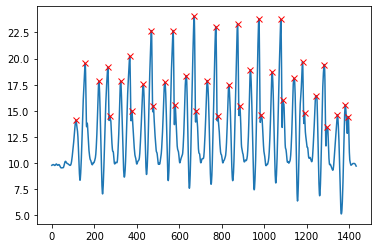

ACC Magn Trial with gait cycle


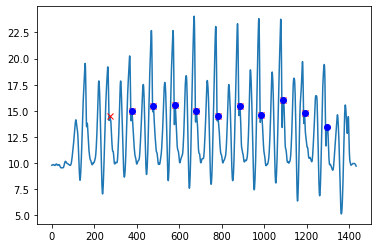

tria2gcycles for i:164
ACC Magn Trial with peaks


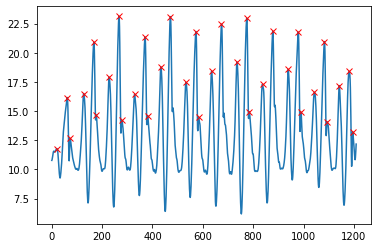

ACC Magn Trial with gait cycle


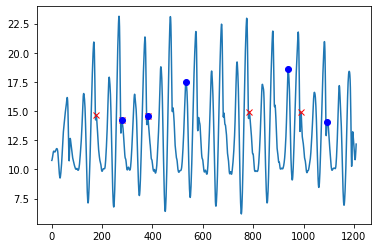

tria2gcycles for i:165
ACC Magn Trial with peaks


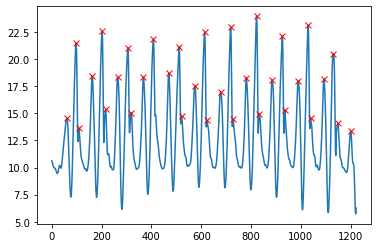

ACC Magn Trial with gait cycle


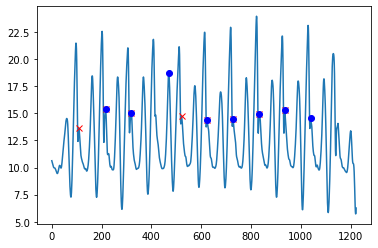

tria2gcycles for i:166
ACC Magn Trial with peaks


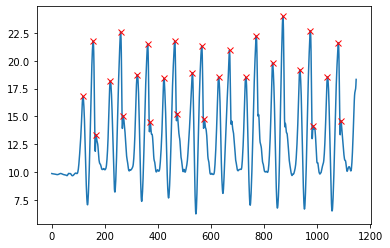

ACC Magn Trial with gait cycle


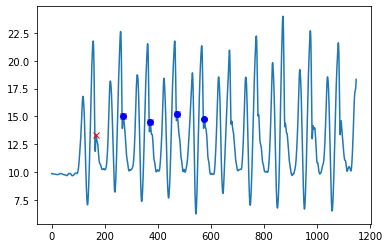

tria2gcycles for i:167
ACC Magn Trial with peaks


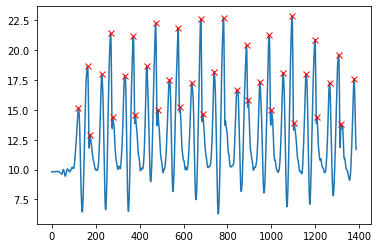

ACC Magn Trial with gait cycle


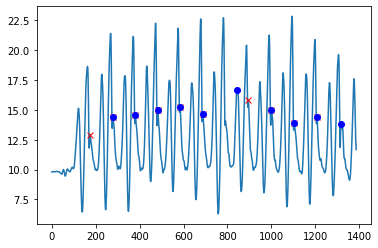

tria2gcycles for i:168
ACC Magn Trial with peaks


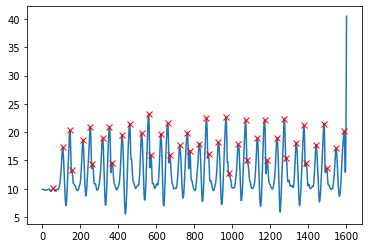

ACC Magn Trial with gait cycle


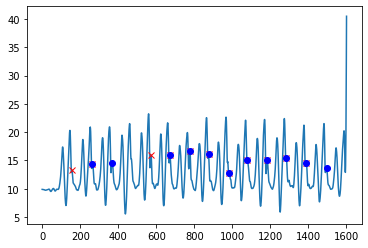

tria2gcycles for i:169
ACC Magn Trial with peaks


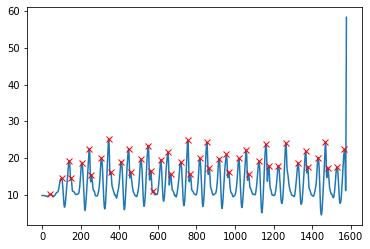

ACC Magn Trial with gait cycle


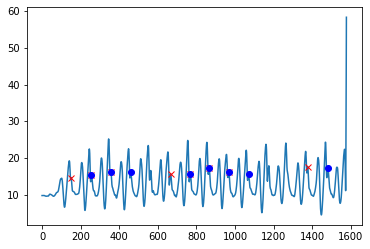

tria2gcycles for i:170
ACC Magn Trial with peaks


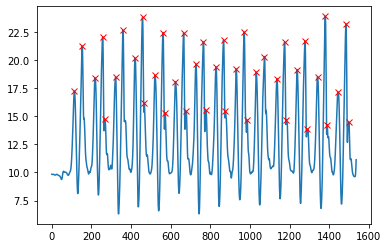

ACC Magn Trial with gait cycle


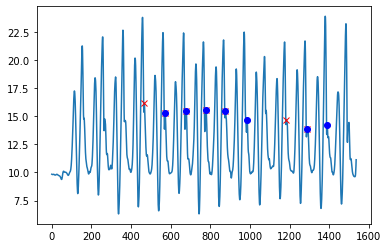

tria2gcycles for i:171
ACC Magn Trial with peaks


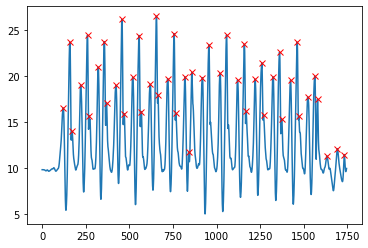

ACC Magn Trial with gait cycle


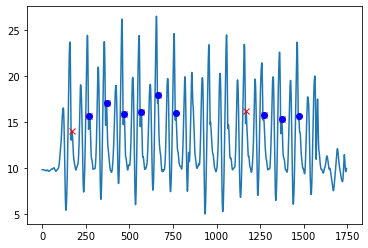

tria2gcycles for i:172
ACC Magn Trial with peaks


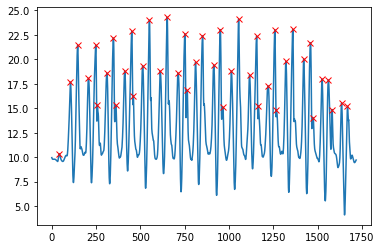

ACC Magn Trial with gait cycle


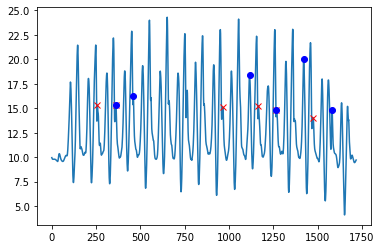

tria2gcycles for i:173
ACC Magn Trial with peaks


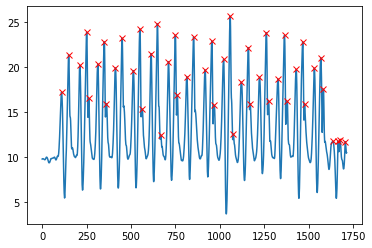

ACC Magn Trial with gait cycle


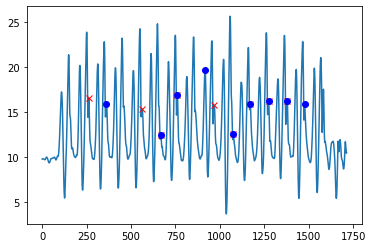

tria2gcycles for i:174
ACC Magn Trial with peaks


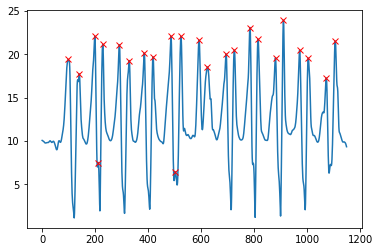

ACC Magn Trial with gait cycle


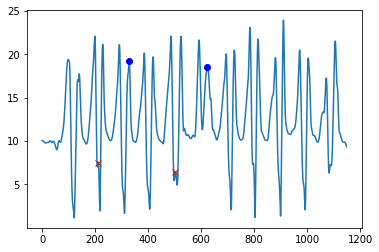

tria2gcycles for i:175
ACC Magn Trial with peaks


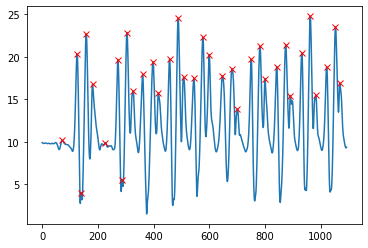

ACC Magn Trial with gait cycle


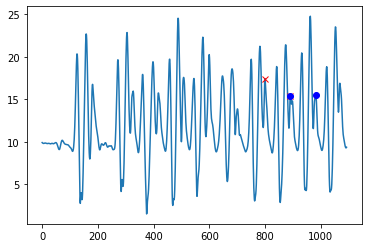

tria2gcycles for i:176
ACC Magn Trial with peaks


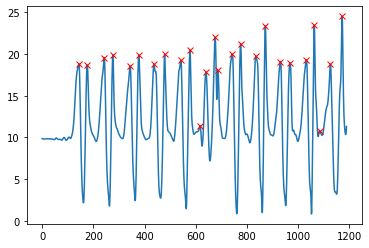

ACC Magn Trial with gait cycle


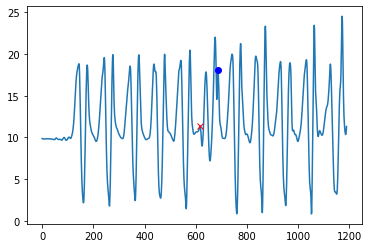

tria2gcycles for i:177
ACC Magn Trial with peaks


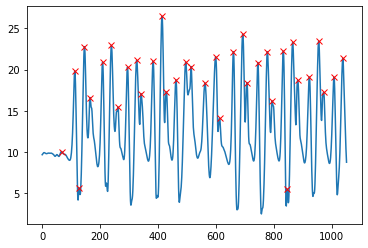

ACC Magn Trial with gait cycle


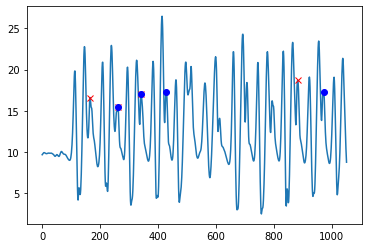

tria2gcycles for i:178
ACC Magn Trial with peaks


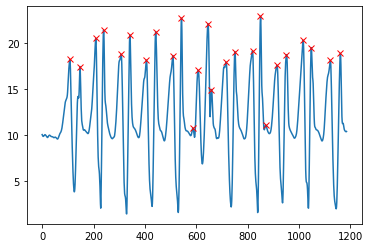

ACC Magn Trial with gait cycle


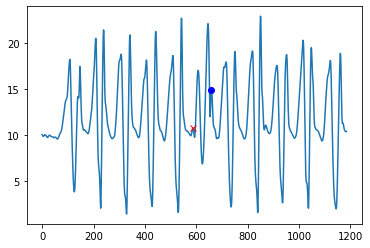

tria2gcycles for i:179
ACC Magn Trial with peaks


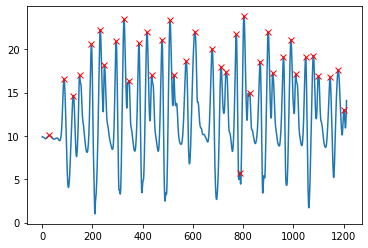

ACC Magn Trial with gait cycle


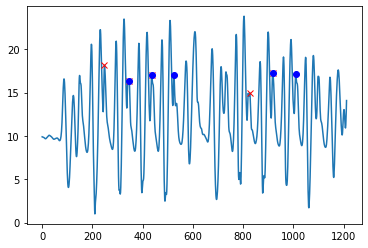

tria2gcycles for i:180
ACC Magn Trial with peaks


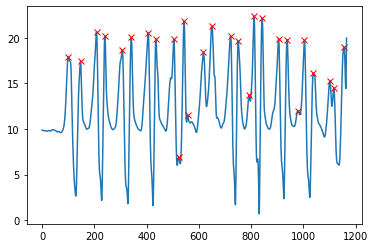

ACC Magn Trial with gait cycle


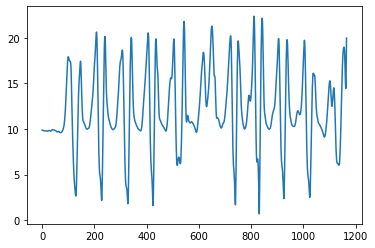

tria2gcycles for i:181
ACC Magn Trial with peaks


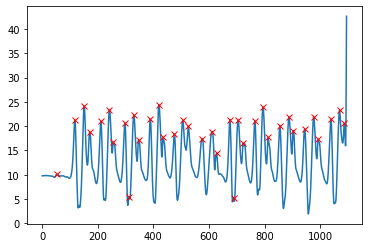

ACC Magn Trial with gait cycle


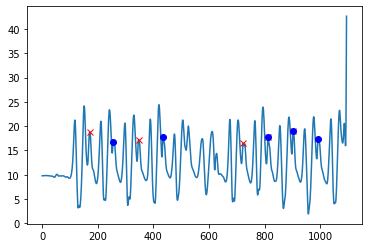

tria2gcycles for i:182
ACC Magn Trial with peaks


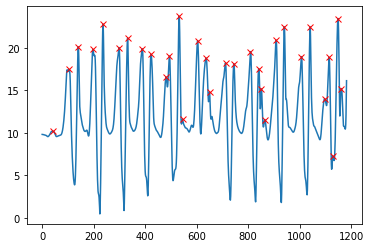

ACC Magn Trial with gait cycle


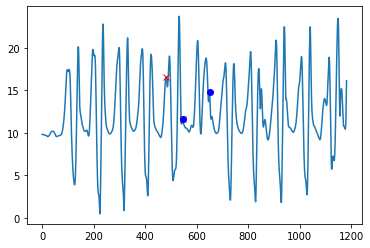

tria2gcycles for i:183
ACC Magn Trial with peaks


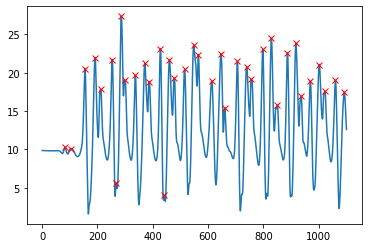

ACC Magn Trial with gait cycle


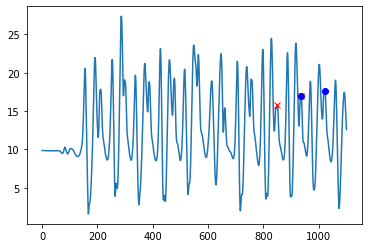

tria2gcycles for i:184
ACC Magn Trial with peaks


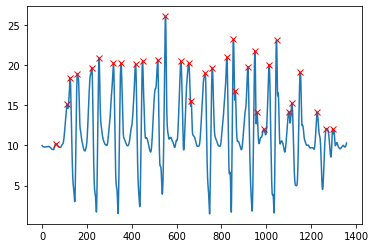

ACC Magn Trial with gait cycle


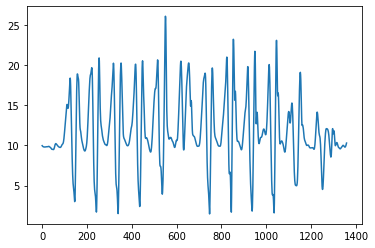

tria2gcycles for i:185
ACC Magn Trial with peaks


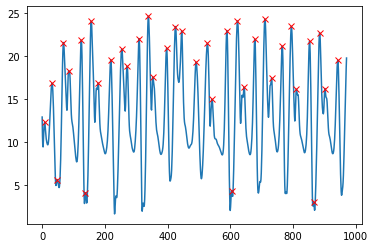

ACC Magn Trial with gait cycle


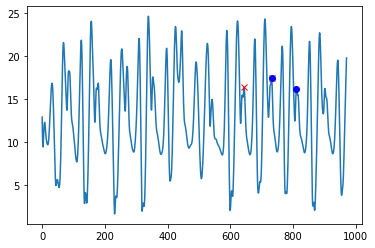

tria2gcycles for i:186
ACC Magn Trial with peaks


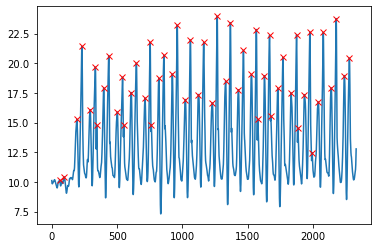

ACC Magn Trial with gait cycle


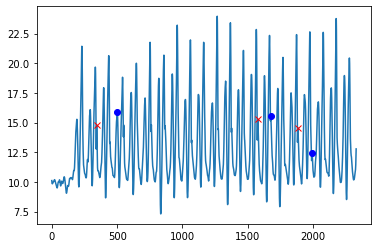

tria2gcycles for i:187
ACC Magn Trial with peaks


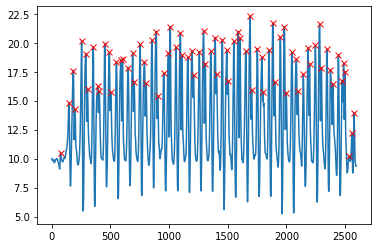

ACC Magn Trial with gait cycle


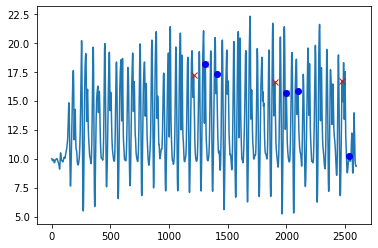

tria2gcycles for i:188
ACC Magn Trial with peaks


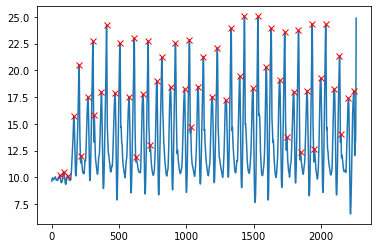

ACC Magn Trial with gait cycle


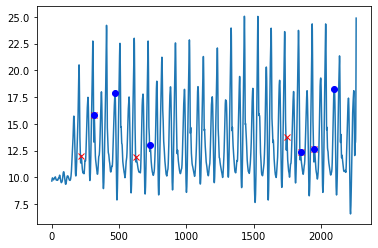

tria2gcycles for i:189
ACC Magn Trial with peaks


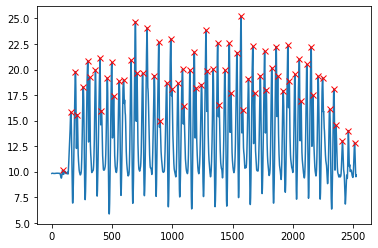

ACC Magn Trial with gait cycle


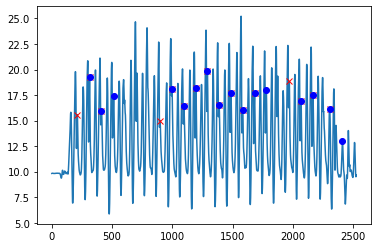

tria2gcycles for i:190
ACC Magn Trial with peaks


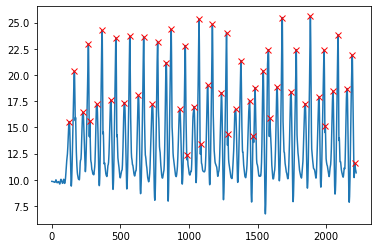

ACC Magn Trial with gait cycle


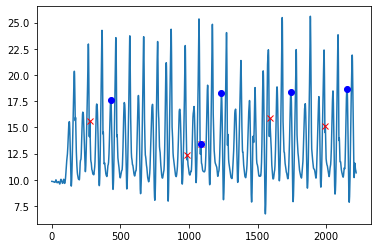

tria2gcycles for i:191
ACC Magn Trial with peaks


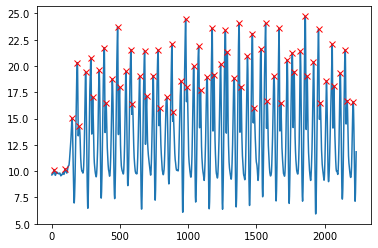

ACC Magn Trial with gait cycle


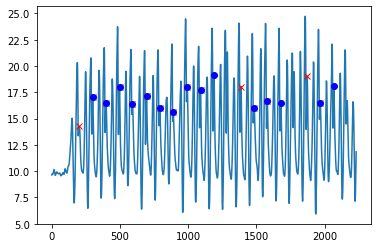

tria2gcycles for i:192
ACC Magn Trial with peaks


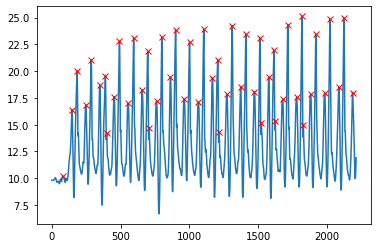

ACC Magn Trial with gait cycle


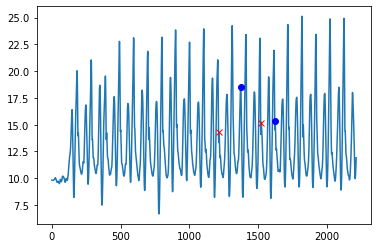

tria2gcycles for i:193
ACC Magn Trial with peaks


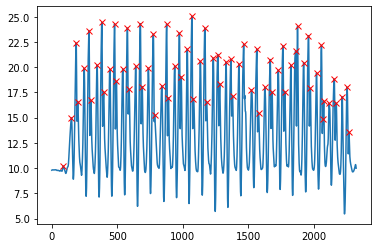

ACC Magn Trial with gait cycle


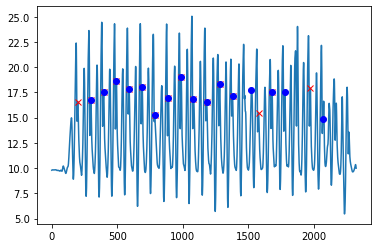

tria2gcycles for i:194
ACC Magn Trial with peaks


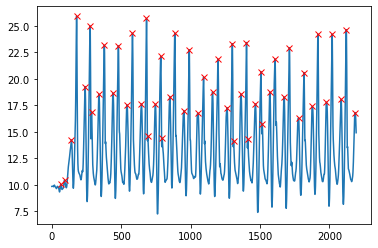

ACC Magn Trial with gait cycle


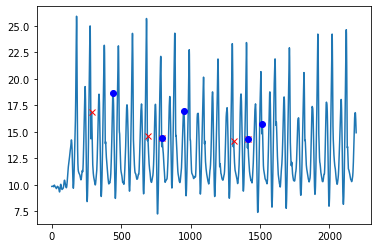

tria2gcycles for i:195
ACC Magn Trial with peaks


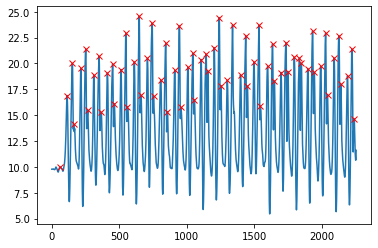

ACC Magn Trial with gait cycle


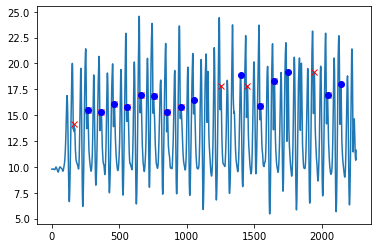

tria2gcycles for i:196
ACC Magn Trial with peaks


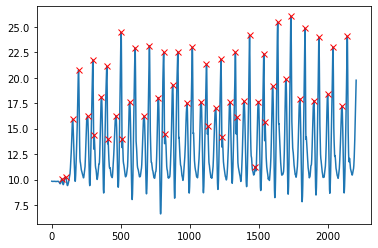

ACC Magn Trial with gait cycle


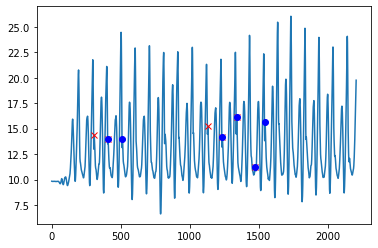

tria2gcycles for i:197
ACC Magn Trial with peaks


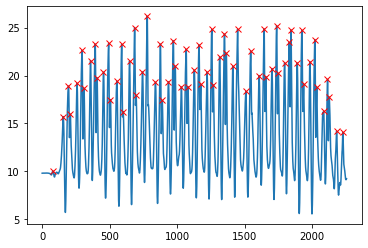

ACC Magn Trial with gait cycle


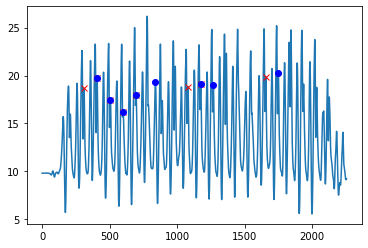

tria2gcycles for i:198
ACC Magn Trial with peaks


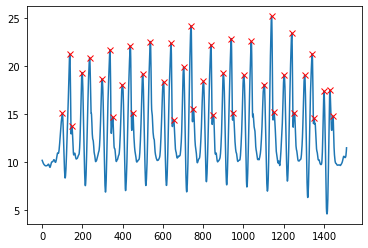

ACC Magn Trial with gait cycle


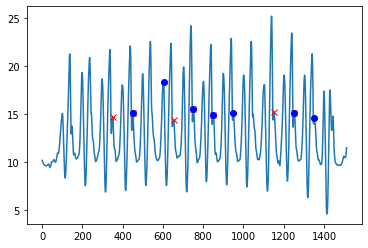

tria2gcycles for i:199
ACC Magn Trial with peaks


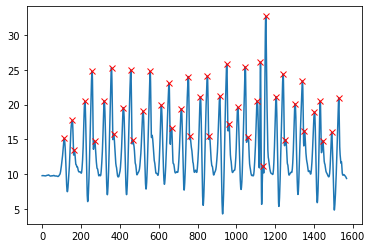

ACC Magn Trial with gait cycle


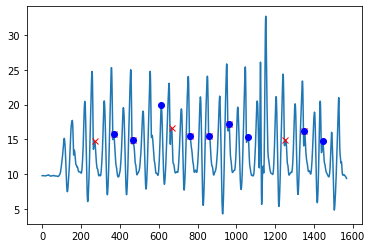

tria2gcycles for i:200
ACC Magn Trial with peaks


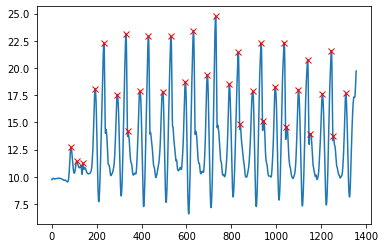

ACC Magn Trial with gait cycle


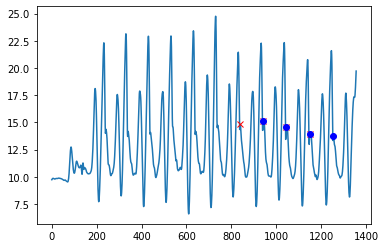

tria2gcycles for i:201
ACC Magn Trial with peaks


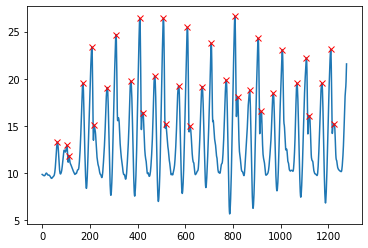

ACC Magn Trial with gait cycle


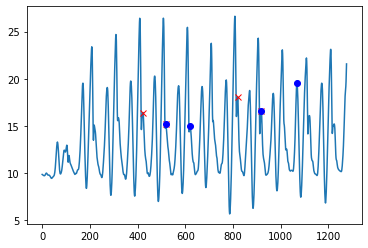

tria2gcycles for i:202
ACC Magn Trial with peaks


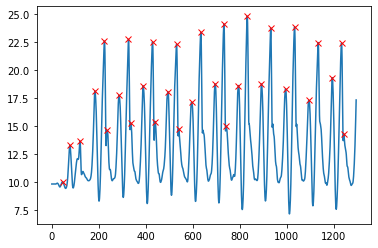

ACC Magn Trial with gait cycle


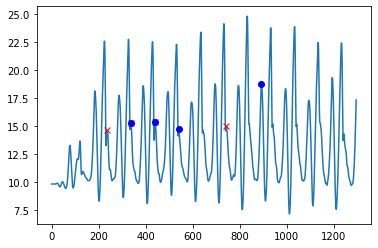

tria2gcycles for i:203
ACC Magn Trial with peaks


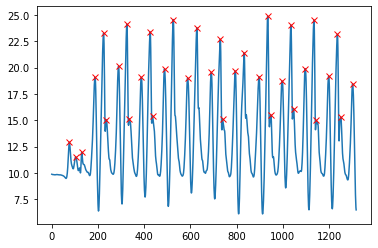

ACC Magn Trial with gait cycle


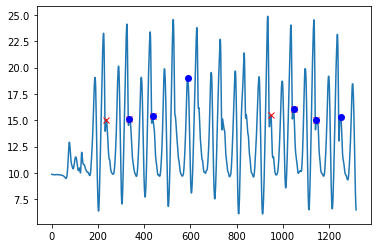

tria2gcycles for i:204
ACC Magn Trial with peaks


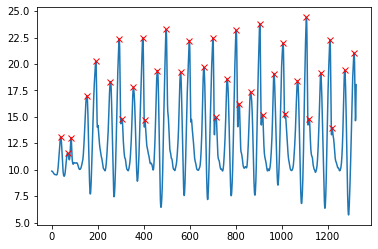

ACC Magn Trial with gait cycle


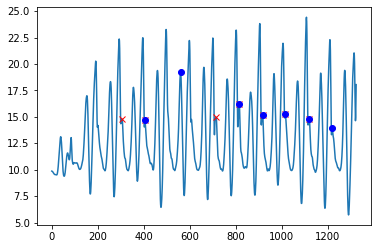

tria2gcycles for i:205
ACC Magn Trial with peaks


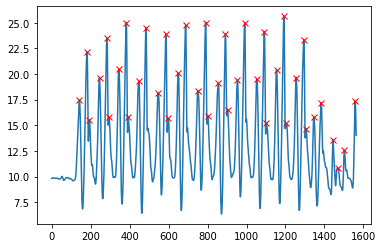

ACC Magn Trial with gait cycle


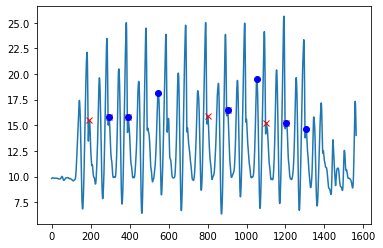

tria2gcycles for i:206
ACC Magn Trial with peaks


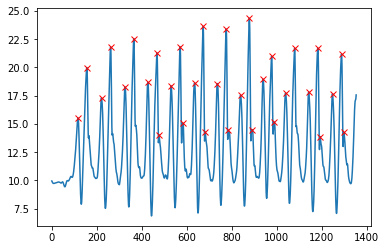

ACC Magn Trial with gait cycle


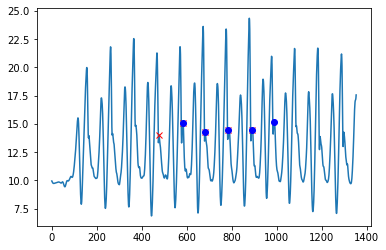

tria2gcycles for i:207
ACC Magn Trial with peaks


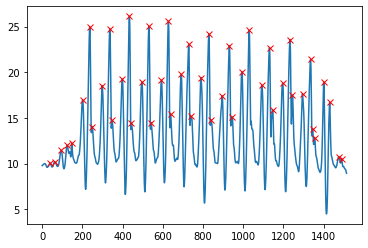

ACC Magn Trial with gait cycle


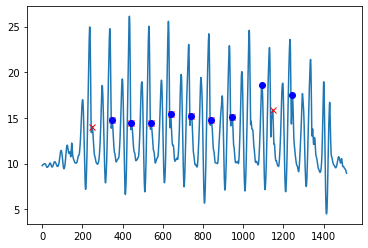

tria2gcycles for i:208
ACC Magn Trial with peaks


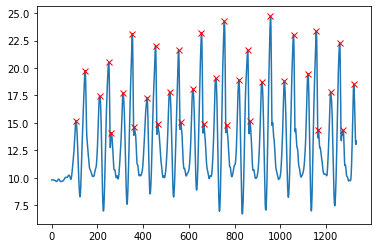

ACC Magn Trial with gait cycle


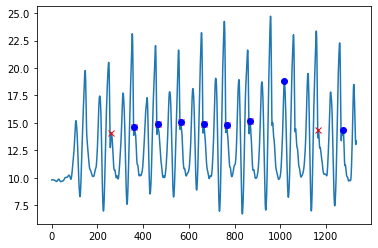

tria2gcycles for i:209
ACC Magn Trial with peaks


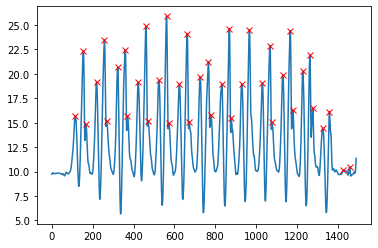

ACC Magn Trial with gait cycle


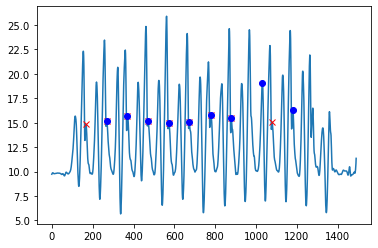

tria2gcycles for i:210
ACC Magn Trial with peaks


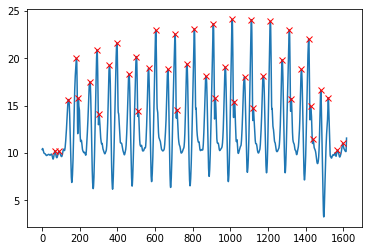

ACC Magn Trial with gait cycle


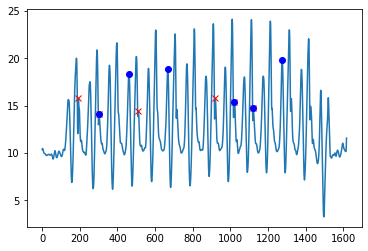

tria2gcycles for i:211
ACC Magn Trial with peaks


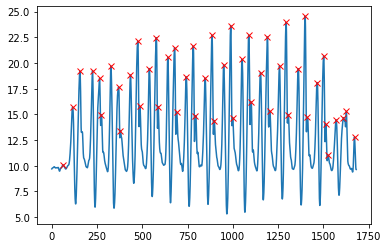

ACC Magn Trial with gait cycle


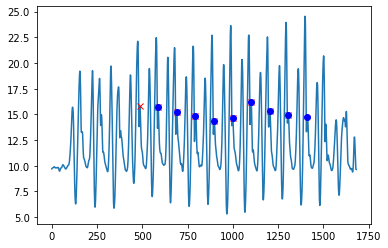

tria2gcycles for i:212
ACC Magn Trial with peaks


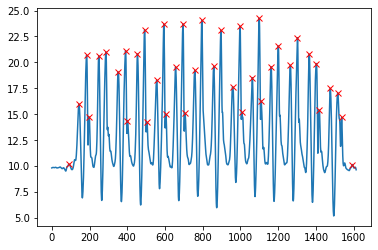

ACC Magn Trial with gait cycle


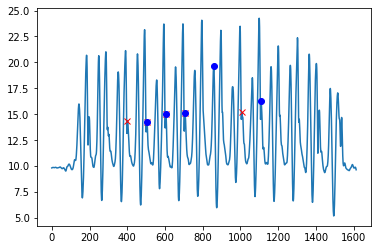

tria2gcycles for i:213
ACC Magn Trial with peaks


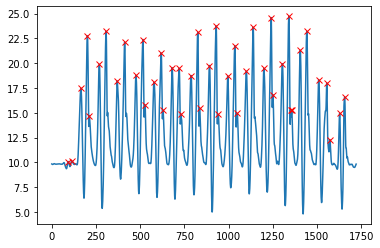

ACC Magn Trial with gait cycle


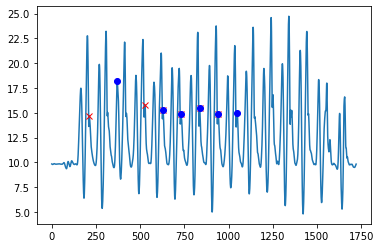

tria2gcycles for i:214
ACC Magn Trial with peaks


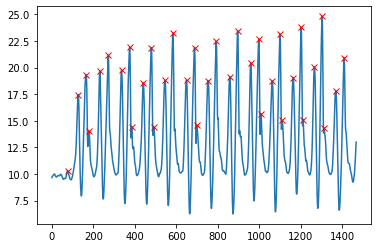

ACC Magn Trial with gait cycle


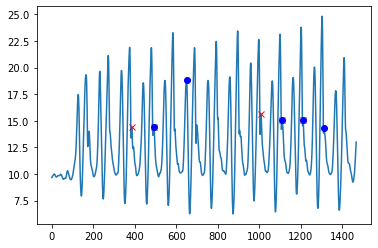

tria2gcycles for i:215
ACC Magn Trial with peaks


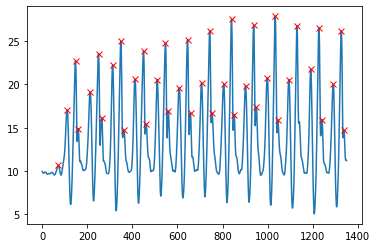

ACC Magn Trial with gait cycle


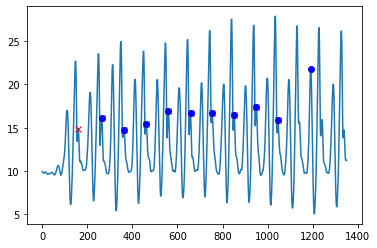

tria2gcycles for i:216
ACC Magn Trial with peaks


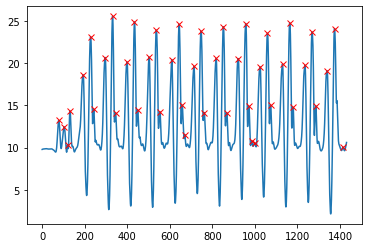

ACC Magn Trial with gait cycle


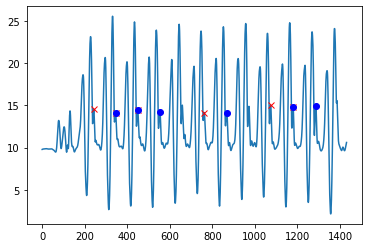

tria2gcycles for i:217
ACC Magn Trial with peaks


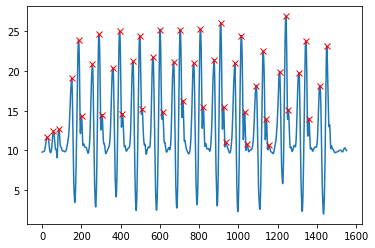

ACC Magn Trial with gait cycle


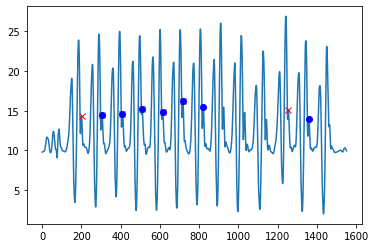

tria2gcycles for i:218
ACC Magn Trial with peaks


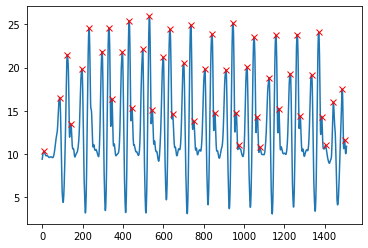

ACC Magn Trial with gait cycle


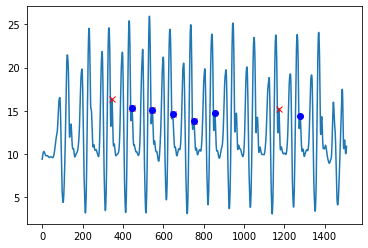

tria2gcycles for i:219
ACC Magn Trial with peaks


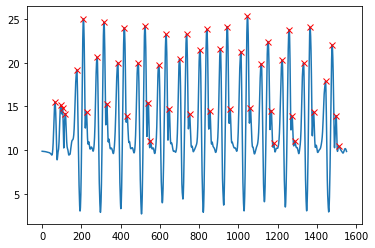

ACC Magn Trial with gait cycle


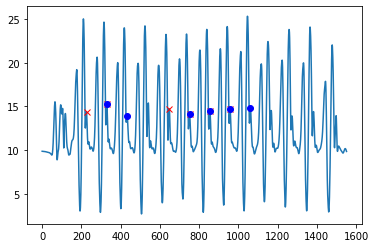

tria2gcycles for i:220
ACC Magn Trial with peaks


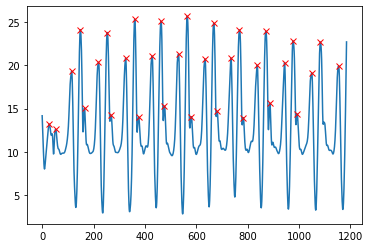

ACC Magn Trial with gait cycle


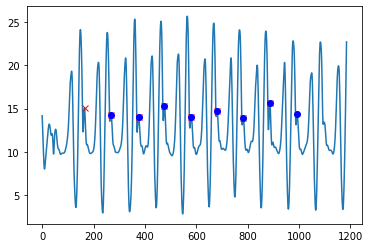

tria2gcycles for i:221
ACC Magn Trial with peaks


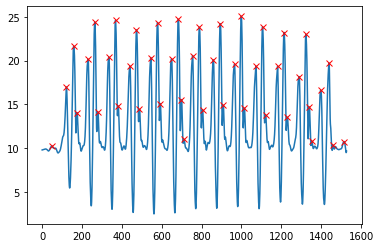

ACC Magn Trial with gait cycle


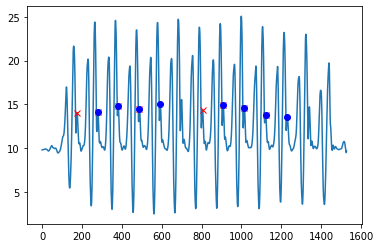

tria2gcycles for i:222
ACC Magn Trial with peaks


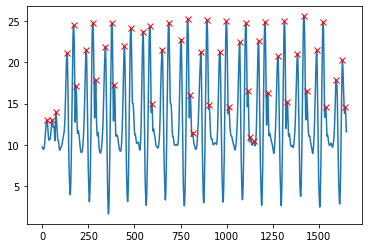

ACC Magn Trial with gait cycle


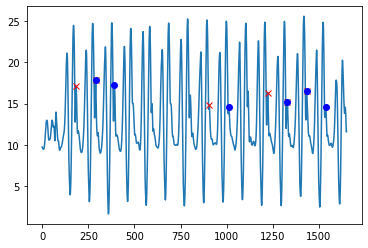

tria2gcycles for i:223
ACC Magn Trial with peaks


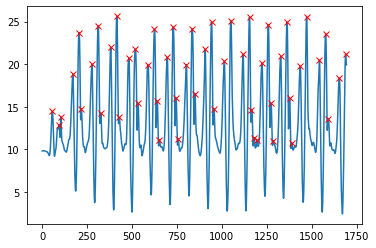

ACC Magn Trial with gait cycle


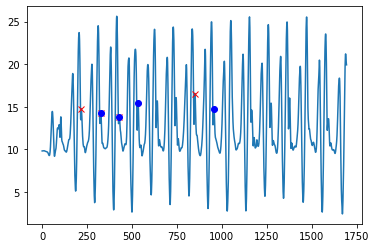

tria2gcycles for i:224
ACC Magn Trial with peaks


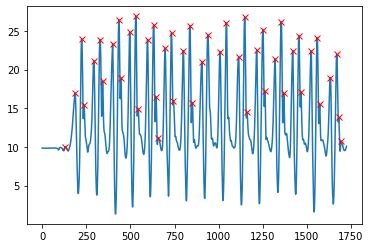

ACC Magn Trial with gait cycle


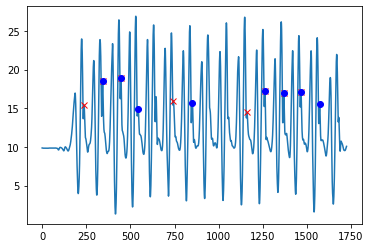

tria2gcycles for i:225
ACC Magn Trial with peaks


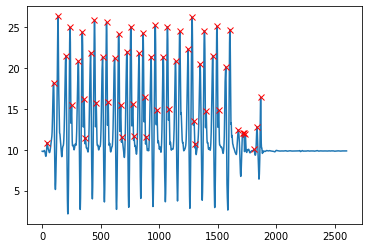

ACC Magn Trial with gait cycle


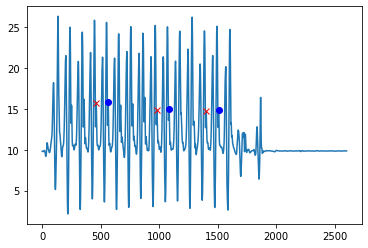

tria2gcycles for i:226
ACC Magn Trial with peaks


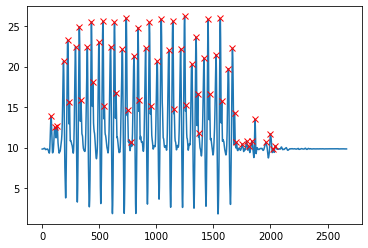

ACC Magn Trial with gait cycle


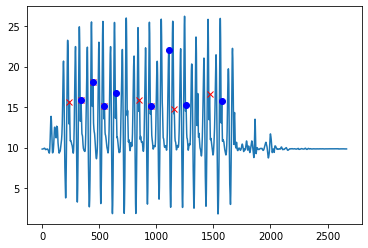

tria2gcycles for i:227
ACC Magn Trial with peaks


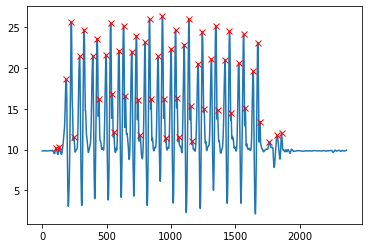

ACC Magn Trial with gait cycle


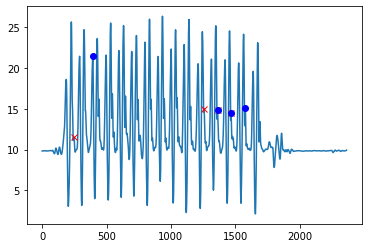

tria2gcycles for i:228
ACC Magn Trial with peaks


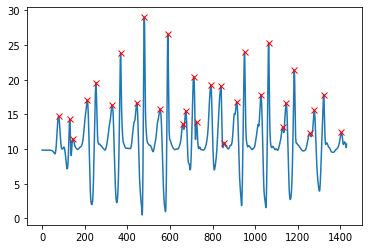

ACC Magn Trial with gait cycle


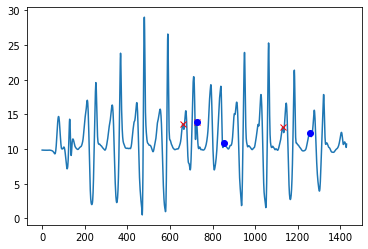

tria2gcycles for i:229
ACC Magn Trial with peaks


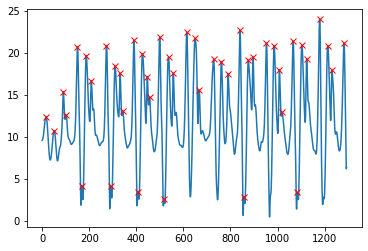

ACC Magn Trial with gait cycle


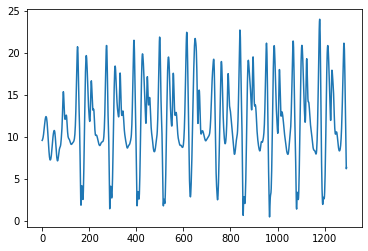

tria2gcycles for i:230
ACC Magn Trial with peaks


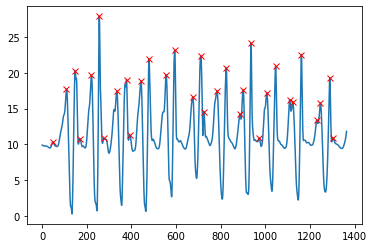

ACC Magn Trial with gait cycle


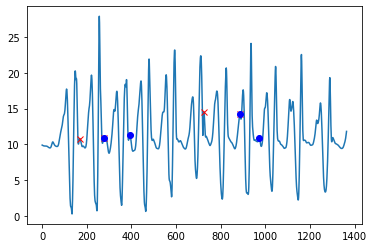

tria2gcycles for i:231
ACC Magn Trial with peaks


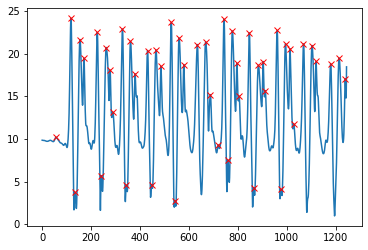

ACC Magn Trial with gait cycle


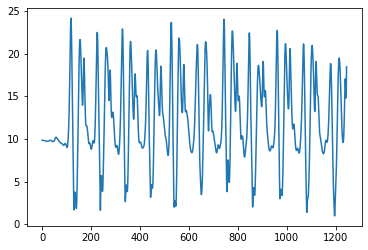

tria2gcycles for i:232
ACC Magn Trial with peaks


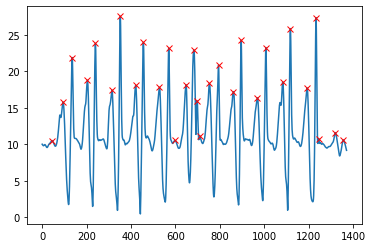

ACC Magn Trial with gait cycle


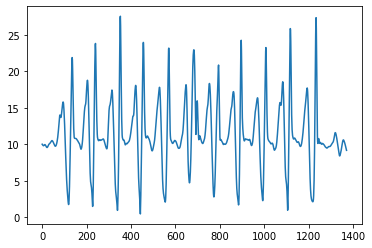

tria2gcycles for i:233
ACC Magn Trial with peaks


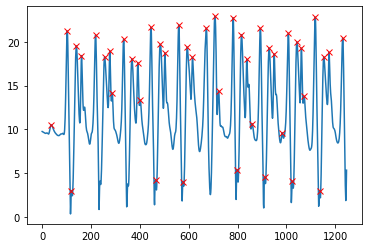

ACC Magn Trial with gait cycle


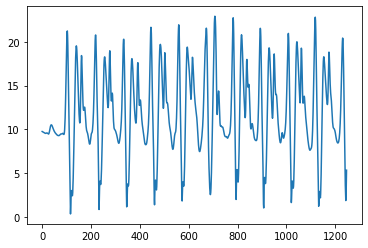

tria2gcycles for i:234
ACC Magn Trial with peaks


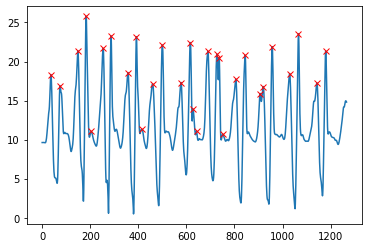

ACC Magn Trial with gait cycle


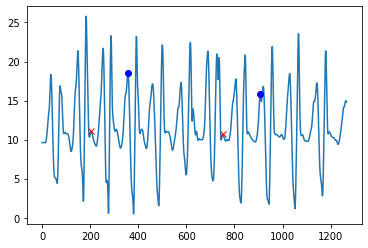

tria2gcycles for i:235
ACC Magn Trial with peaks


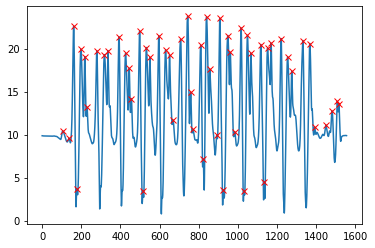

ACC Magn Trial with gait cycle


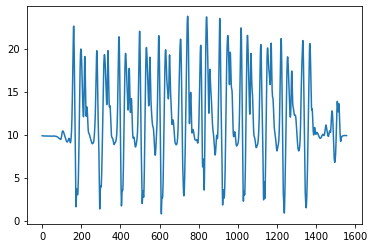

tria2gcycles for i:236
ACC Magn Trial with peaks


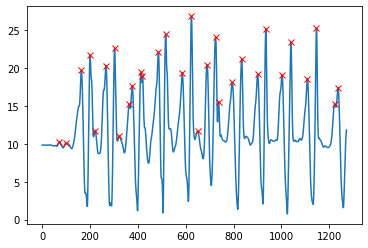

ACC Magn Trial with gait cycle


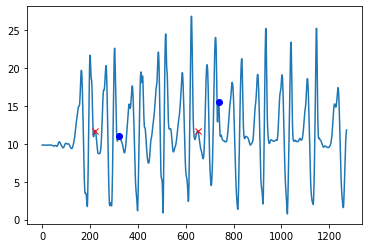

tria2gcycles for i:237
ACC Magn Trial with peaks


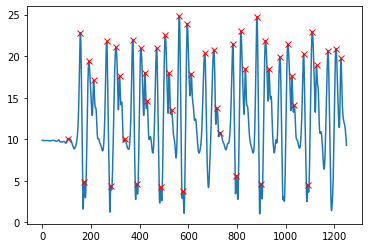

ACC Magn Trial with gait cycle


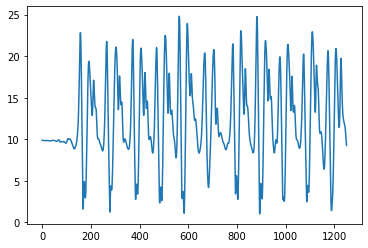

tria2gcycles for i:238
ACC Magn Trial with peaks


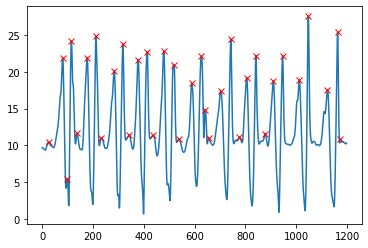

ACC Magn Trial with gait cycle


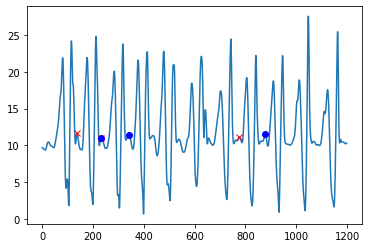

tria2gcycles for i:239
ACC Magn Trial with peaks


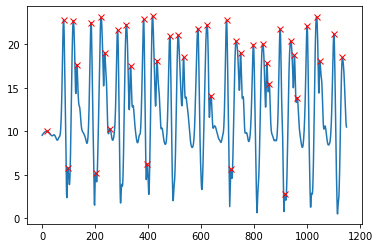

ACC Magn Trial with gait cycle


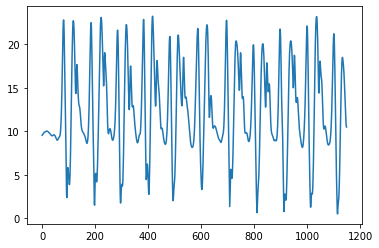

tria2gcycles for i:240
ACC Magn Trial with peaks


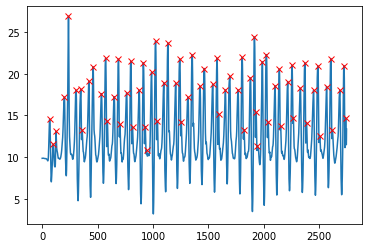

ACC Magn Trial with gait cycle


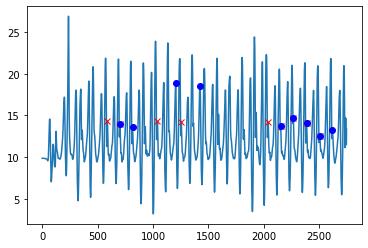

tria2gcycles for i:241
ACC Magn Trial with peaks


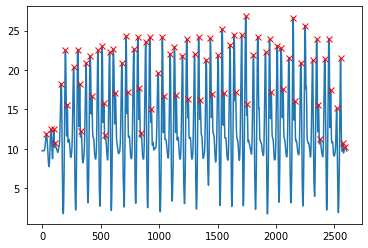

ACC Magn Trial with gait cycle


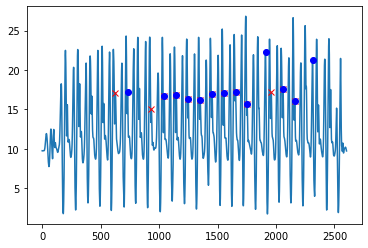

tria2gcycles for i:242
ACC Magn Trial with peaks


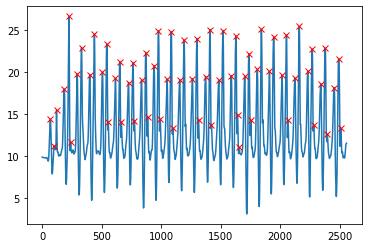

ACC Magn Trial with gait cycle


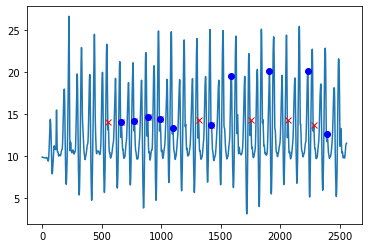

tria2gcycles for i:243
ACC Magn Trial with peaks


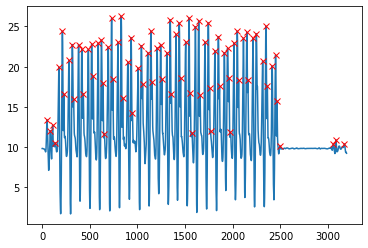

ACC Magn Trial with gait cycle


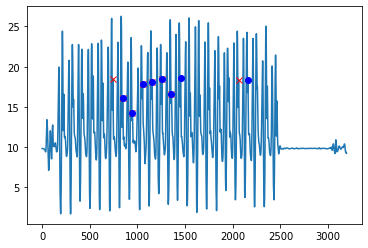

tria2gcycles for i:244
ACC Magn Trial with peaks


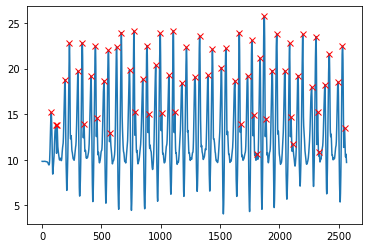

ACC Magn Trial with gait cycle


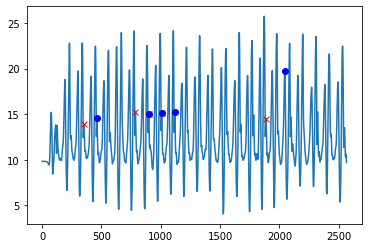

tria2gcycles for i:245
ACC Magn Trial with peaks


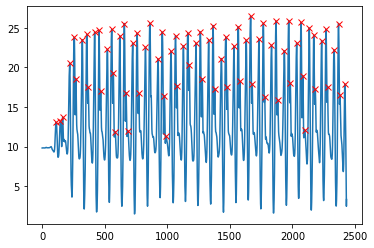

ACC Magn Trial with gait cycle


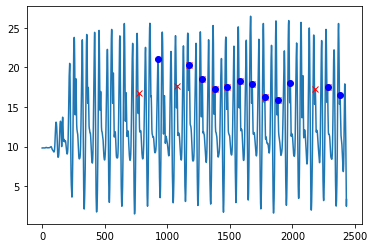

tria2gcycles for i:246
ACC Magn Trial with peaks


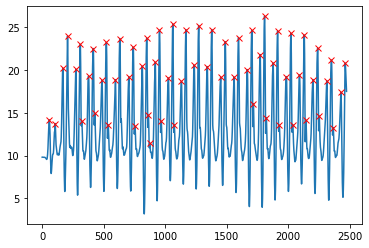

ACC Magn Trial with gait cycle


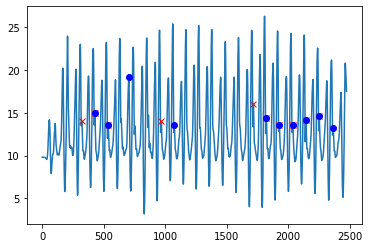

tria2gcycles for i:247
ACC Magn Trial with peaks


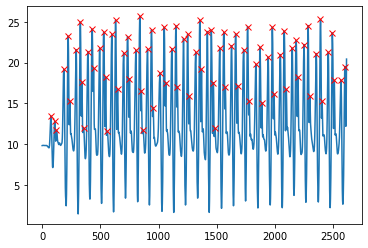

ACC Magn Trial with gait cycle


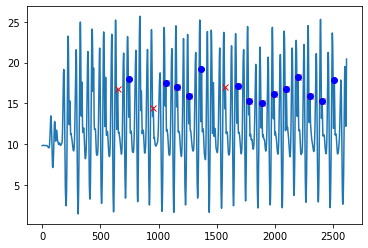

tria2gcycles for i:248
ACC Magn Trial with peaks


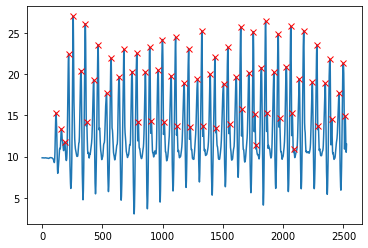

ACC Magn Trial with gait cycle


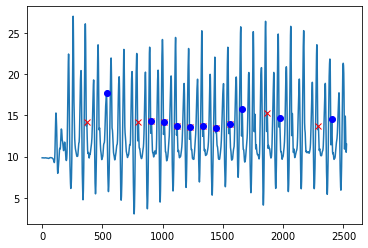

tria2gcycles for i:249
ACC Magn Trial with peaks


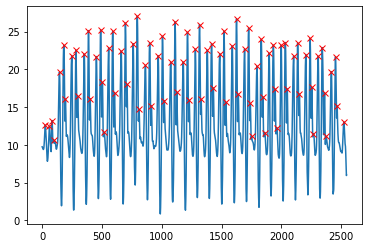

ACC Magn Trial with gait cycle


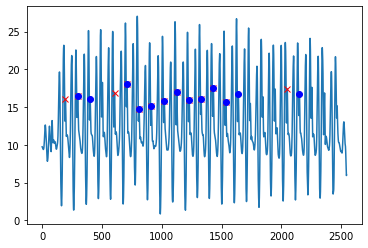

tria2gcycles for i:250
ACC Magn Trial with peaks


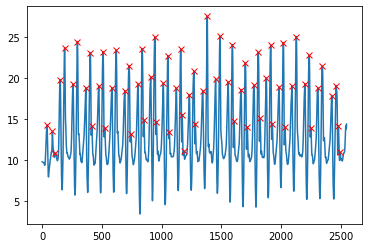

ACC Magn Trial with gait cycle


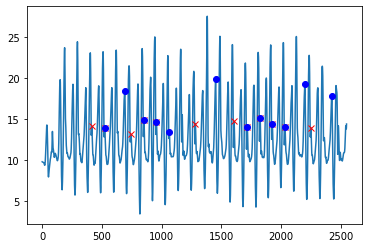

tria2gcycles for i:251
ACC Magn Trial with peaks


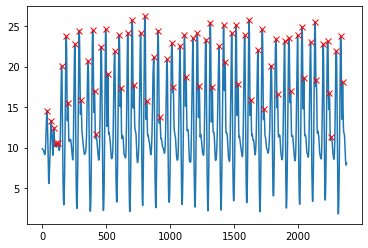

ACC Magn Trial with gait cycle


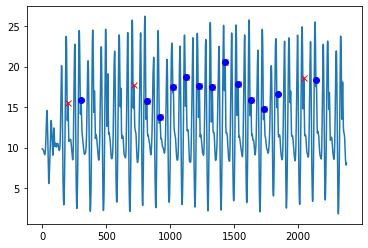

tria2gcycles for i:252
ACC Magn Trial with peaks


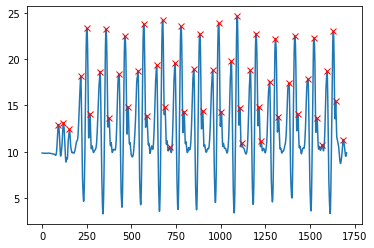

ACC Magn Trial with gait cycle


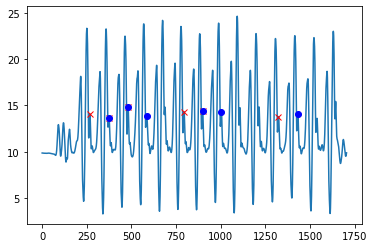

tria2gcycles for i:253
ACC Magn Trial with peaks


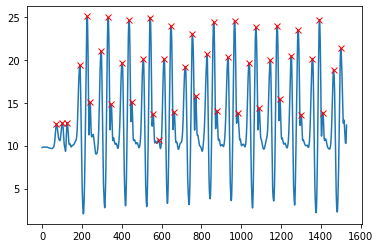

ACC Magn Trial with gait cycle


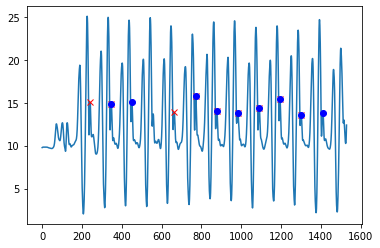

tria2gcycles for i:254
ACC Magn Trial with peaks


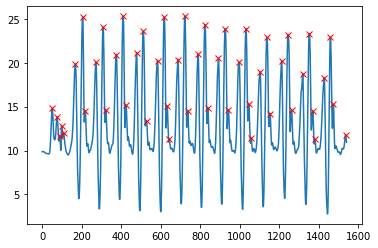

ACC Magn Trial with gait cycle


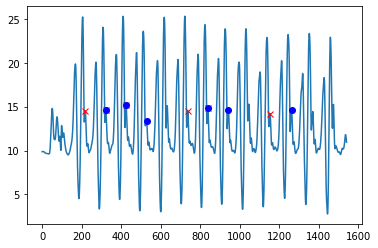

tria2gcycles for i:255
ACC Magn Trial with peaks


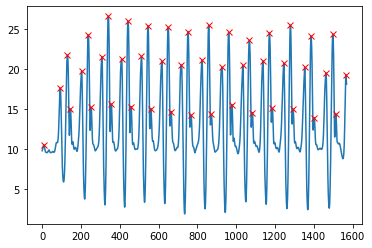

ACC Magn Trial with gait cycle


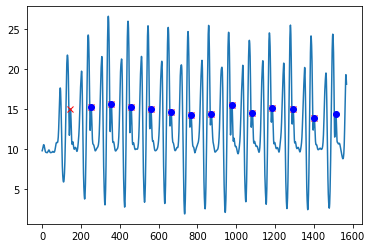

tria2gcycles for i:256
ACC Magn Trial with peaks


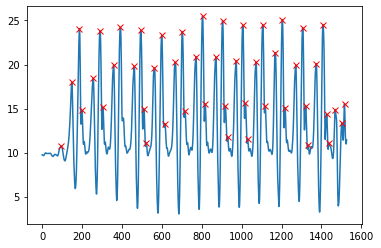

ACC Magn Trial with gait cycle


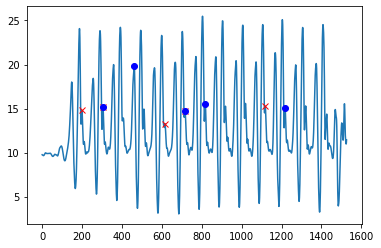

tria2gcycles for i:257
ACC Magn Trial with peaks


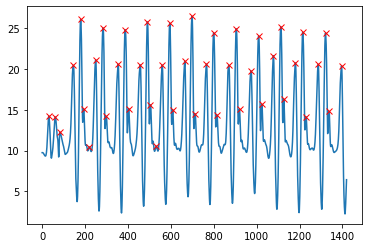

ACC Magn Trial with gait cycle


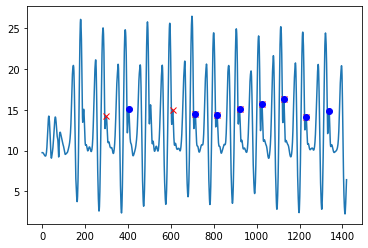

tria2gcycles for i:258
ACC Magn Trial with peaks


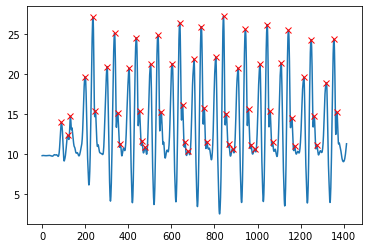

ACC Magn Trial with gait cycle


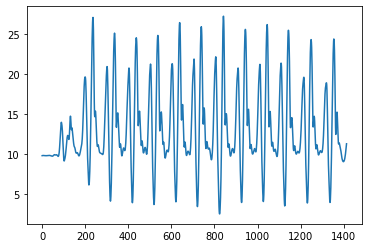

tria2gcycles for i:259
ACC Magn Trial with peaks


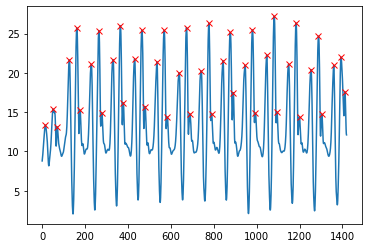

ACC Magn Trial with gait cycle


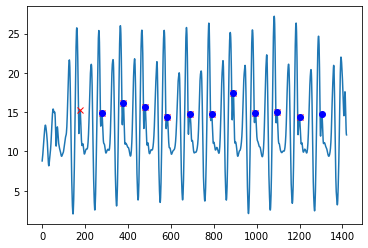

tria2gcycles for i:260
ACC Magn Trial with peaks


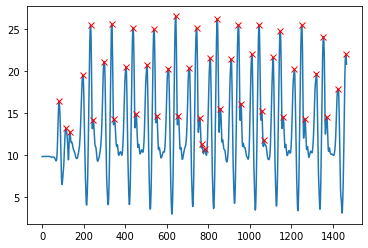

ACC Magn Trial with gait cycle


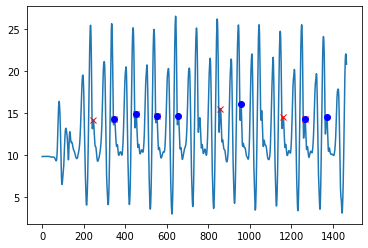

tria2gcycles for i:261
ACC Magn Trial with peaks


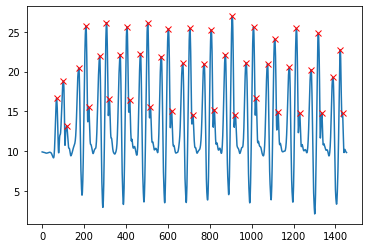

ACC Magn Trial with gait cycle


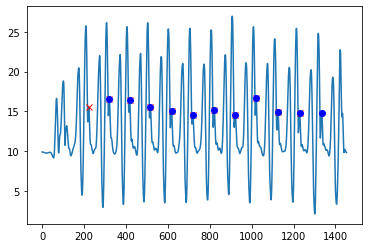

tria2gcycles for i:262
ACC Magn Trial with peaks


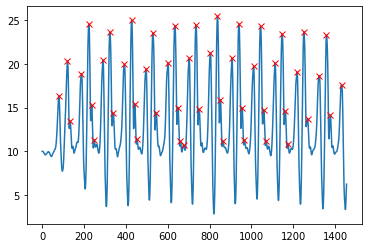

ACC Magn Trial with gait cycle


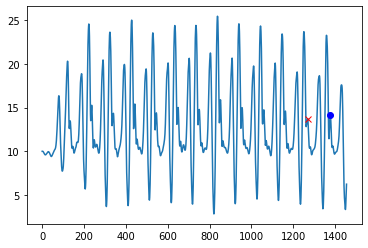

tria2gcycles for i:263
ACC Magn Trial with peaks


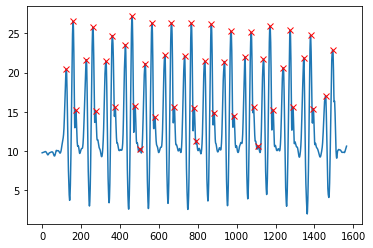

ACC Magn Trial with gait cycle


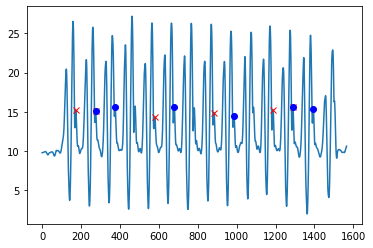

tria2gcycles for i:264
ACC Magn Trial with peaks


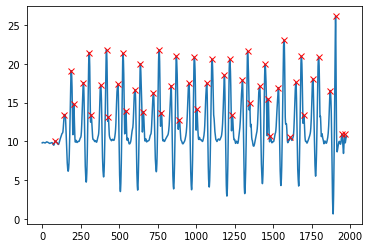

ACC Magn Trial with gait cycle


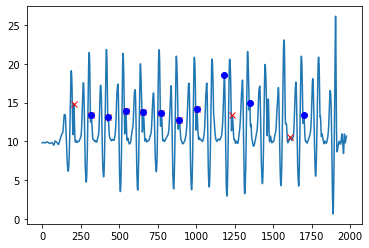

tria2gcycles for i:265
ACC Magn Trial with peaks


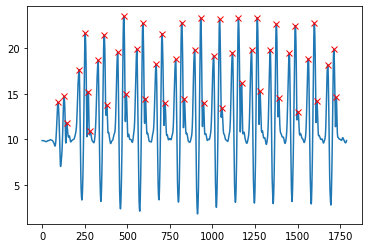

ACC Magn Trial with gait cycle


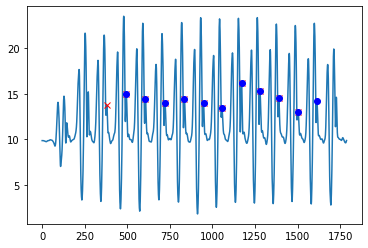

tria2gcycles for i:266
ACC Magn Trial with peaks


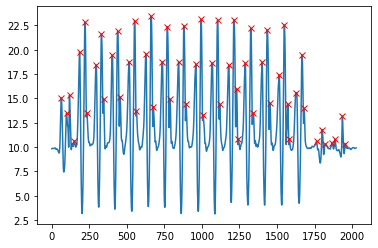

ACC Magn Trial with gait cycle


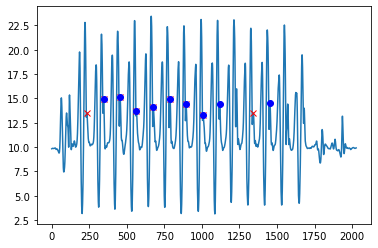

tria2gcycles for i:267
ACC Magn Trial with peaks


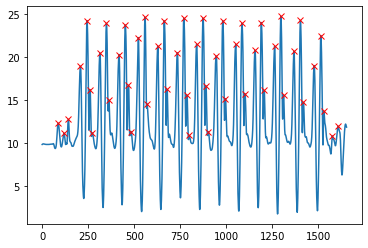

ACC Magn Trial with gait cycle


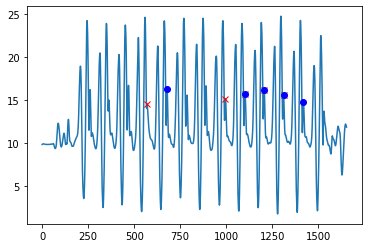

tria2gcycles for i:268
ACC Magn Trial with peaks


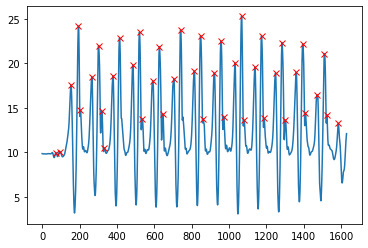

ACC Magn Trial with gait cycle


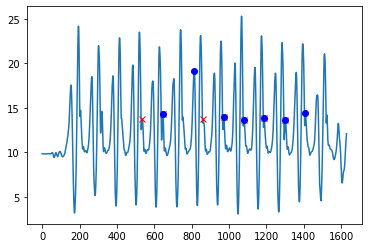

tria2gcycles for i:269
ACC Magn Trial with peaks


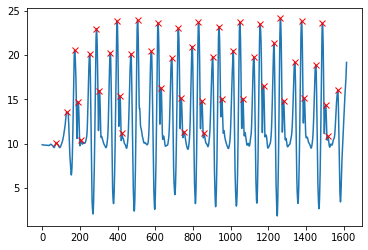

ACC Magn Trial with gait cycle


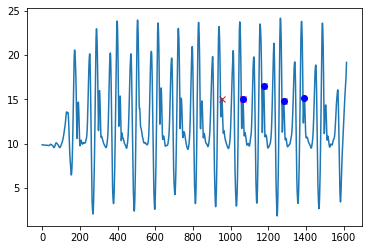

tria2gcycles for i:270
ACC Magn Trial with peaks


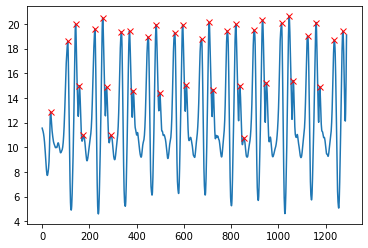

ACC Magn Trial with gait cycle


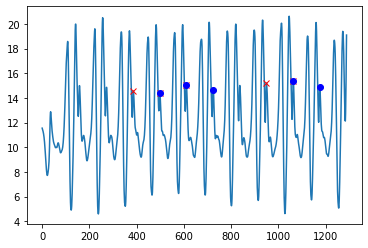

tria2gcycles for i:271
ACC Magn Trial with peaks


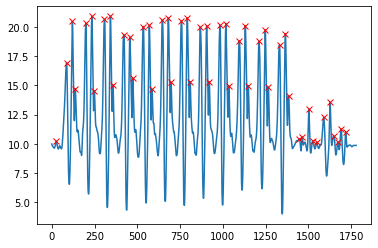

ACC Magn Trial with gait cycle


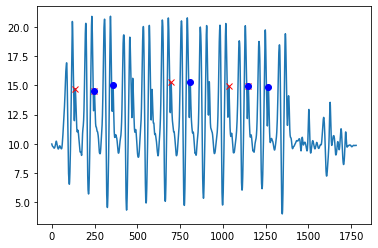

tria2gcycles for i:272
ACC Magn Trial with peaks


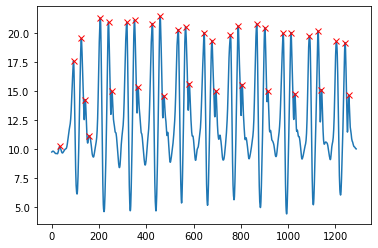

ACC Magn Trial with gait cycle


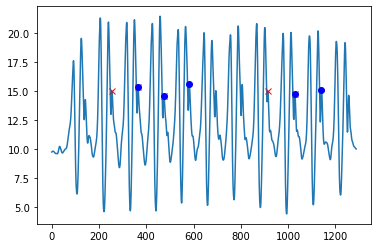

tria2gcycles for i:273
ACC Magn Trial with peaks


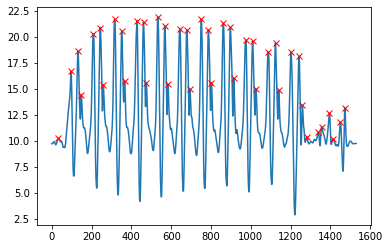

ACC Magn Trial with gait cycle


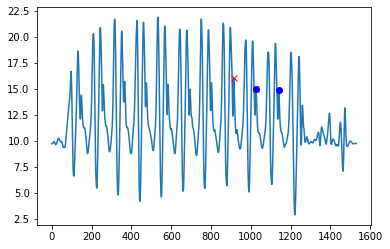

tria2gcycles for i:274
ACC Magn Trial with peaks


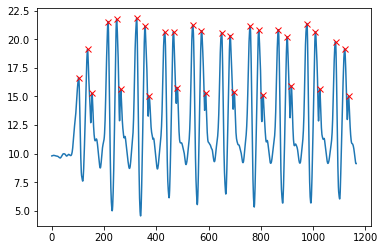

ACC Magn Trial with gait cycle


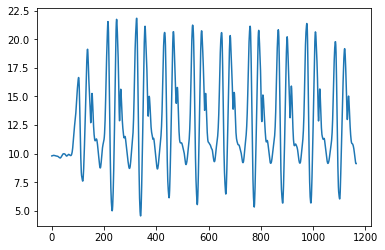

tria2gcycles for i:275
ACC Magn Trial with peaks


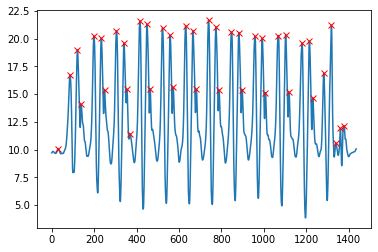

ACC Magn Trial with gait cycle


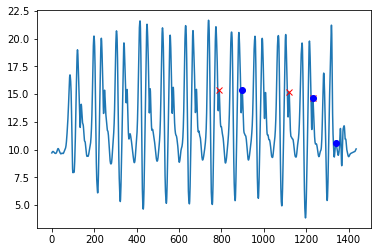

tria2gcycles for i:276
ACC Magn Trial with peaks


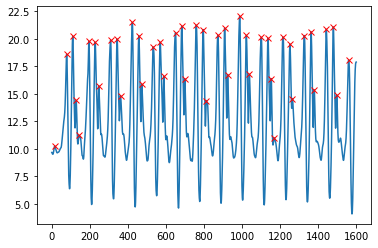

ACC Magn Trial with gait cycle


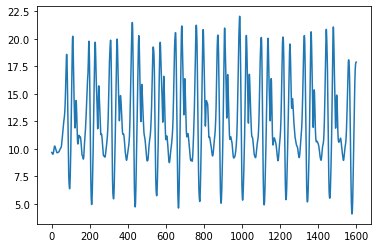

tria2gcycles for i:277
ACC Magn Trial with peaks


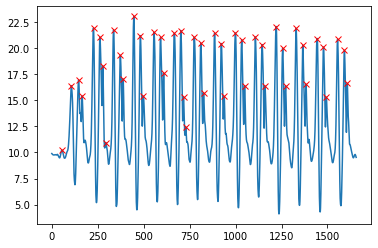

ACC Magn Trial with gait cycle


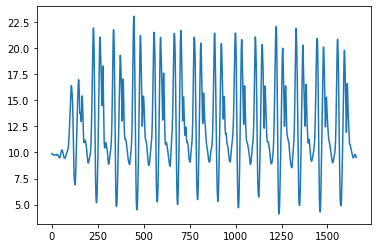

tria2gcycles for i:278
ACC Magn Trial with peaks


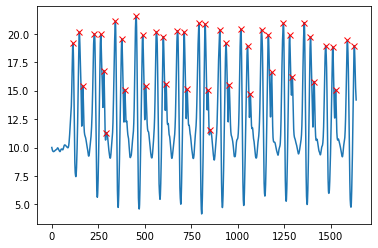

ACC Magn Trial with gait cycle


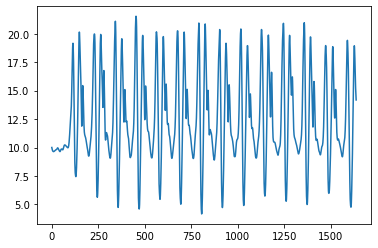

tria2gcycles for i:279
ACC Magn Trial with peaks


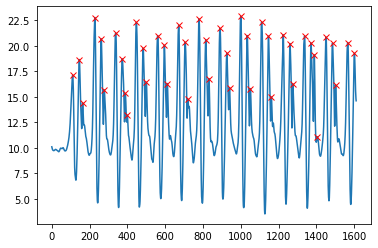

ACC Magn Trial with gait cycle


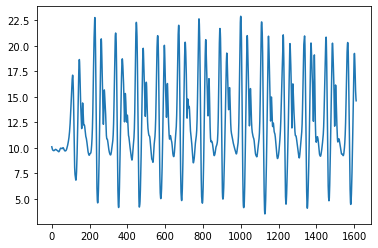

tria2gcycles for i:280
ACC Magn Trial with peaks


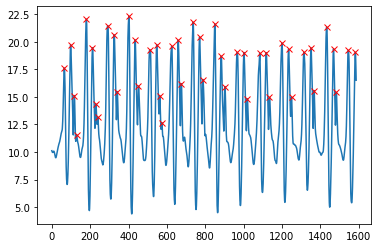

ACC Magn Trial with gait cycle


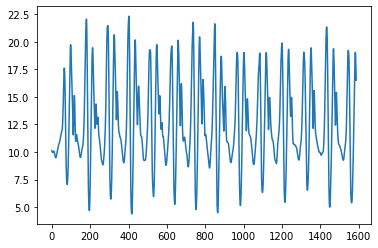

tria2gcycles for i:281
ACC Magn Trial with peaks


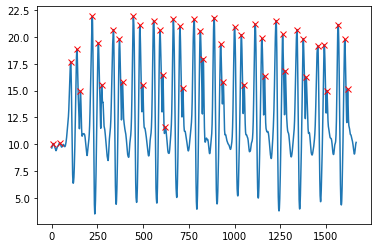

ACC Magn Trial with gait cycle


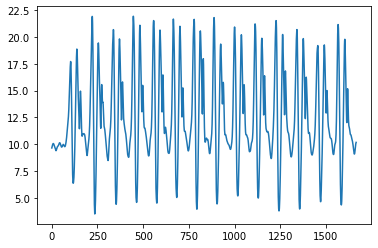

tria2gcycles for i:282
ACC Magn Trial with peaks


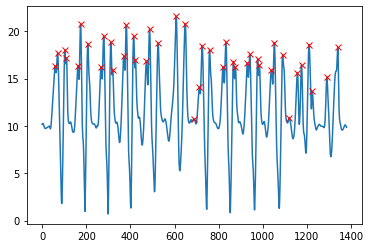

ACC Magn Trial with gait cycle


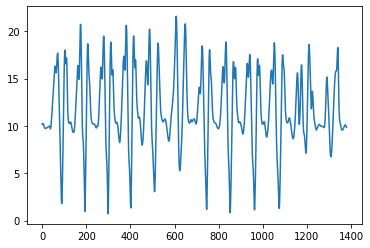

tria2gcycles for i:283
ACC Magn Trial with peaks


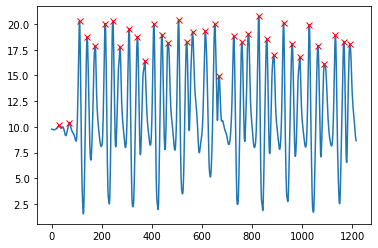

ACC Magn Trial with gait cycle


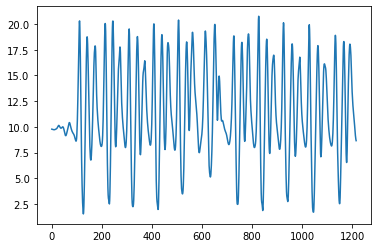

tria2gcycles for i:284
ACC Magn Trial with peaks


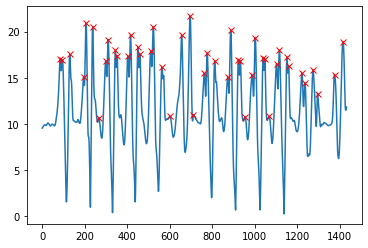

ACC Magn Trial with gait cycle


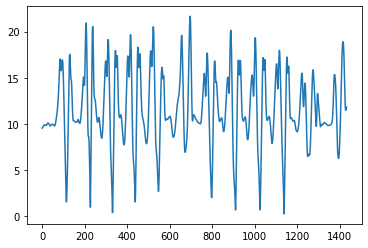

tria2gcycles for i:285
ACC Magn Trial with peaks


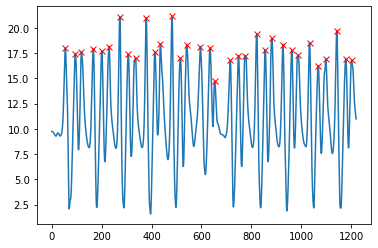

ACC Magn Trial with gait cycle


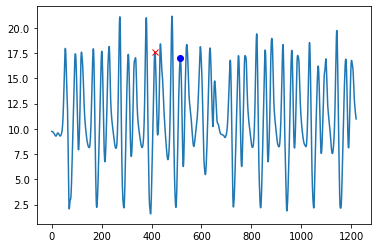

tria2gcycles for i:286
ACC Magn Trial with peaks


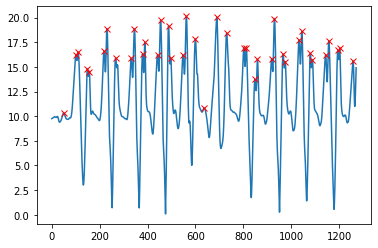

ACC Magn Trial with gait cycle


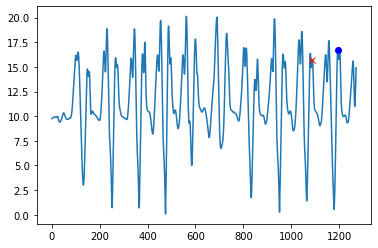

tria2gcycles for i:287
ACC Magn Trial with peaks


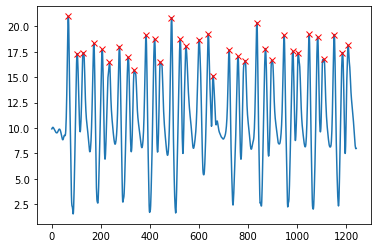

ACC Magn Trial with gait cycle


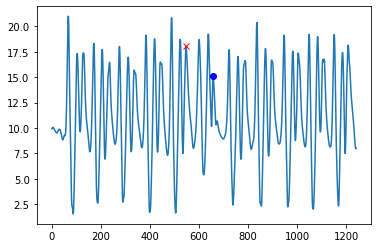

tria2gcycles for i:288
ACC Magn Trial with peaks


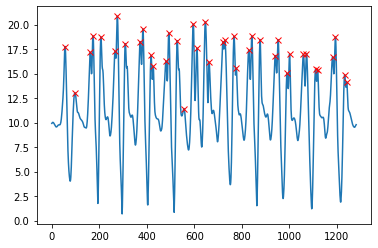

ACC Magn Trial with gait cycle


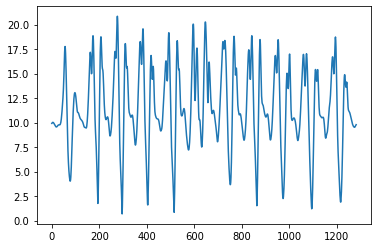

tria2gcycles for i:289
ACC Magn Trial with peaks


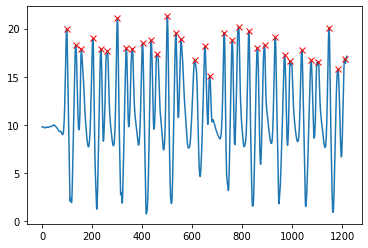

ACC Magn Trial with gait cycle


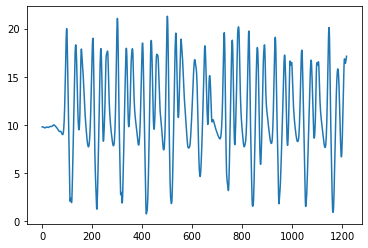

tria2gcycles for i:290
ACC Magn Trial with peaks


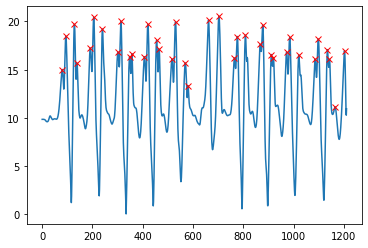

ACC Magn Trial with gait cycle


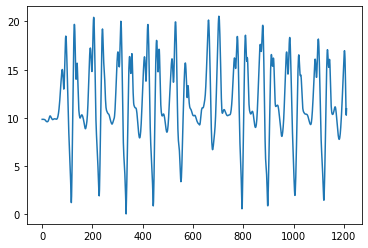

tria2gcycles for i:291
ACC Magn Trial with peaks


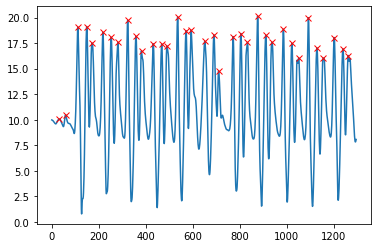

ACC Magn Trial with gait cycle


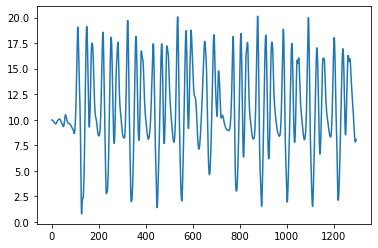

tria2gcycles for i:292
ACC Magn Trial with peaks


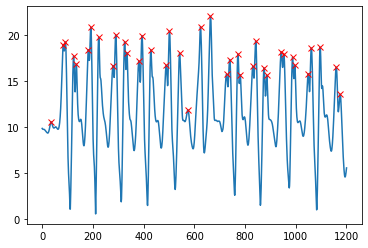

ACC Magn Trial with gait cycle


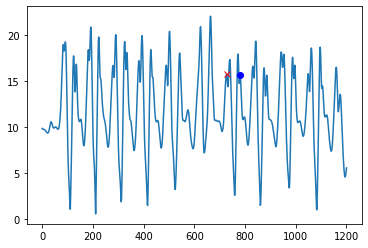

tria2gcycles for i:293
ACC Magn Trial with peaks


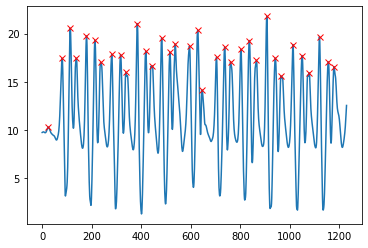

ACC Magn Trial with gait cycle


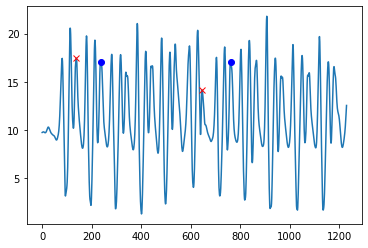

tria2gcycles for i:294
ACC Magn Trial with peaks


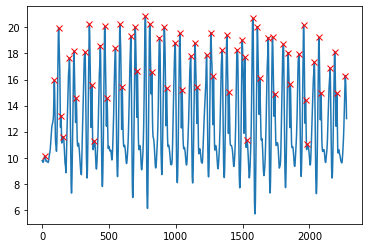

ACC Magn Trial with gait cycle


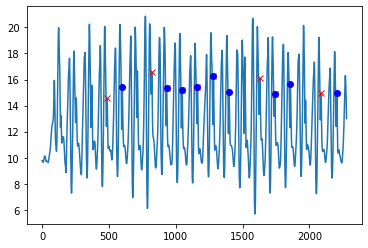

tria2gcycles for i:295
ACC Magn Trial with peaks


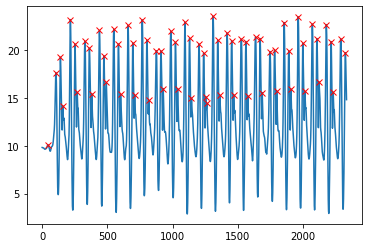

ACC Magn Trial with gait cycle


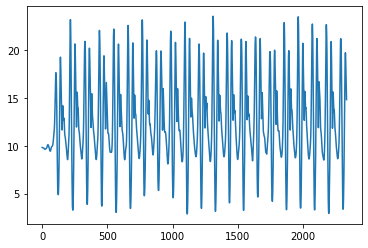

tria2gcycles for i:296
ACC Magn Trial with peaks


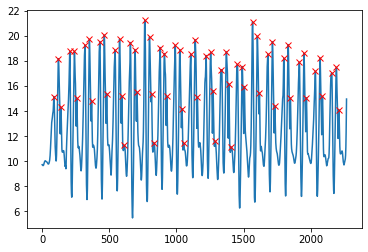

ACC Magn Trial with gait cycle


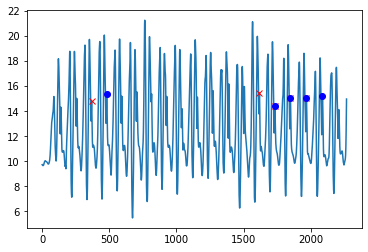

tria2gcycles for i:297
ACC Magn Trial with peaks


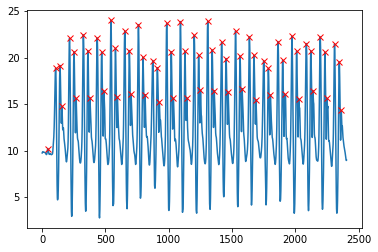

ACC Magn Trial with gait cycle


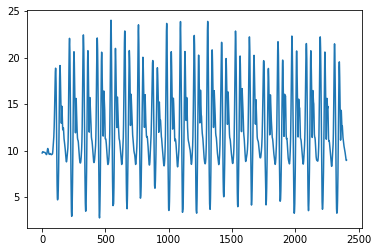

tria2gcycles for i:298
ACC Magn Trial with peaks


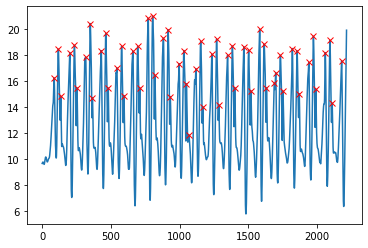

ACC Magn Trial with gait cycle


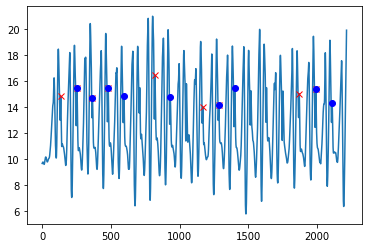

tria2gcycles for i:299
ACC Magn Trial with peaks


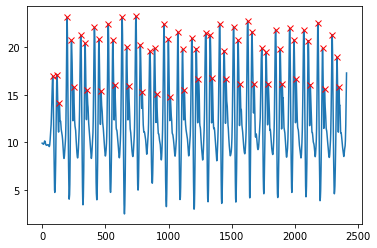

ACC Magn Trial with gait cycle


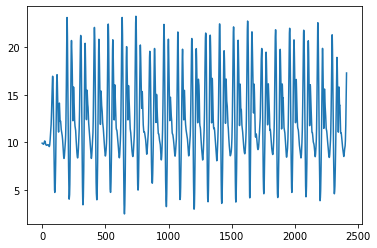

tria2gcycles for i:300
ACC Magn Trial with peaks


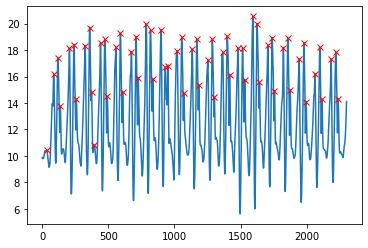

ACC Magn Trial with gait cycle


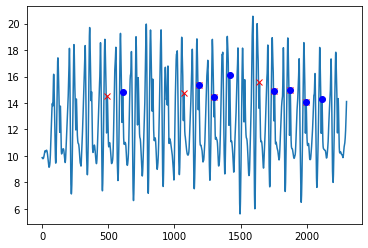

tria2gcycles for i:301
ACC Magn Trial with peaks


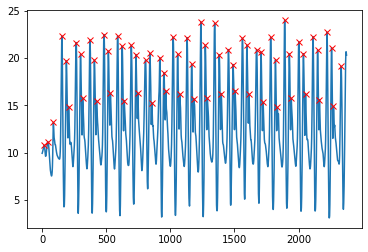

ACC Magn Trial with gait cycle


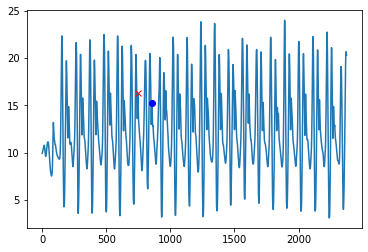

tria2gcycles for i:302
ACC Magn Trial with peaks


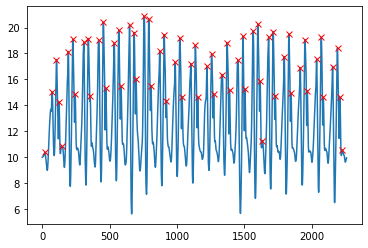

ACC Magn Trial with gait cycle


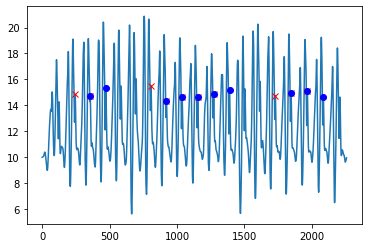

tria2gcycles for i:303
ACC Magn Trial with peaks


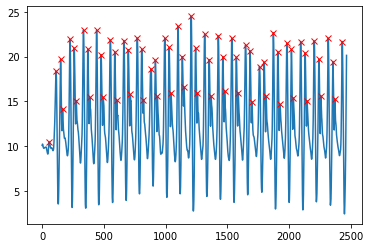

ACC Magn Trial with gait cycle


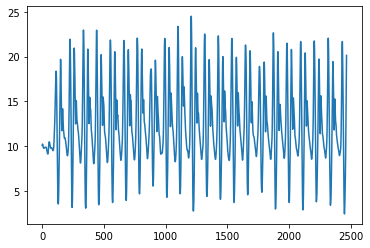

tria2gcycles for i:304
ACC Magn Trial with peaks


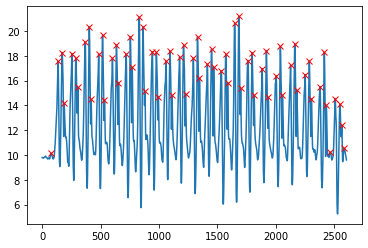

ACC Magn Trial with gait cycle


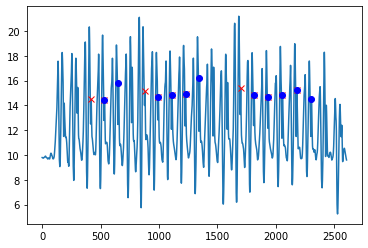

tria2gcycles for i:305
ACC Magn Trial with peaks


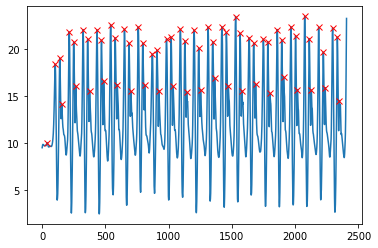

ACC Magn Trial with gait cycle


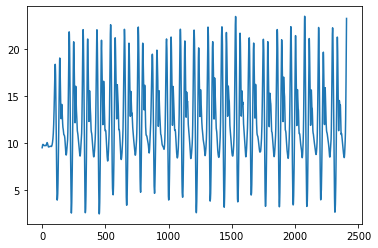

tria2gcycles for i:306
ACC Magn Trial with peaks


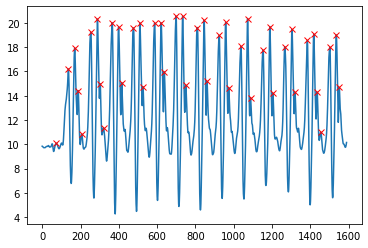

ACC Magn Trial with gait cycle


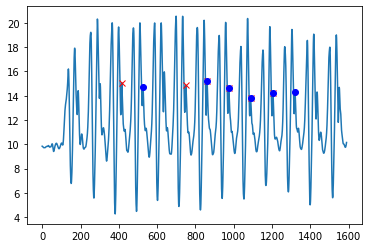

tria2gcycles for i:307
ACC Magn Trial with peaks


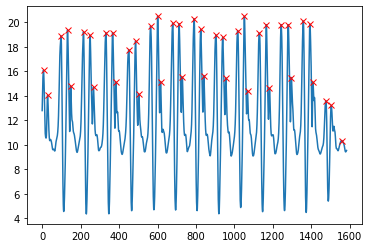

ACC Magn Trial with gait cycle


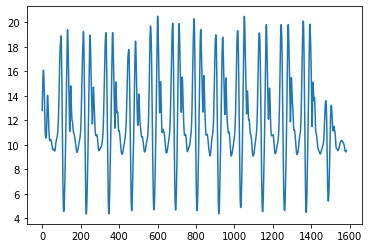

tria2gcycles for i:308
ACC Magn Trial with peaks


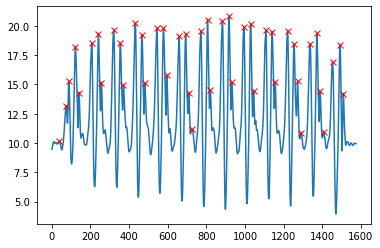

ACC Magn Trial with gait cycle


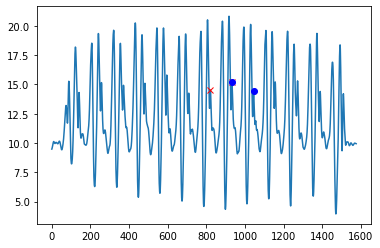

tria2gcycles for i:309
ACC Magn Trial with peaks


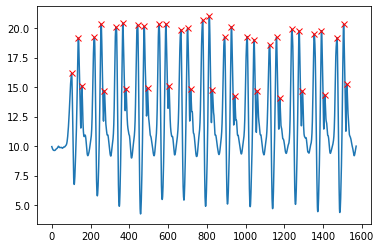

ACC Magn Trial with gait cycle


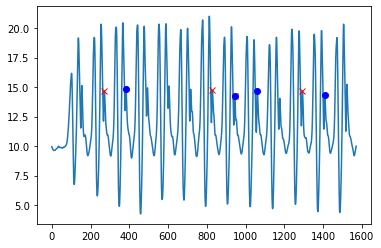

tria2gcycles for i:310
ACC Magn Trial with peaks


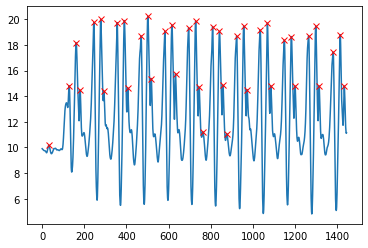

ACC Magn Trial with gait cycle


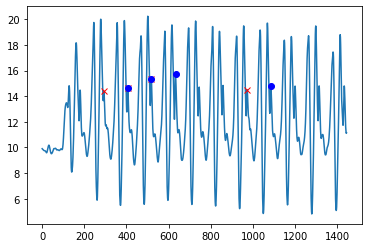

tria2gcycles for i:311
ACC Magn Trial with peaks


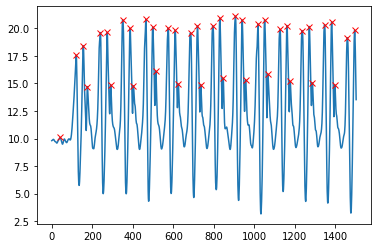

ACC Magn Trial with gait cycle


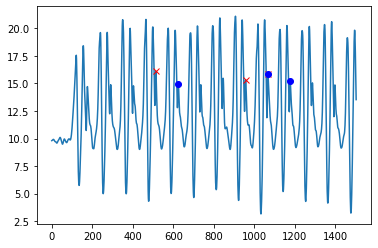

tria2gcycles for i:312
ACC Magn Trial with peaks


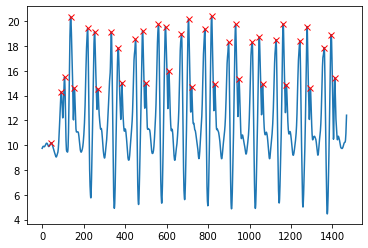

ACC Magn Trial with gait cycle


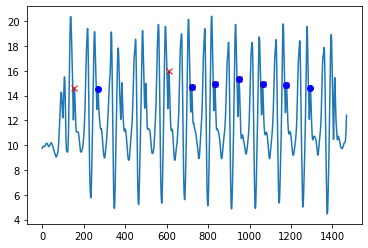

tria2gcycles for i:313
ACC Magn Trial with peaks


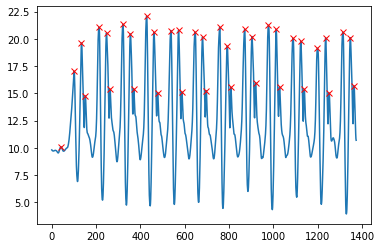

ACC Magn Trial with gait cycle


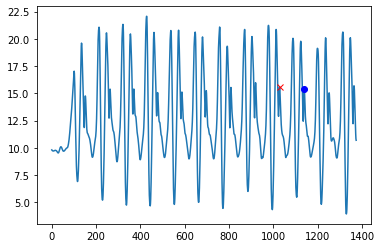

tria2gcycles for i:314
ACC Magn Trial with peaks


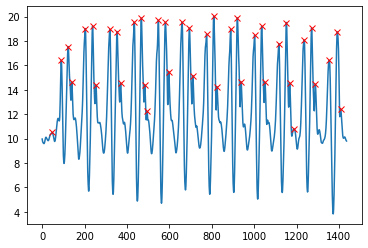

ACC Magn Trial with gait cycle


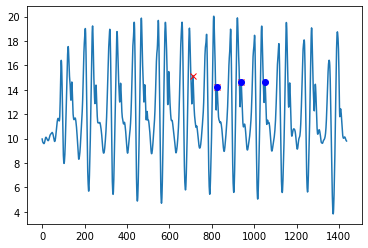

tria2gcycles for i:315
ACC Magn Trial with peaks


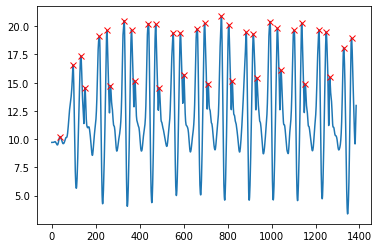

ACC Magn Trial with gait cycle


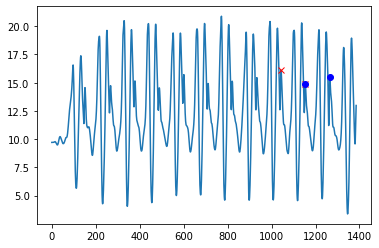

tria2gcycles for i:316
ACC Magn Trial with peaks


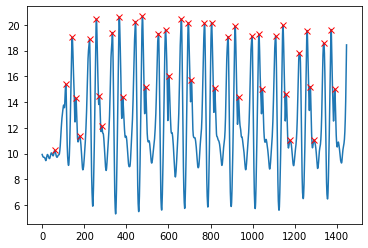

ACC Magn Trial with gait cycle


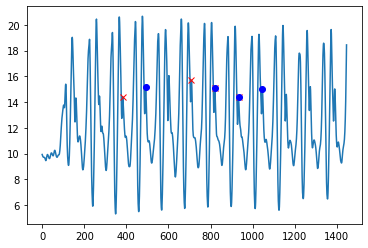

tria2gcycles for i:317
ACC Magn Trial with peaks


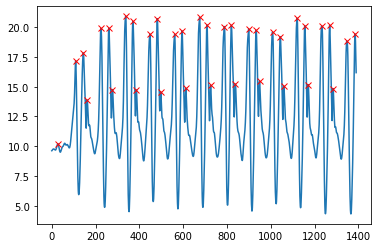

ACC Magn Trial with gait cycle


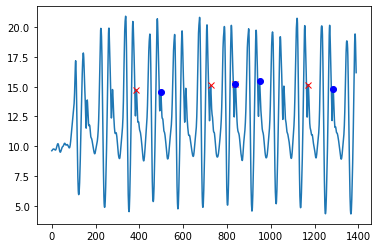

tria2gcycles for i:318
ACC Magn Trial with peaks


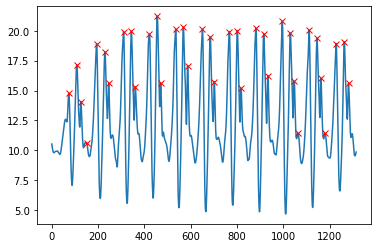

ACC Magn Trial with gait cycle


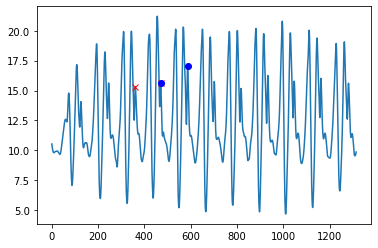

tria2gcycles for i:319
ACC Magn Trial with peaks


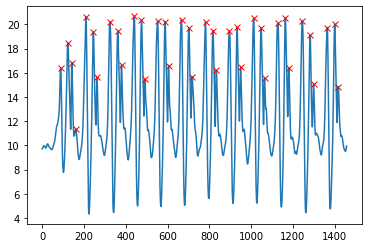

ACC Magn Trial with gait cycle


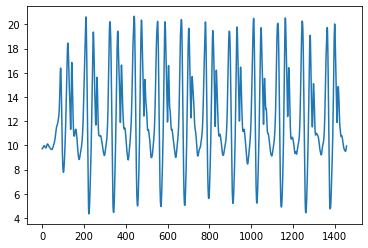

tria2gcycles for i:320
ACC Magn Trial with peaks


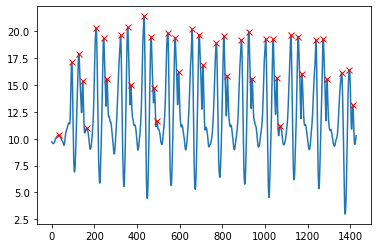

ACC Magn Trial with gait cycle


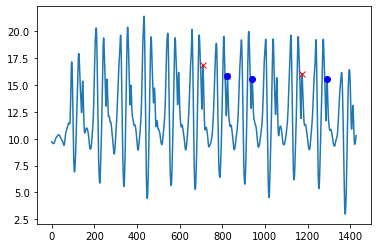

tria2gcycles for i:321
ACC Magn Trial with peaks


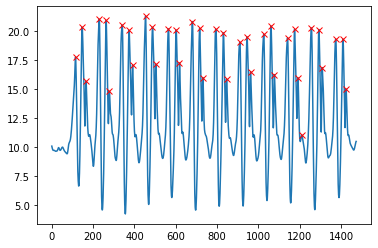

ACC Magn Trial with gait cycle


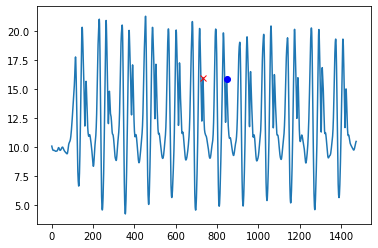

tria2gcycles for i:322
ACC Magn Trial with peaks


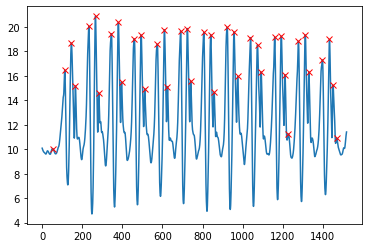

ACC Magn Trial with gait cycle


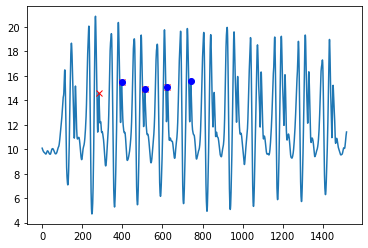

tria2gcycles for i:323
ACC Magn Trial with peaks


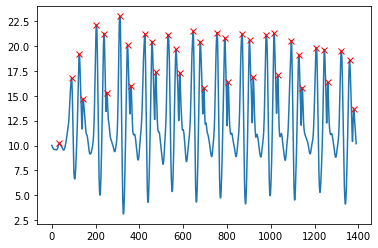

ACC Magn Trial with gait cycle


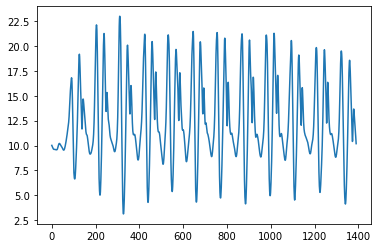

tria2gcycles for i:324
ACC Magn Trial with peaks


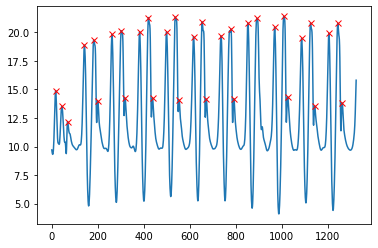

ACC Magn Trial with gait cycle


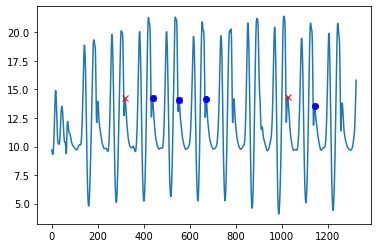

tria2gcycles for i:325
ACC Magn Trial with peaks


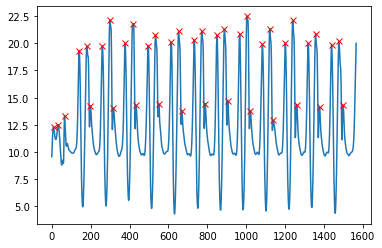

ACC Magn Trial with gait cycle


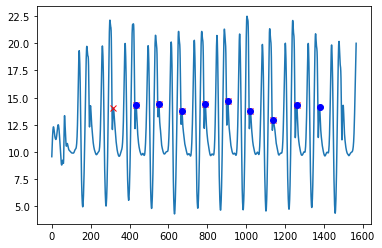

tria2gcycles for i:326
ACC Magn Trial with peaks


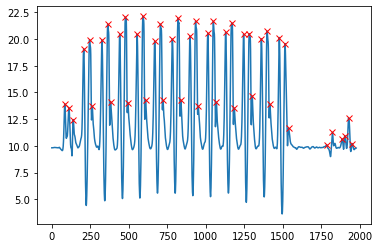

ACC Magn Trial with gait cycle


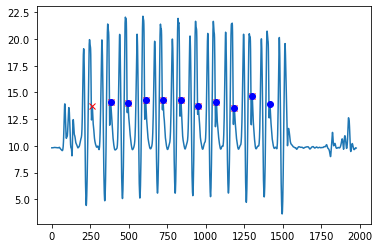

tria2gcycles for i:327
ACC Magn Trial with peaks


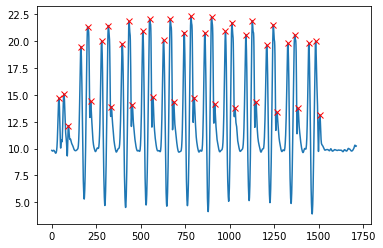

ACC Magn Trial with gait cycle


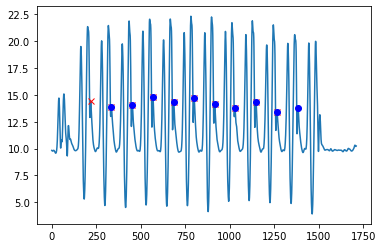

tria2gcycles for i:328
ACC Magn Trial with peaks


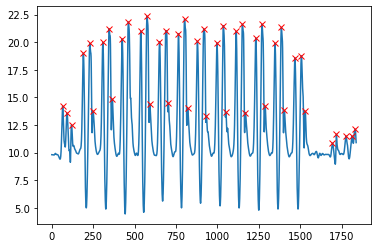

ACC Magn Trial with gait cycle


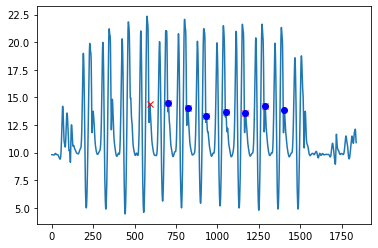

tria2gcycles for i:329
ACC Magn Trial with peaks


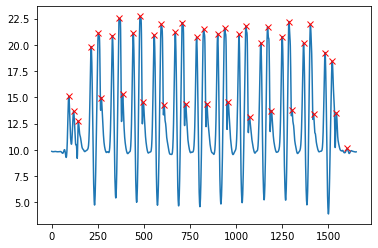

ACC Magn Trial with gait cycle


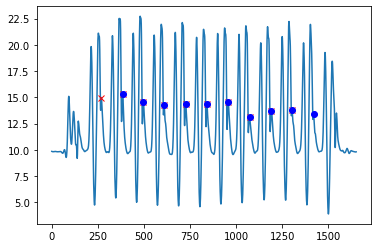

tria2gcycles for i:330
ACC Magn Trial with peaks


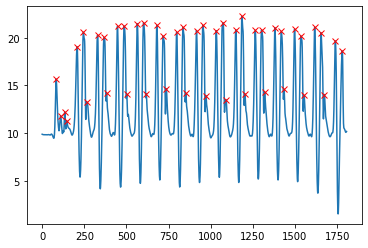

ACC Magn Trial with gait cycle


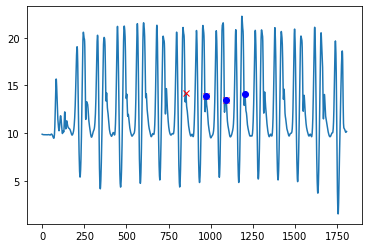

tria2gcycles for i:331
ACC Magn Trial with peaks


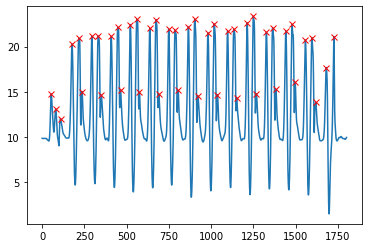

ACC Magn Trial with gait cycle


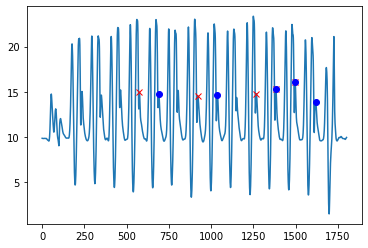

tria2gcycles for i:332
ACC Magn Trial with peaks


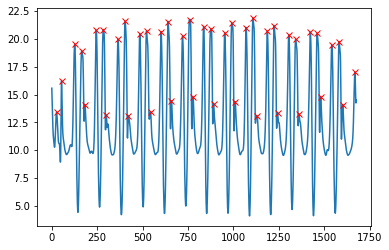

ACC Magn Trial with gait cycle


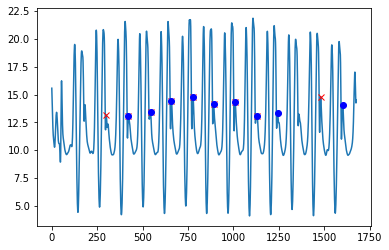

tria2gcycles for i:333
ACC Magn Trial with peaks


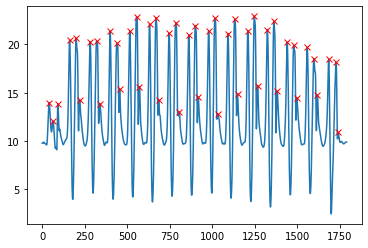

ACC Magn Trial with gait cycle


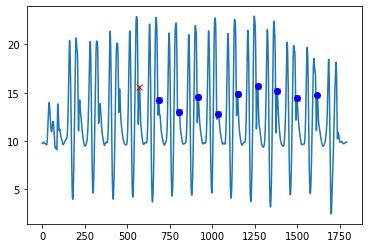

tria2gcycles for i:334
ACC Magn Trial with peaks


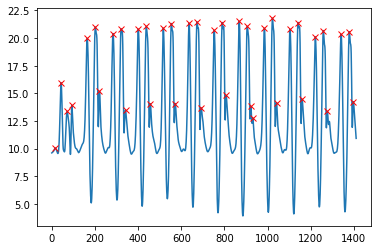

ACC Magn Trial with gait cycle


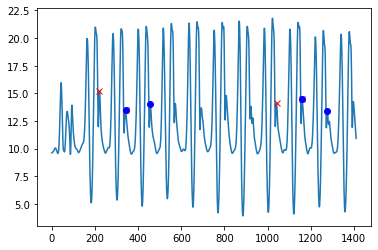

tria2gcycles for i:335
ACC Magn Trial with peaks


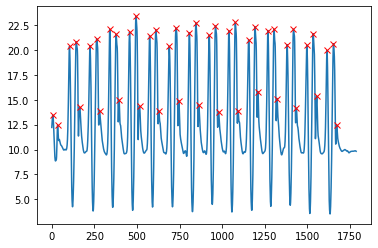

ACC Magn Trial with gait cycle


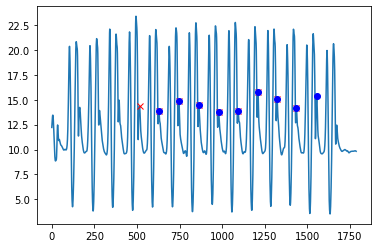

tria2gcycles for i:336
ACC Magn Trial with peaks


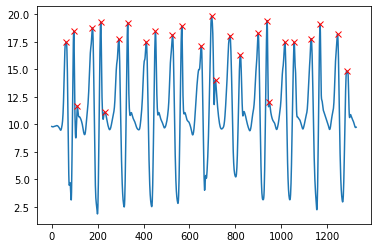

ACC Magn Trial with gait cycle


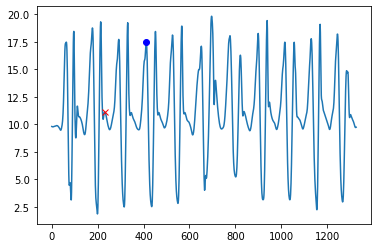

tria2gcycles for i:337
ACC Magn Trial with peaks


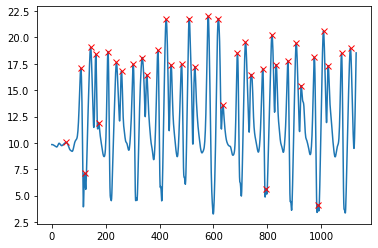

ACC Magn Trial with gait cycle


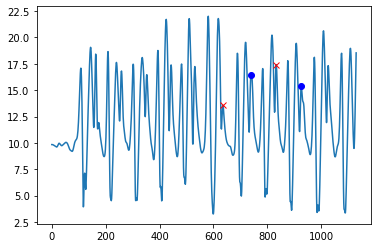

tria2gcycles for i:338
ACC Magn Trial with peaks


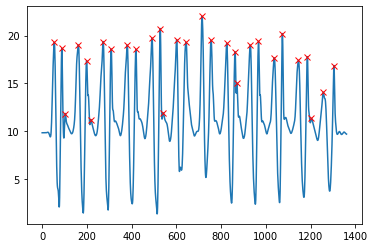

ACC Magn Trial with gait cycle


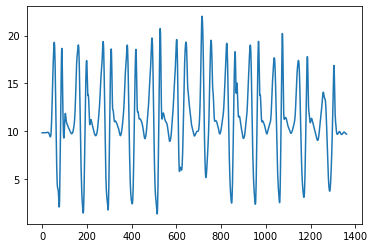

tria2gcycles for i:339
ACC Magn Trial with peaks


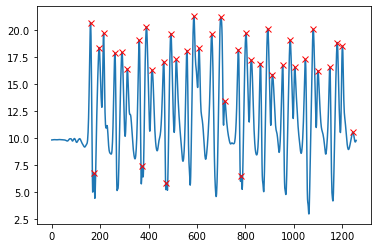

ACC Magn Trial with gait cycle


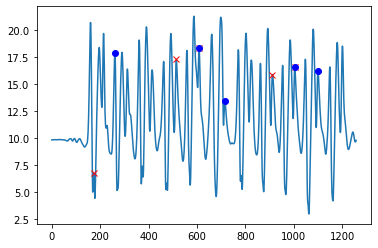

tria2gcycles for i:340
ACC Magn Trial with peaks


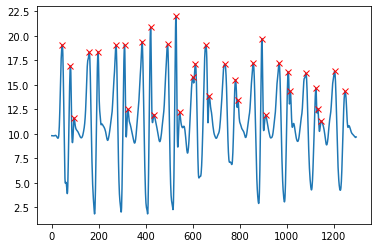

ACC Magn Trial with gait cycle


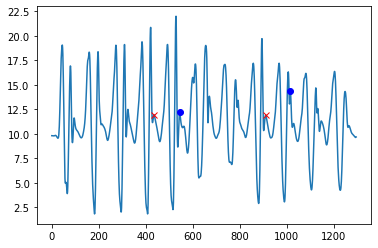

tria2gcycles for i:341
ACC Magn Trial with peaks


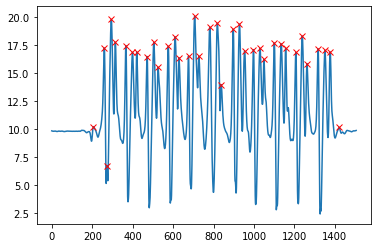

ACC Magn Trial with gait cycle


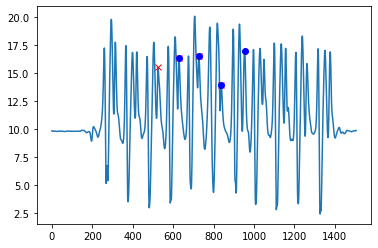

tria2gcycles for i:342
ACC Magn Trial with peaks


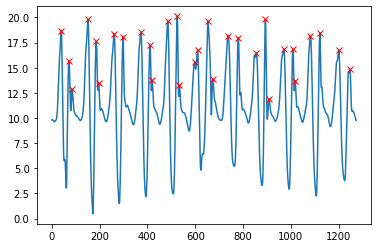

ACC Magn Trial with gait cycle


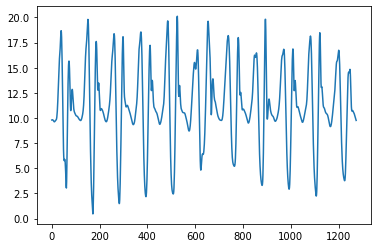

tria2gcycles for i:343
ACC Magn Trial with peaks


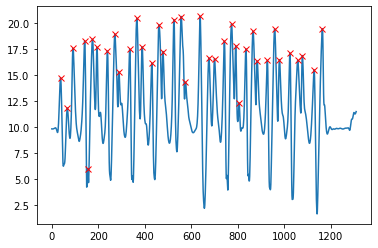

ACC Magn Trial with gait cycle


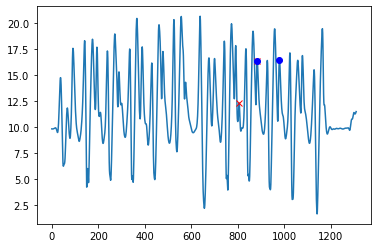

tria2gcycles for i:344
ACC Magn Trial with peaks


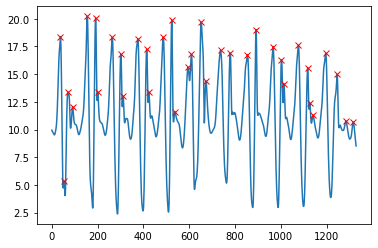

ACC Magn Trial with gait cycle


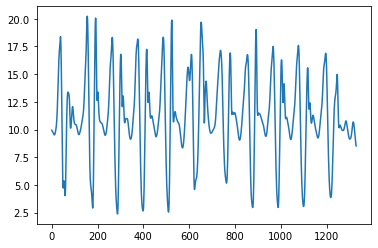

tria2gcycles for i:345
ACC Magn Trial with peaks


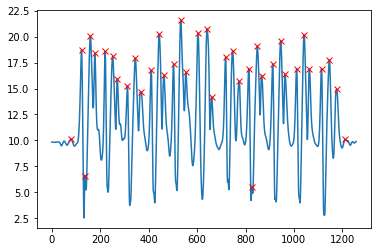

ACC Magn Trial with gait cycle


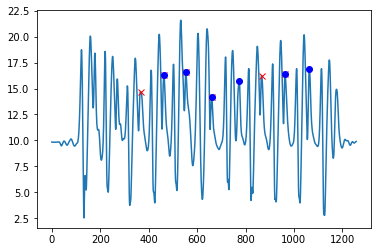

tria2gcycles for i:346
ACC Magn Trial with peaks


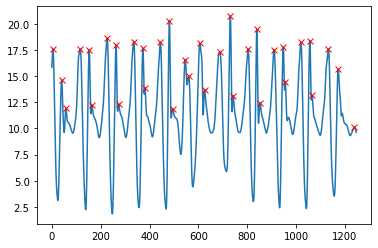

ACC Magn Trial with gait cycle


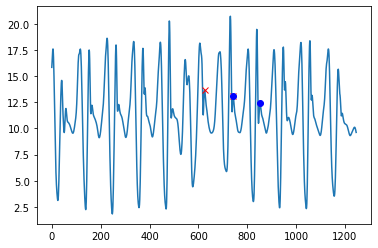

tria2gcycles for i:347
ACC Magn Trial with peaks


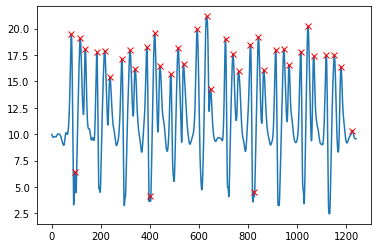

ACC Magn Trial with gait cycle


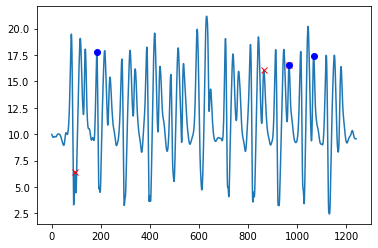

tria2gcycles for i:348
ACC Magn Trial with peaks


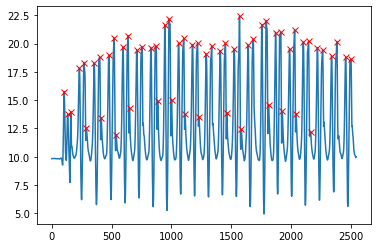

ACC Magn Trial with gait cycle


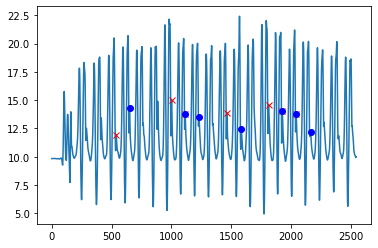

tria2gcycles for i:349
ACC Magn Trial with peaks


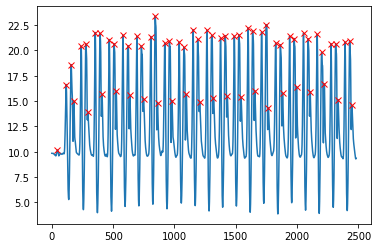

ACC Magn Trial with gait cycle


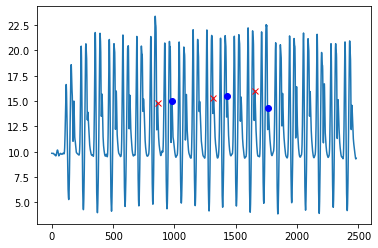

tria2gcycles for i:350
ACC Magn Trial with peaks


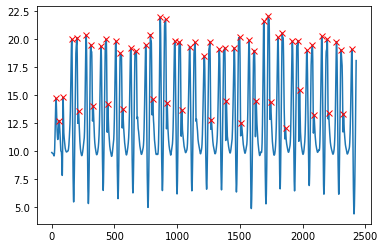

ACC Magn Trial with gait cycle


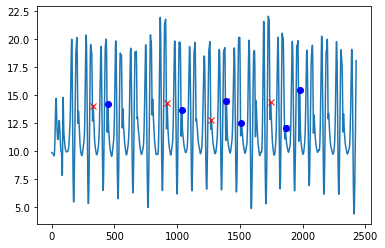

tria2gcycles for i:351
ACC Magn Trial with peaks


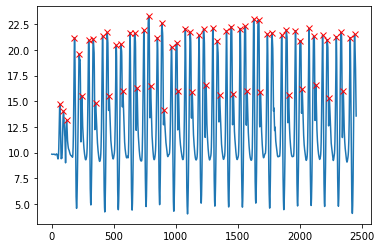

ACC Magn Trial with gait cycle


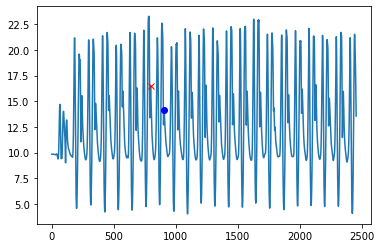

tria2gcycles for i:352
ACC Magn Trial with peaks


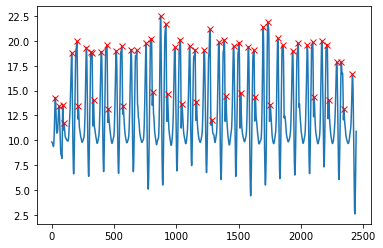

ACC Magn Trial with gait cycle


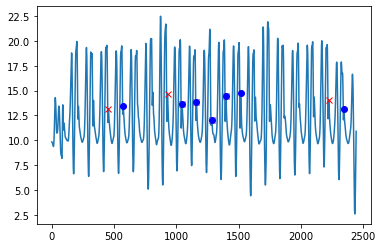

tria2gcycles for i:353
ACC Magn Trial with peaks


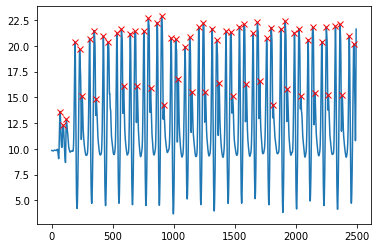

ACC Magn Trial with gait cycle


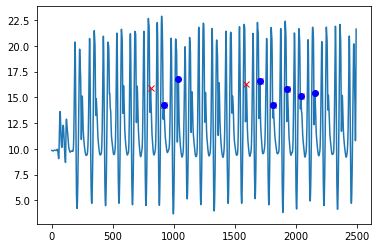

tria2gcycles for i:354
ACC Magn Trial with peaks


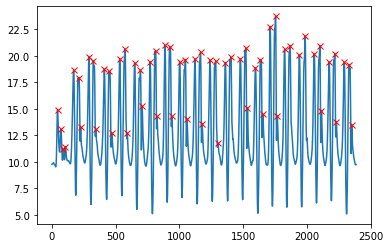

ACC Magn Trial with gait cycle


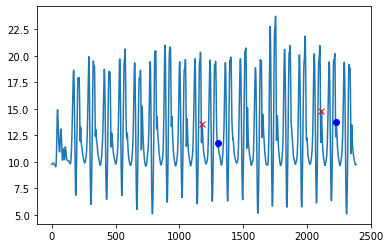

tria2gcycles for i:355
ACC Magn Trial with peaks


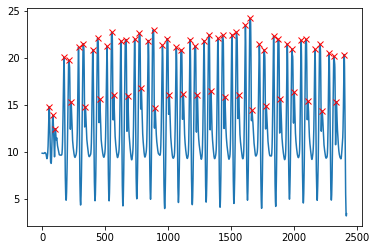

ACC Magn Trial with gait cycle


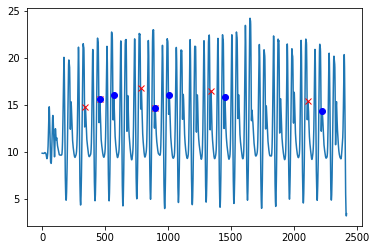

tria2gcycles for i:356
ACC Magn Trial with peaks


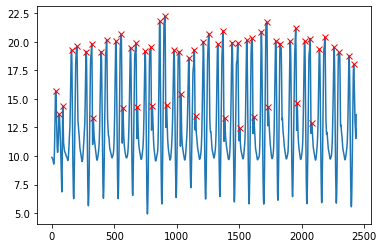

ACC Magn Trial with gait cycle


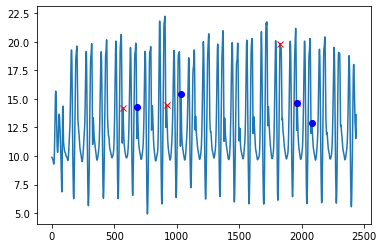

tria2gcycles for i:357
ACC Magn Trial with peaks


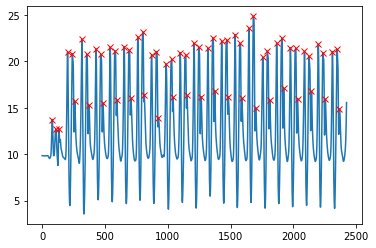

ACC Magn Trial with gait cycle


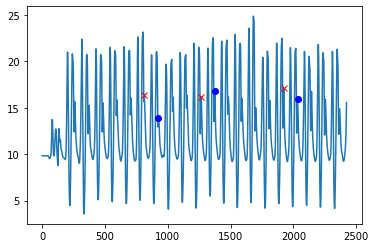

tria2gcycles for i:358
ACC Magn Trial with peaks


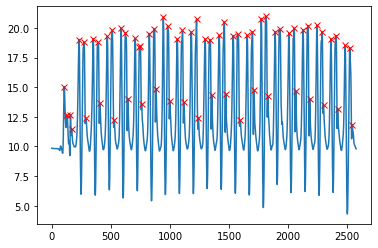

ACC Magn Trial with gait cycle


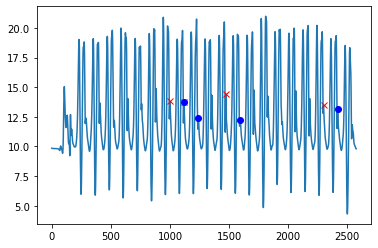

tria2gcycles for i:359
ACC Magn Trial with peaks


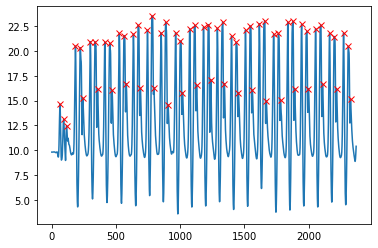

ACC Magn Trial with gait cycle


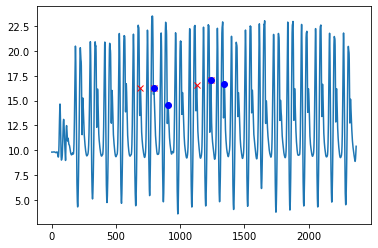

tria2gcycles for i:360
ACC Magn Trial with peaks


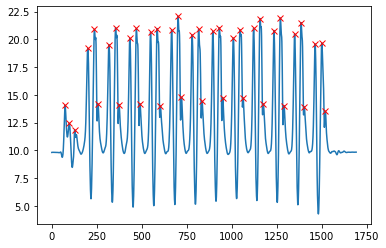

ACC Magn Trial with gait cycle


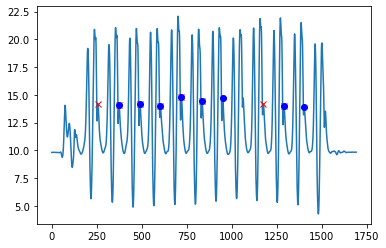

tria2gcycles for i:361
ACC Magn Trial with peaks


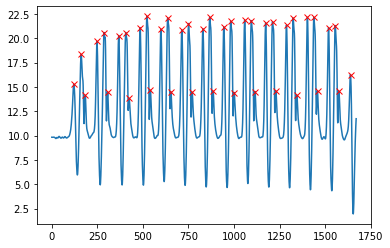

ACC Magn Trial with gait cycle


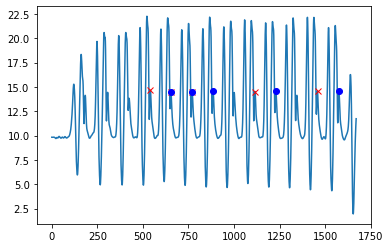

tria2gcycles for i:362
ACC Magn Trial with peaks


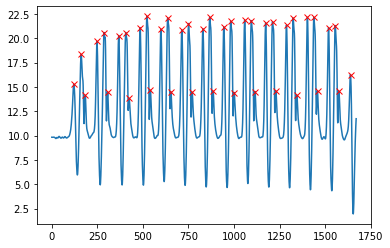

ACC Magn Trial with gait cycle


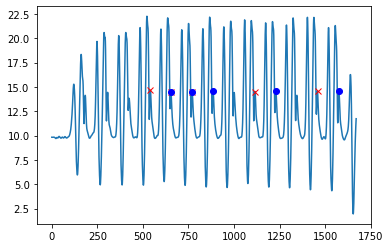

tria2gcycles for i:363
ACC Magn Trial with peaks


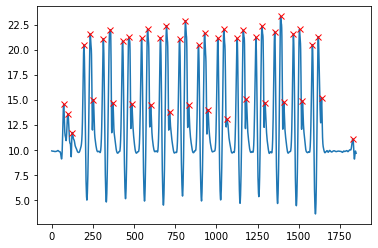

ACC Magn Trial with gait cycle


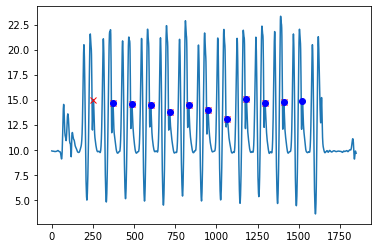

tria2gcycles for i:364
ACC Magn Trial with peaks


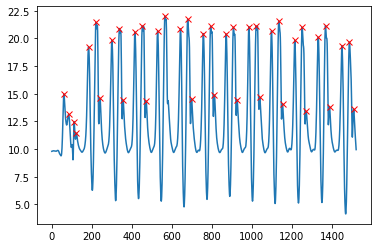

ACC Magn Trial with gait cycle


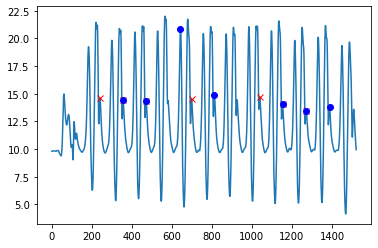

tria2gcycles for i:365
ACC Magn Trial with peaks


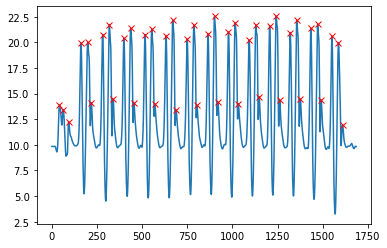

ACC Magn Trial with gait cycle


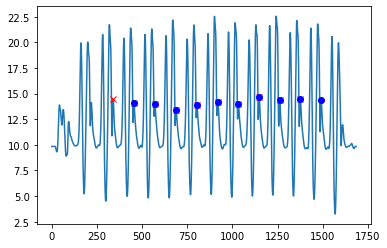

tria2gcycles for i:366
ACC Magn Trial with peaks


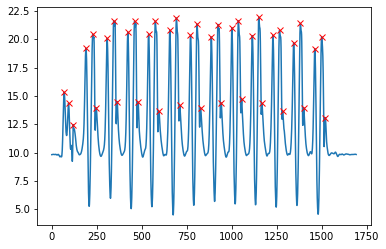

ACC Magn Trial with gait cycle


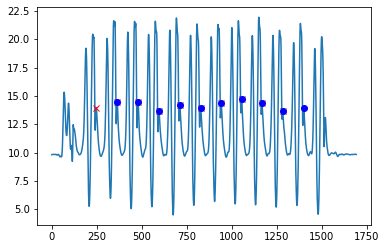

tria2gcycles for i:367
ACC Magn Trial with peaks


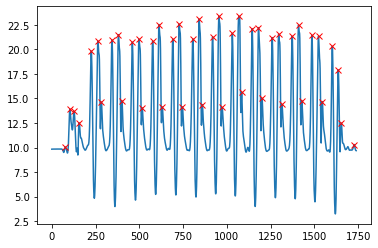

ACC Magn Trial with gait cycle


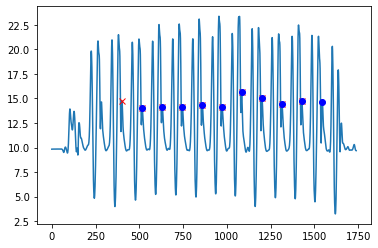

tria2gcycles for i:368
ACC Magn Trial with peaks


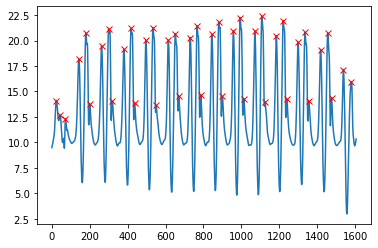

ACC Magn Trial with gait cycle


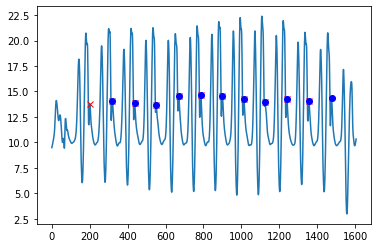

tria2gcycles for i:369
ACC Magn Trial with peaks


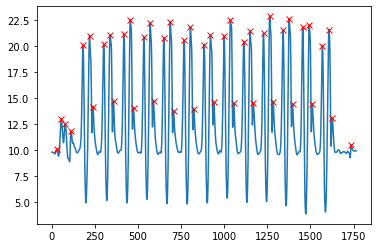

ACC Magn Trial with gait cycle


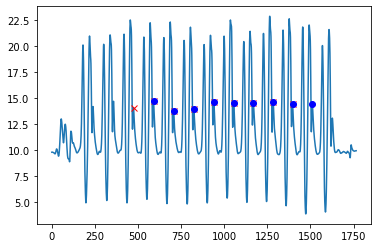

tria2gcycles for i:370
ACC Magn Trial with peaks


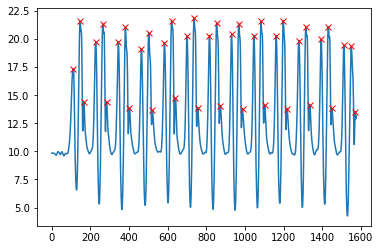

ACC Magn Trial with gait cycle


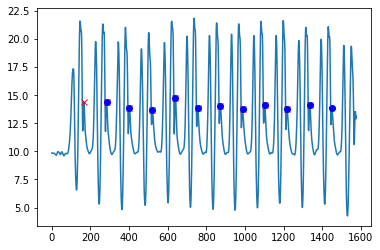

tria2gcycles for i:371
ACC Magn Trial with peaks


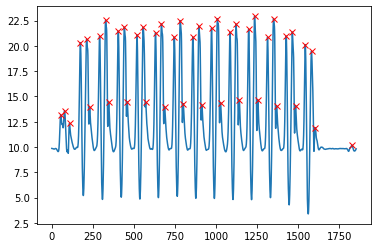

ACC Magn Trial with gait cycle


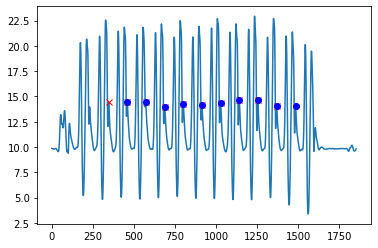

tria2gcycles for i:372
ACC Magn Trial with peaks


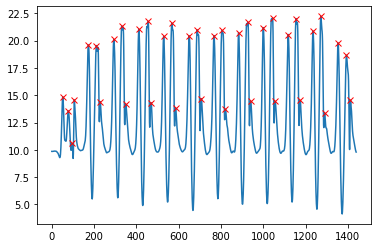

ACC Magn Trial with gait cycle


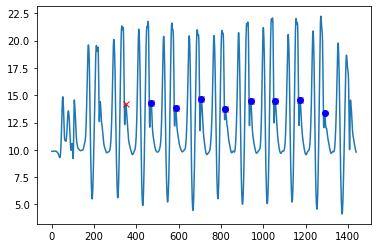

tria2gcycles for i:373
ACC Magn Trial with peaks


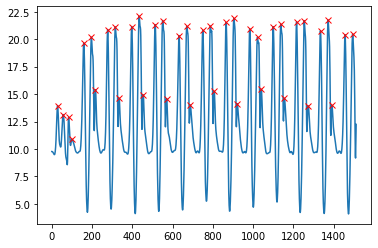

ACC Magn Trial with gait cycle


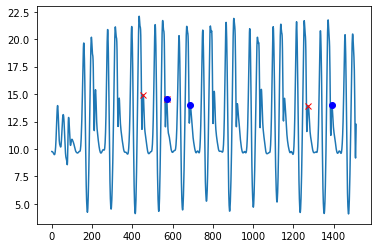

tria2gcycles for i:374
ACC Magn Trial with peaks


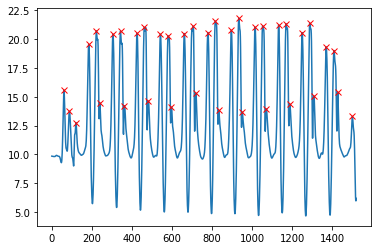

ACC Magn Trial with gait cycle


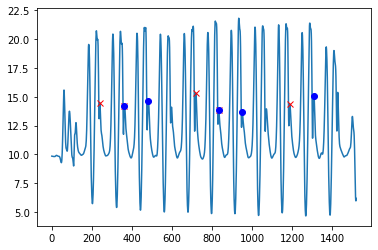

tria2gcycles for i:375
ACC Magn Trial with peaks


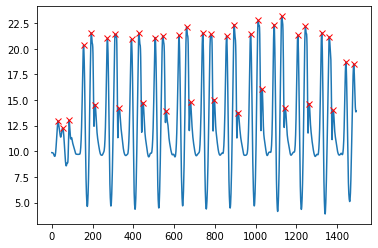

ACC Magn Trial with gait cycle


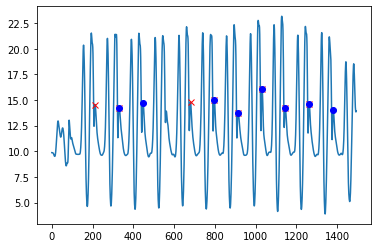

tria2gcycles for i:376
ACC Magn Trial with peaks


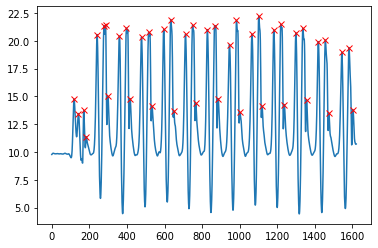

ACC Magn Trial with gait cycle


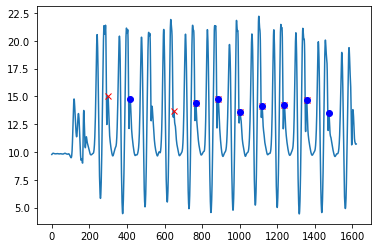

tria2gcycles for i:377
ACC Magn Trial with peaks


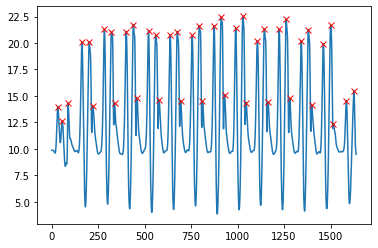

ACC Magn Trial with gait cycle


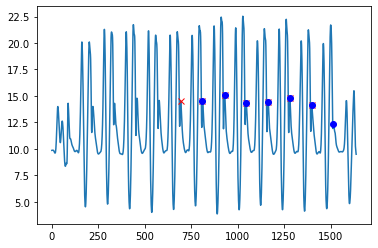

tria2gcycles for i:378
ACC Magn Trial with peaks


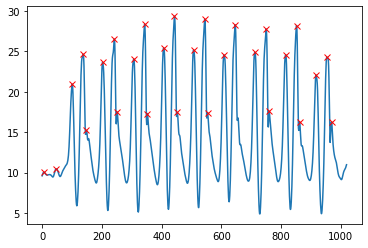

ACC Magn Trial with gait cycle


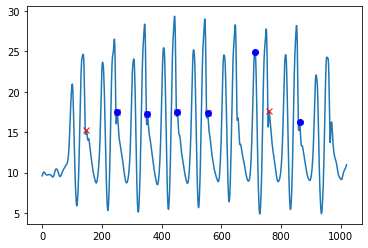

tria2gcycles for i:379
ACC Magn Trial with peaks


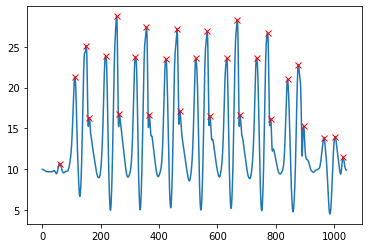

ACC Magn Trial with gait cycle


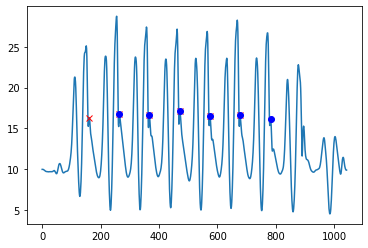

tria2gcycles for i:380
ACC Magn Trial with peaks


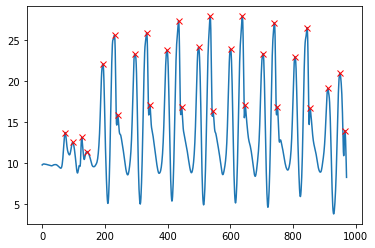

ACC Magn Trial with gait cycle


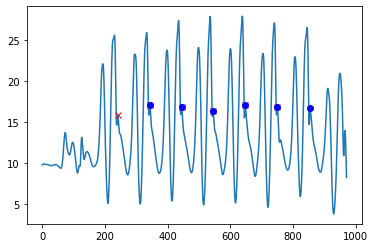

tria2gcycles for i:381
ACC Magn Trial with peaks


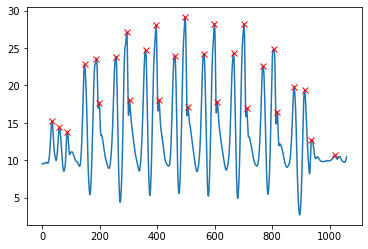

ACC Magn Trial with gait cycle


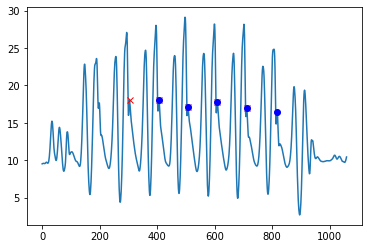

tria2gcycles for i:382
ACC Magn Trial with peaks


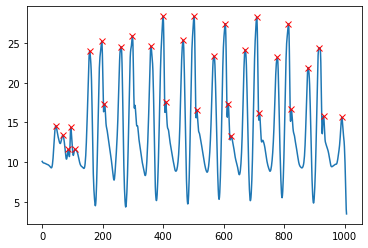

ACC Magn Trial with gait cycle


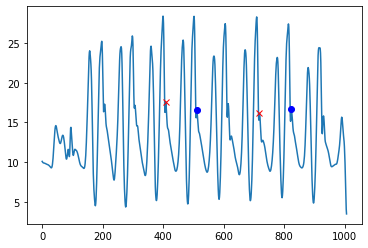

tria2gcycles for i:383
ACC Magn Trial with peaks


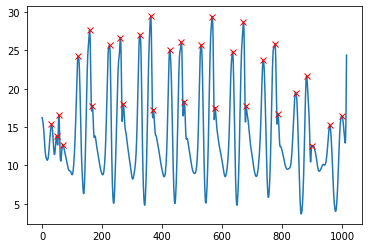

ACC Magn Trial with gait cycle


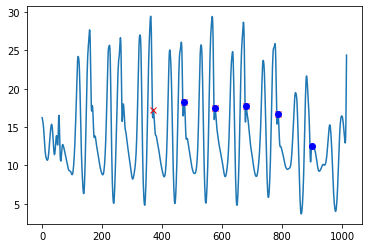

tria2gcycles for i:384
ACC Magn Trial with peaks


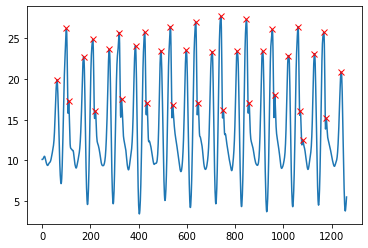

ACC Magn Trial with gait cycle


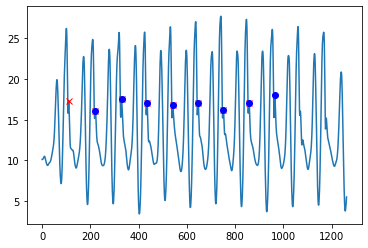

tria2gcycles for i:385
ACC Magn Trial with peaks


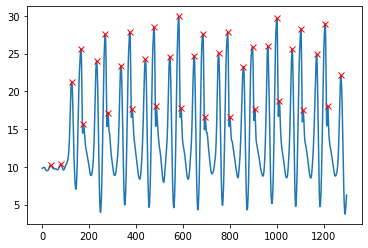

ACC Magn Trial with gait cycle


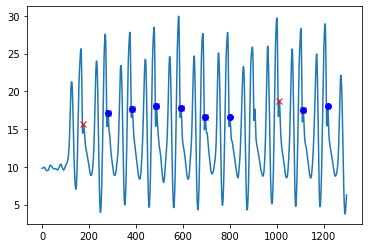

tria2gcycles for i:386
ACC Magn Trial with peaks


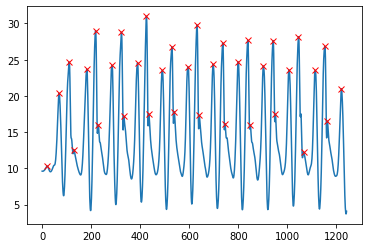

ACC Magn Trial with gait cycle


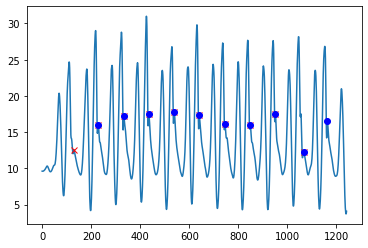

tria2gcycles for i:387
ACC Magn Trial with peaks


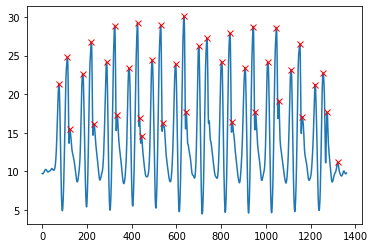

ACC Magn Trial with gait cycle


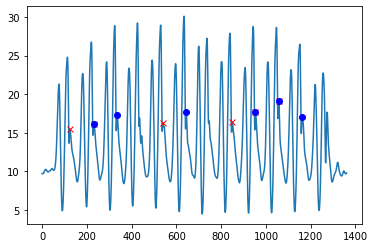

tria2gcycles for i:388
ACC Magn Trial with peaks


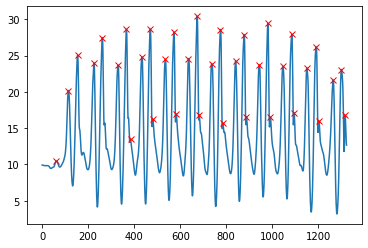

ACC Magn Trial with gait cycle


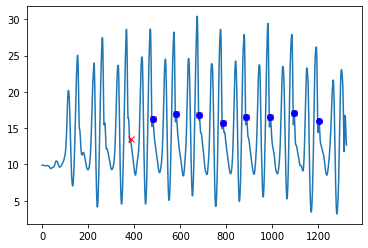

tria2gcycles for i:389
ACC Magn Trial with peaks


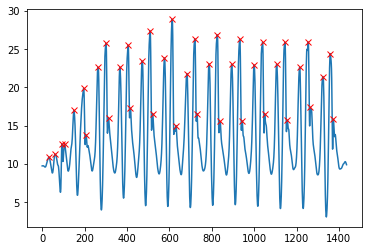

ACC Magn Trial with gait cycle


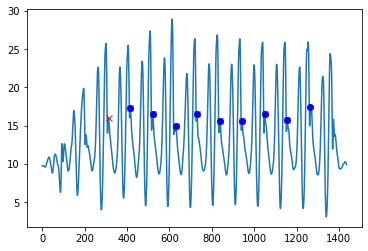

tria2gcycles for i:390
ACC Magn Trial with peaks


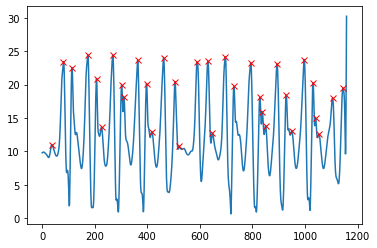

ACC Magn Trial with gait cycle


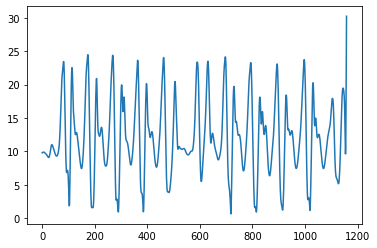

tria2gcycles for i:391
ACC Magn Trial with peaks


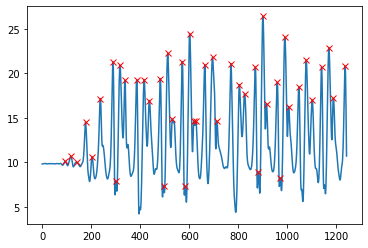

ACC Magn Trial with gait cycle


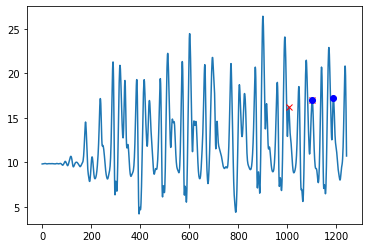

tria2gcycles for i:392
ACC Magn Trial with peaks


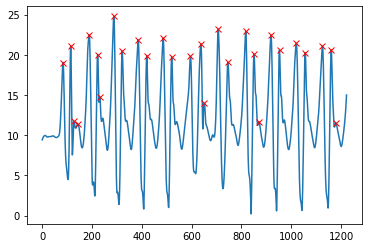

ACC Magn Trial with gait cycle


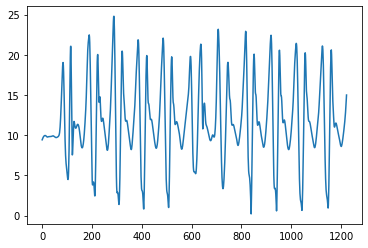

tria2gcycles for i:393
ACC Magn Trial with peaks


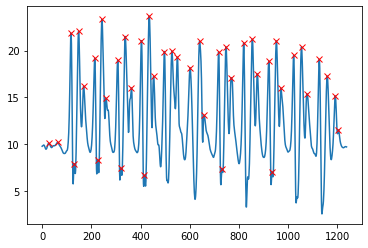

ACC Magn Trial with gait cycle


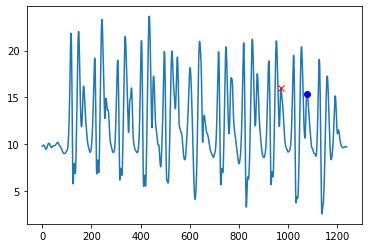

tria2gcycles for i:394
ACC Magn Trial with peaks


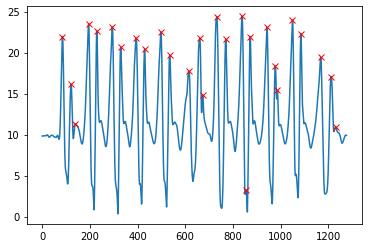

ACC Magn Trial with gait cycle


KeyboardInterrupt: 

In [265]:
mapped_data = list(map(lambda x: trial2gcycles(x[1],viz=True,i=x[0]),enumerate(X)))

In [168]:
def join(ar1,ar2):
    arr = ar1
    
    for e in ar2:
        arr.append(e)
    
    return arr

In [266]:
norm_data = functools.reduce(lambda x,y: join(x,y), list(map(trial2gcycles,X)))

In [267]:
len(norm_data)

10980

In [268]:
norm_data[0][1].shape

(101, 5, 6)